In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%matplotlib notebook
from torchsummary import summary
import util
import cnn_face_detection
import db_vae
import os
import stats_util
import torch

# The random seed to use.
random_seed = 10
util.set_seeds(random_seed)

# <h1><center>Bias in Face Detection? Yes, then how to deal with it?</center></h1>

In this Notebook we aim to reproduce an extend the ideas presented in the paper [Uncovering and Mitigating Algorithmic Bias through Learned Latent Structure](https://lmrt.mit.edu/sites/default/files/AIES-19_paper_220.pdf).

For reproduction, we mainly follow an implementation that was provided in an [course](https://github.com/aamini/introtodeeplearning) that seems to be closely affiliated with the authors, as both are published from MIT (Massachusetts Institute of Technology). However, the code was removed from their Github on 25.01.2020, so we can't link to the source anymore.  Extensions focus mainly on the reevaluation of the findings based on a bigger and especially for the topic of bias in face detection created dataset called [FairFace](https://github.com/joojs/fairface).

Roughly the Notebook follows this order. We start by looking at the data used in the project. Then evaluate if there is bias in classic face detection systems. Followed by looking into the proposed method for reducing this probable bias. Lastly, we will discuss our findings and results on data captured in multiple runs of the presented experiments

**Note:** To allow the run of evaluations without the heavy computational training there is a cell in each subsection that can be executed. However, feel free to experiment with the training to get the most out of the notebook.

# 1. All about data!

Our experiments are based on five main sources, namely
[CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html),
[FairFace](https://github.com/joojs/fairface),
[Pilot Parliaments Benchmark (PPB)](https://www.media.mit.edu/projects/gender-shades/faq/#faq-why-did-you-create-the-pilot-parliaments-benchmark-ppb-given-that-other-datasets-of-faces-already-exist-and-are-widely-used), [ImageNet](http://www.image-net.org/),
and [OpenImages](https://storage.googleapis.com/openimages/web/index.html). They are used to create the three different datasets used throughout this notebook, called **Mit Dataset**, **Our Unbiased Reproducible** (OUR) dataset and **Our Unbiased Reproducible-Biased** (OUR-B). Before we dive into the world of face detection, it is a good idea to get familiar with these datasets and their attributes. 

## 1.1 Mit Dataset

The original MIT paper and implementation uses faces from CelebA in combination with random counter images from ImageNet as their training data. We call this constellation **Mit Dataset** in the rest of the notebook and use the provided data in the beforementioned implementation. Let's load it and look at some examples.   

In [3]:
path_to_mit_training_data, path_to_ppb_test_data = util.check_for_mit_dataset()

# Instantiate a TrainingDatasetLoader using the downloaded dataset
mit_train_loader = util.MitTrainingDatasetLoader(path_to_mit_training_data)

# Instantiate a TestDatasetLoader using the downloaded dataset
ppb_test_loader = util.PPBFaceEvaluator(path_to_ppb_test_data)  

Checking for training dataset...
    Found offline.

Checking for PPB test data_set...
    Found offline.

 All done!

Opening MIT_dataset/train_face.h5
    Loading data into memory...
    Done
Opening MIT_dataset/test_face.tar
    Loading data into memory...
    Done


When you look at the face examples generated by the next cell, you can already get a feeling for bias in the dataset, as it seems to show mainly young and white people. We investigate this a bit closer shortly. 

Furthermore, you might spot faces in the counterexamples. This is most likely due to the filtering process used for creating the counterexamples. However, we do not have specific details on this process.

Feel free to rerun the cell below to get more samples and a better feeling for the data.

<IPython.core.display.Javascript object>


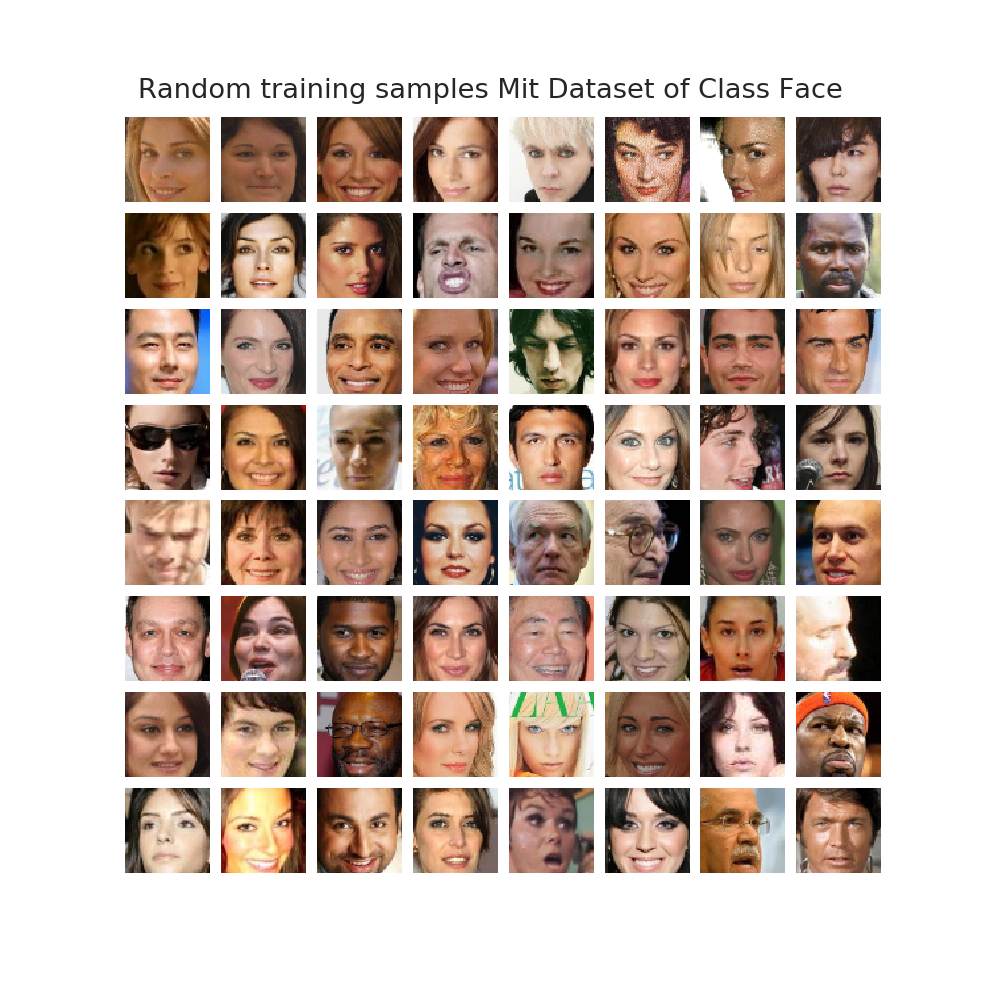

<IPython.core.display.Javascript object>


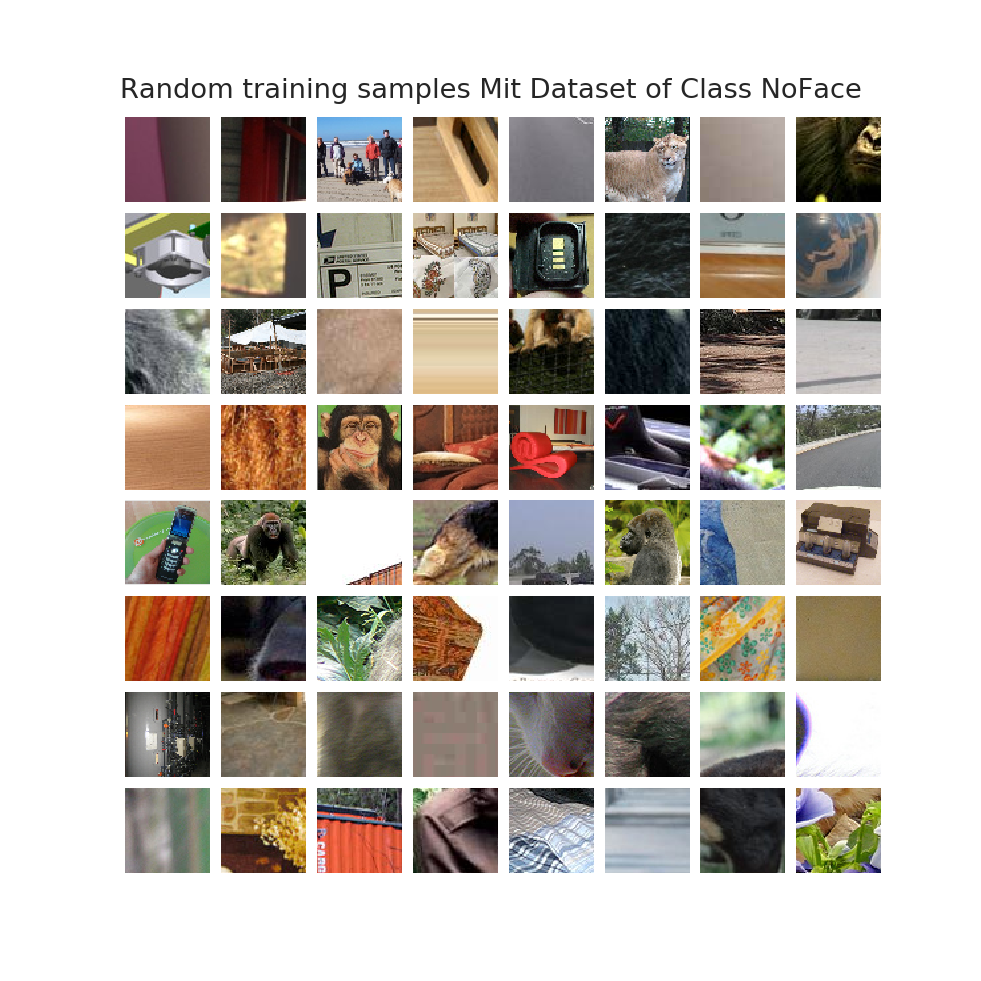

In [4]:
util.show_examples_mit_train_data(mit_train_loader)

For bias-evaluation of their model the **PPB** dataset is used, as in contrast to faces in CelebA, it contais skin-tone and gender annotations. The cell below shows some samples.

<IPython.core.display.Javascript object>


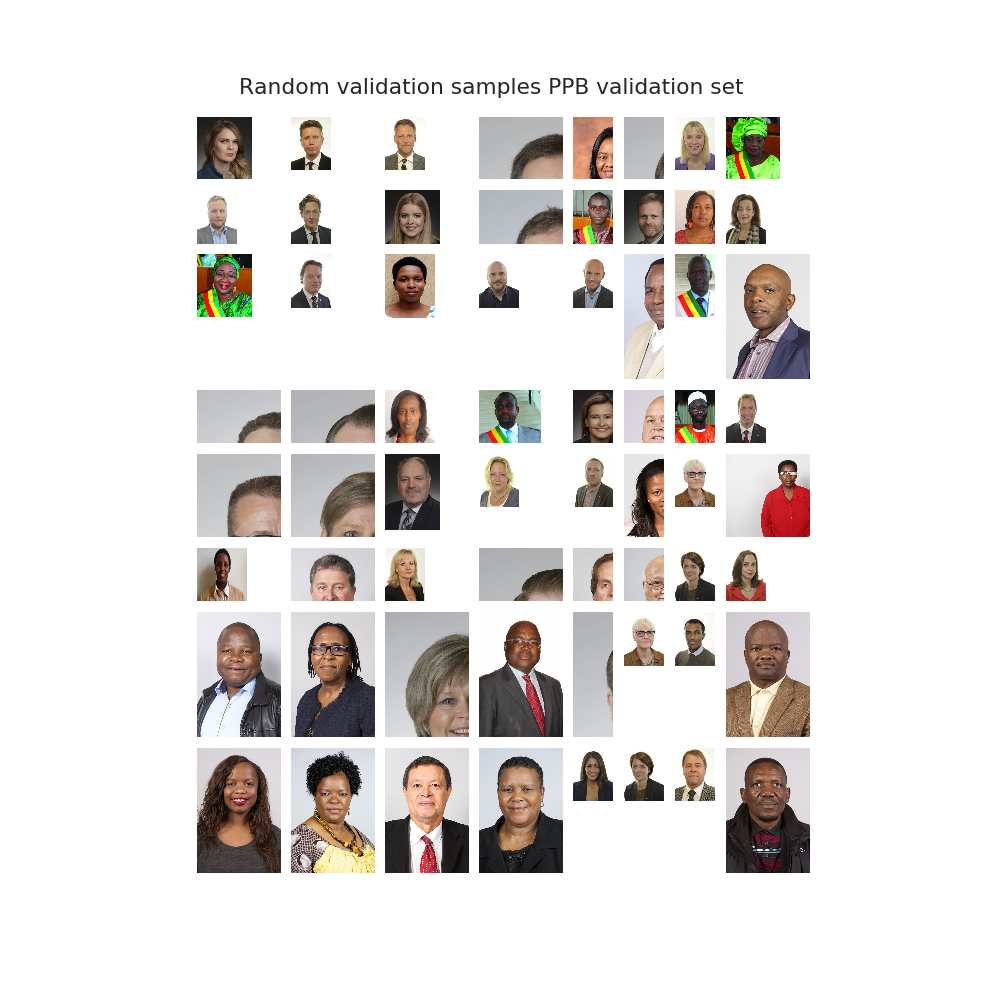

In [5]:
util.show_examples_mit_test_data()

We plot the samples using their original aspect ratio on purpose. This illustrates a big difference between the bias-evaluation and training data used in the MIT implementation, namely the difference in resolution. The authors, the affiliated implementation and we solve this problem by using a sliding window approach. That means crop-squares of different sizes are slid over the image to create a batch of smaller square sub-images, which can then be scaled to the input size of the network without altering the image content or aspect ration. If any of those sub-images detects a face, the whole image is said to belong to the Face class. The sliding of widows is the same idea as the one of filters in CNNs. 

In the affiliated MIT implementation and our tests, we use five squares, which sizes are evenly spaced between the half and full image width. Crops are created by sliding the squares in steps of 0.2 * image width/height.

While the sliding window is a common practice in face detection, it is important to note that its application is a massive change in the pipeline. We and the MIT provided implementation do only evaluate the performance of face recognition on the face class. This means that depending on the settings of the sliding approach, more or less and smaller or larger sub-images are used during the classification of the whole image. It makes intuitive sense that these changes can have a significant impact on the performance of the model, e.g. better performance for lower stride as more sub-images to classify on. A proper experiment would test face and no-face images using the sliding window approach to see the impact on false positives. We try to address the issue by not using the sliding window approach in OUR dataset.

## 1.2 OUR Dataset

We provide a second dataset, which we call **Our Unbiased Reproducible dataset**, short OUR dataset. It consists equally of facial images from the [FairFace](https://github.com/joojs/fairface) dataset and counter images extracted from OpenImages (very similar to ImageNet, as it was not accessible). This collection of approximately 195K images is then fairly split between training(\~173K) and validation set (\~21K). The latter is also used for bias-evaluation, and as it is already preprocessed like the training data, there is no need for using a sliding window approach as described in the PPB subsection above. Let's take a look at samples and discuss its value as an extension.

Checking for OUR dataset...
    Found offline.


<IPython.core.display.Javascript object>


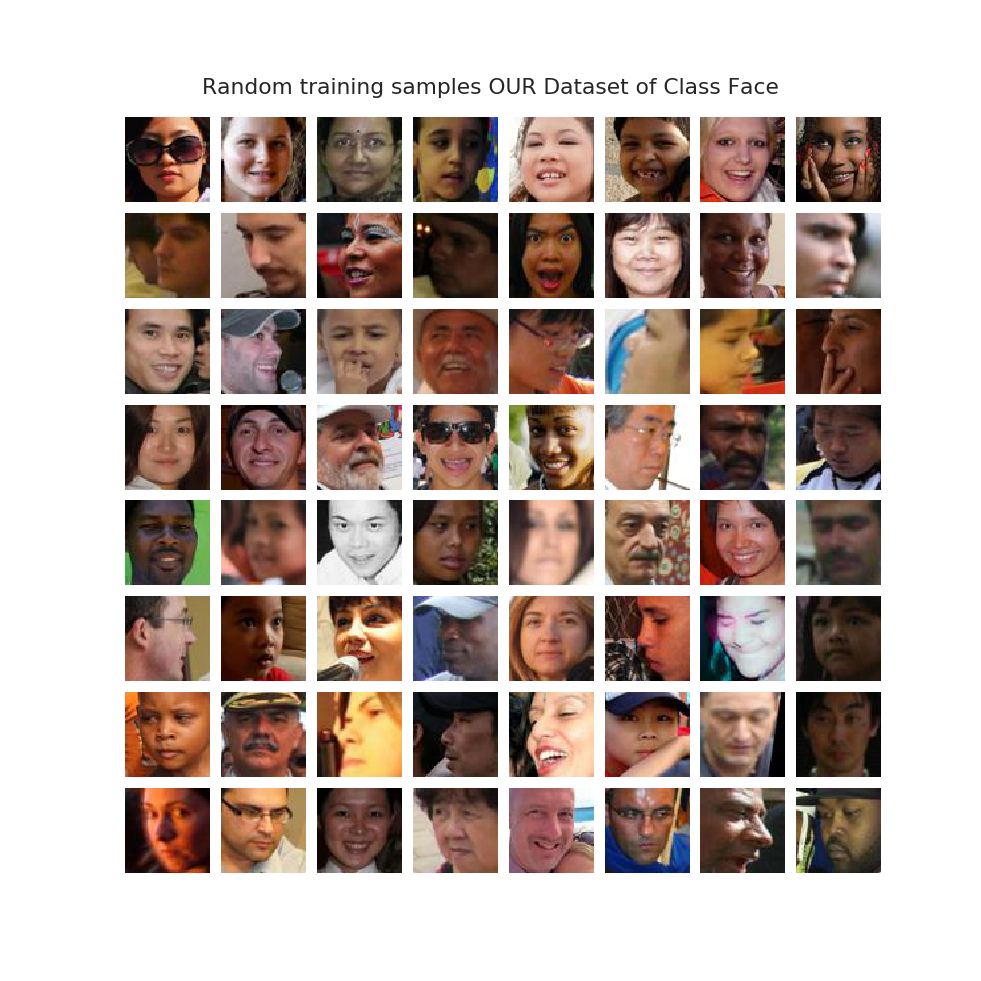

<IPython.core.display.Javascript object>


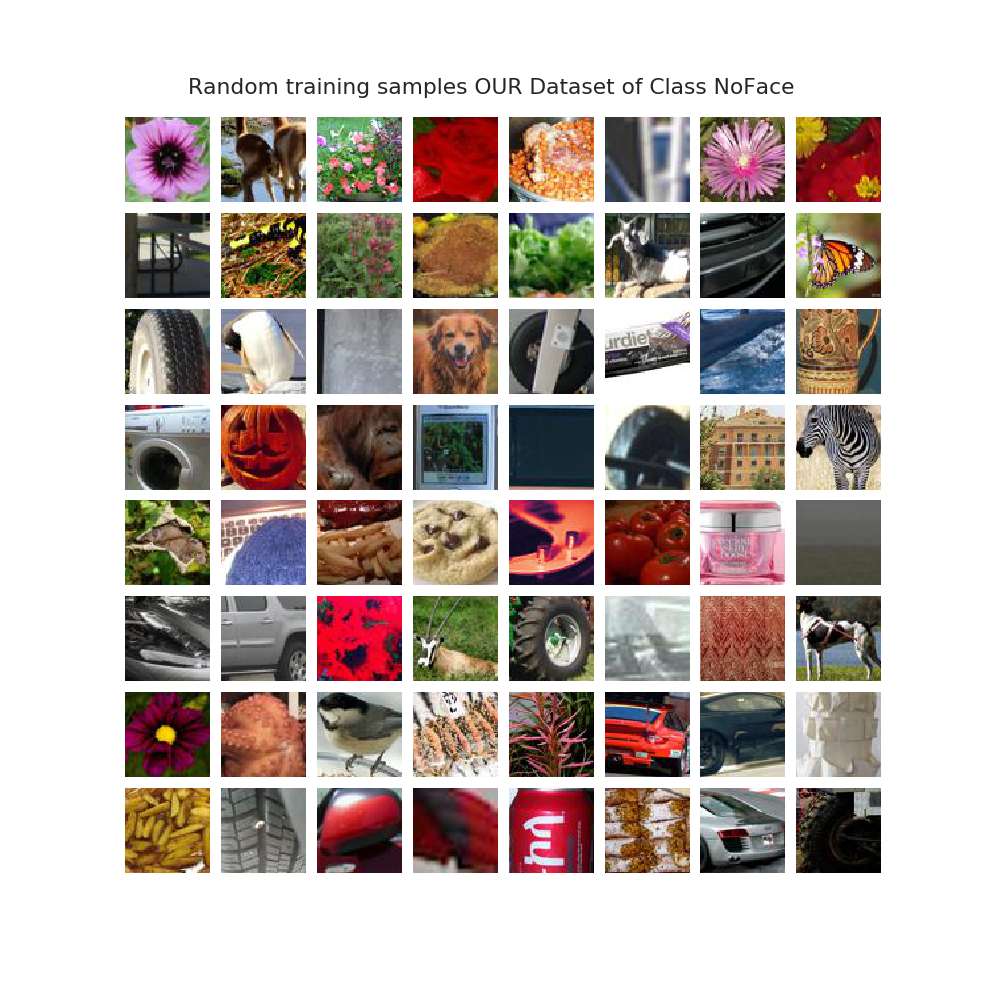

Opening our_dataset_label_train.csv
    Loading necessary info into memory...
    Done
Opening our_dataset_label_val.csv
    Loading necessary info into memory...
    Done


In [6]:
path_to_our_dataset = util.check_for_our_dataset()

data_set_fields = {"image_filename": str, "age":str, "gender":str, "race":str, "image_class":str}
# Instantiate a TrainingDatasetLoader using the downloaded dataset
our_train_loader = util.OURDatasetLoader(os.path.join(path_to_our_dataset,"our_dataset_label_train.csv"),
                                         path_to_our_dataset, dtype=data_set_fields)

# Instantiate a ValidationDatasetLoader using the downloaded dataset
our_val_loader = util.OURDatasetLoader(os.path.join(path_to_our_dataset,"our_dataset_label_val.csv"),path_to_our_dataset)

First, we note that in comparison to the faces in Mit Dataset, faces in OUR (source FairFace) are more balanced in terms of age and race than in Mit Dataset (source CelebA). Thus, it can be used in two ways, as a **unbiased** training dataset to investigate/proof the impact of data distribution. And as a sanity check against results of the MIT experiments, when used filtered to simulate the Mit dataset distribution.  

Secondly, counterexamples in Mit Dataset rarely, but frequently enough, contain faces. This is probably due to the extraction process from ImageNet. However, there is no information provided on this part. OUR uses the annotations of OpenImages to reduce face related objects in the counterexamples to a minimum making the dataset more accurate, transparent and **reproducible**, while keeping it close to the original one used. For maximum transparency and **reproducibility**, the user is provided with a notebook with the full pipeline to create this dataset in the folder `create_our_dataset`. We urge the user to take a look at saved outputs in the notebook to get familiar with the process.

Lastly, OUR contains faces of larger variety and in a way more natural setting (e.g. different angles, backgrounds, ages, more diverse races) and provides a substantially larger bias-validation set that contains ~11K faces (v.s. ~1K in PPB) with more detailed annotations used in bias research. In detail, faces in our data set are labelled by gender, age, and race. Gender is classified in `female (F)` and `male (M)`, age is classified in nine ranges:

`0-2 ; 3-9 ; 10-19 ; 20-29 ; 30-39 ; 40-49 ; 50-59 ; 60-69 ; more than 70`,

 and race is classified in seven classes

`White (W); Black (B); Latino (LH); East Asian (EA); SE Asian (SA); Indian (I); Middle Eastern (ME)`. 

These three key-points make OUR an important and interesting extension to the MIT setting.

## 1.3 OUR Dataset: simulating Mit Dataset

As described in the first key-point motivating OUR dataset, it can also be used to simulate the dataset distribution of the MIT dataset, while providing all other benefits, like better labels and more in-class diversity. 

Thus, we create **OUR-B** dataset by filtering the training data in OUR dataset so that the race distribution over faces follows a similar distribution to the one of CelebA, which was approximated in the [FairFace paper](https://arxiv.org/pdf/1908.04913.pdf):

`White:83% ; Black:7% ; East Asian:3% ; Indian:2% ; Latino:2% ; Southeast Asian:1% ; Middle Eastern:2%`

Non face images are taken fairly across non-face classes to match the filtered amount of faces.

In [7]:
our_biased_train_loader = our_train_loader.create_biased_dataset(plot=False)

    Generating artificially biased dataset...
    Done...


## 1.4 Stats... Stats... Stats...

Finally, we have created all datasets needed for the experiments to come! But before we dive in, it is a good idea to look at some statistics in the data. This proofs some of the claims already made above and might help later to provide or eliminate possible explanations for observed behaviour.

The cell below creates a distribution plot over races in the three datasets. We can see that the Mit Dataset is clearly biased towards white people. OUR Dataset is relatively balanced over all races, and OUR-B Dataset tries to approximate the race distribution in Mit Dataset.

<IPython.core.display.Javascript object>


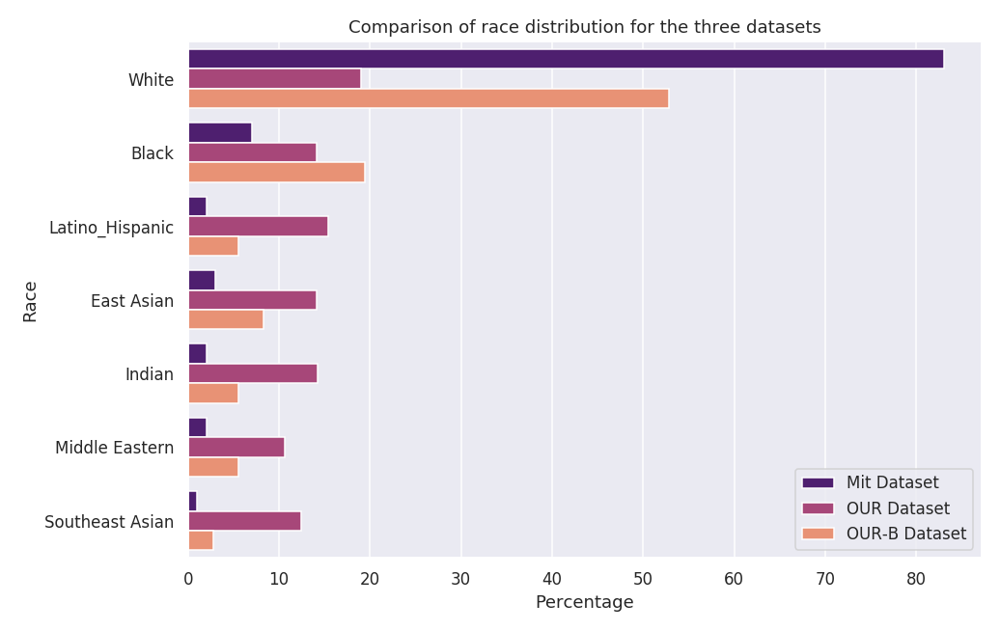

In [8]:
stats_util.compare_mit_our_race_dist(our_biased_train_loader.data, our_train_loader.data )

Besides the distribution in race, the distribution in gender is also an interesting factor. Unfortunately, we have no info on the CelebA dataset and thus the Mit Datset. However, the plots below show that the gender distributions are relatively balanced in all race subsets evaluated in PPB, OUR dataset and OUR-B dataset.

<IPython.core.display.Javascript object>


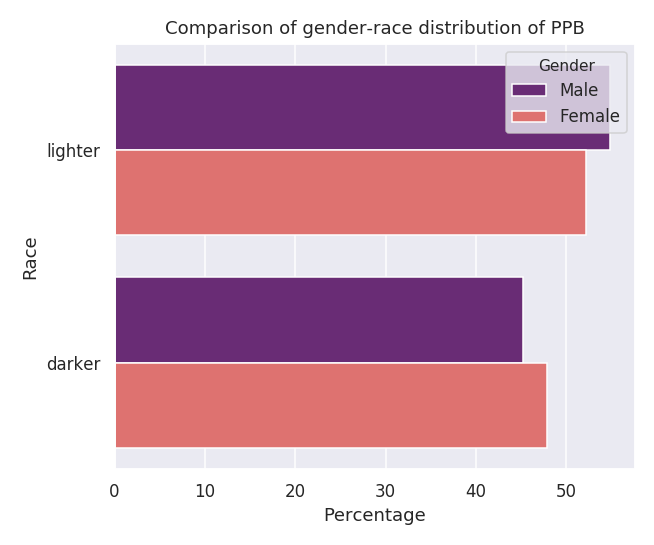

<IPython.core.display.Javascript object>


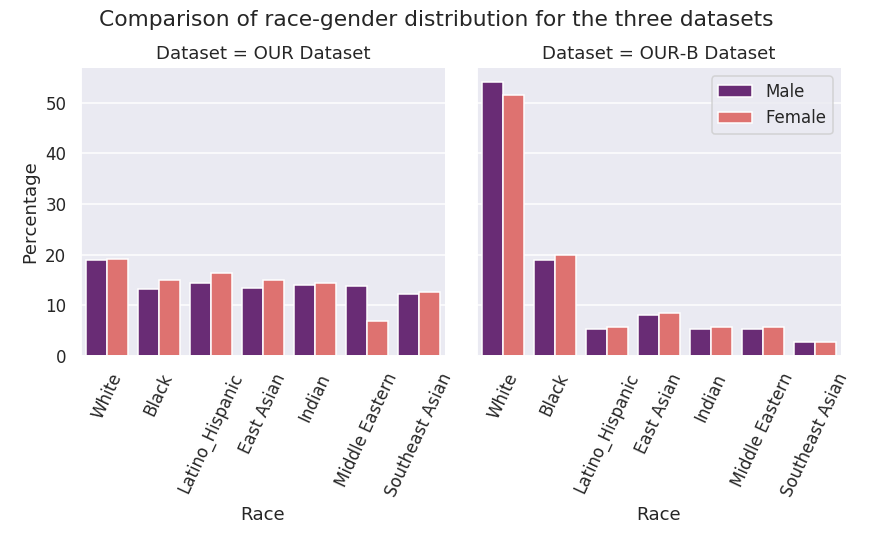

In [9]:
stats_util.compare_gender_race_dist_ppb()

stats_util.compare_gender_race_dist(our_biased_train_loader.data, our_train_loader.data )

OUR and OUR-B dataset also provides age features. As we can see in the plot below, age follows the same distribution in both dataset. However, here we see a bias towards medium aged persons. This is expected as images in these ranges are more common in sources normally used to scrape this kind of images.

<IPython.core.display.Javascript object>


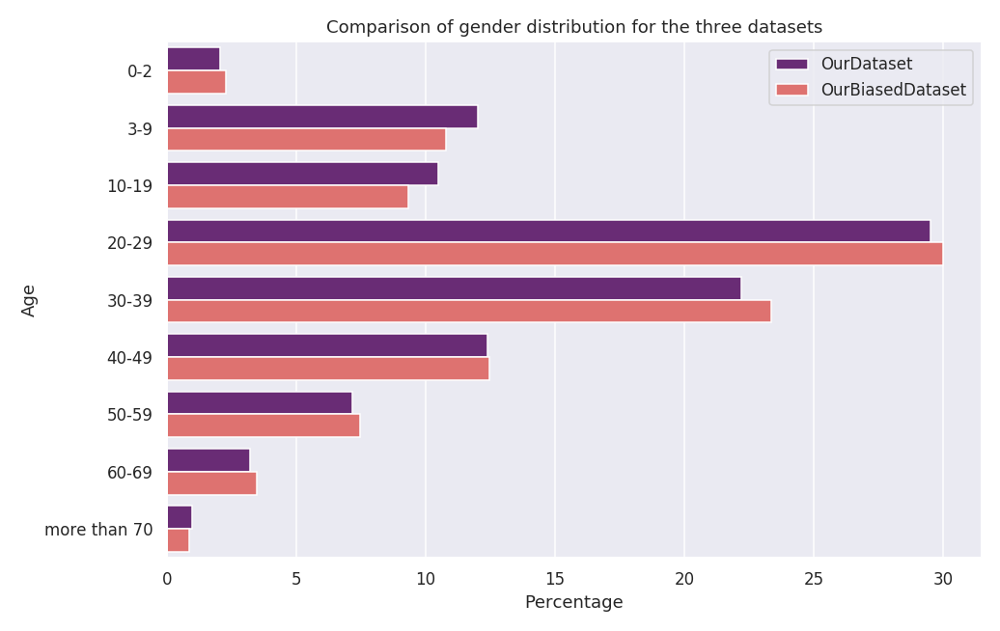

In [10]:
stats_util.compare_age_dist(our_biased_train_loader.data, our_train_loader.data )

# 2. CNN for standard facial detection 

To get a feeling for bias in face detection, let's first study the results on face detection using a standard CNN classifier setting. To make the results comparable to the later presented VAE results, we use the same architecture as in the VAE-Encoder. Furthermore, we use an architecture that is identical to the one described in the MIT paper in terms of the number of conv-layers, filter-sizes, strides and the classifier head. The number of filters is chosen as in the linked MIT implementation. 

In terms of numbers, this means we use four convolution blocks, each consisting of a convolution layer (num_filter=[12, 24, 48, 72], filer-size=5x5, stride=2, zero-padding) followed by a ReLU activation and a 2D-BatchNorm. After the last conv block, the feature maps are passed through one hidden fully-connected layer using 1000 neurons, followed by a ReLU activation and a 1D-BatchNorm. The final layer has an output size of one and uses a Sigmoid activation to represent class probability. A detailed summary of the architecture is printed when executing the cell below. The implementation can be found in `cnn_face_detection.py`.

In [11]:
# Init standard classifier to get model summary
dummy_standard_classifier = cnn_face_detection.CNN()

dummy_standard_classifier = dummy_standard_classifier.to(dummy_standard_classifier.device)
summary(dummy_standard_classifier, input_size=(3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 12, 30, 30]             912
              ReLU-2           [-1, 12, 30, 30]               0
       BatchNorm2d-3           [-1, 12, 30, 30]              24
            Conv2d-4           [-1, 24, 13, 13]           7,224
              ReLU-5           [-1, 24, 13, 13]               0
       BatchNorm2d-6           [-1, 24, 13, 13]              48
            Conv2d-7             [-1, 48, 5, 5]          28,848
              ReLU-8             [-1, 48, 5, 5]               0
       BatchNorm2d-9             [-1, 48, 5, 5]              96
           Conv2d-10             [-1, 72, 1, 1]          86,472
             ReLU-11             [-1, 72, 1, 1]               0
      BatchNorm2d-12             [-1, 72, 1, 1]             144
           Linear-13                 [-1, 1000]          73,000
             ReLU-14                 [-

Training is done for 10 epochs using Binary-Cross-Entropy loss and Adam optimizer with a learning rate of 1e-4 and wheight_decay of 1e-2 on batches of size 128. These values were found partially by a grid search and partially by experimentation.

We start by looking at results replicating the MIT setting, followed by results when training on OUR Dataset and OUR-B dataset. Bias experiments are presented for both bias-validation datasets PPB and Ours. 

## 2.1 Training on Mit Dataset

We will now train the standard classifier on the Mit Datset. As it does not include a validation set, we can only include training metrics.

<IPython.core.display.Javascript object>


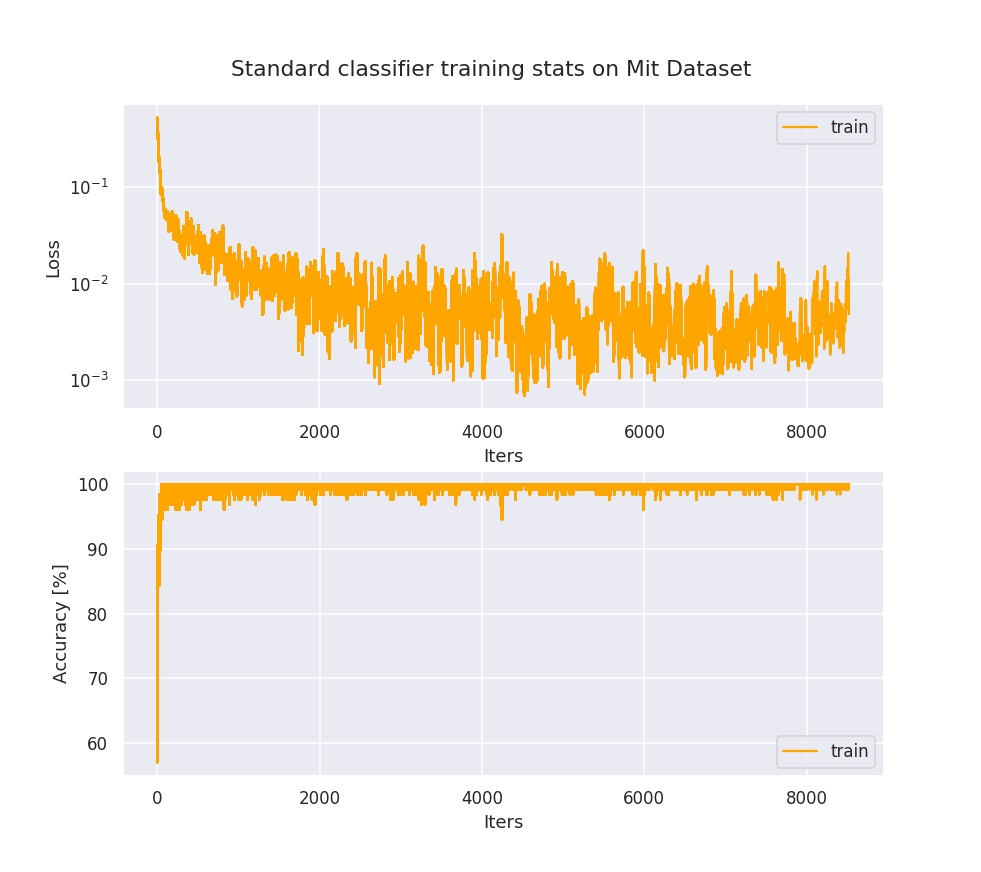

Epoch 01/10: mean acc train/val=98.57%/-- ; mean train/val loss=4.53e-02/--
Epoch 02/10: mean acc train/val=99.59%/-- ; mean train/val loss=1.27e-02/--
Epoch 03/10: mean acc train/val=99.73%/-- ; mean train/val loss=8.58e-03/--
Epoch 04/10: mean acc train/val=99.79%/-- ; mean train/val loss=6.43e-03/--
Epoch 05/10: mean acc train/val=99.79%/-- ; mean train/val loss=6.59e-03/--
Epoch 06/10: mean acc train/val=99.85%/-- ; mean train/val loss=4.96e-03/--
Epoch 07/10: mean acc train/val=99.84%/-- ; mean train/val loss=5.48e-03/--
Epoch 08/10: mean acc train/val=99.85%/-- ; mean train/val loss=5.21e-03/--
Epoch 09/10: mean acc train/val=99.86%/-- ; mean train/val loss=4.51e-03/--


/home/frederic/FACT-AI/cnn_face_detection.py:420: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  self.metric_plots['fig'].canvas.draw()


Epoch 10/10: mean acc train/val=99.90%/-- ; mean train/val loss=4.33e-03/--



In [12]:
# Init standard classifier for Mit Dataset
mit_standard_classifier = cnn_face_detection.CNN()
mit_standard_classifier = mit_standard_classifier.to(mit_standard_classifier.device)

# Train classifier
mit_standard_classifier_train_stats = mit_standard_classifier.run_training(batch_size=128, num_epochs=10,
                                                                           train_dataset=mit_train_loader,
                                                                      title='Standard classifier training stats on Mit Dataset')
# Saving the model
#util.save_model(mit_standard_classifier, "mit_standard_cnn")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Init standard classifier for Mit Dataset
mit_standard_classifier = cnn_face_detection.CNN()
mit_standard_classifier = mit_standard_classifier.to(mit_standard_classifier.device)

# Load model from file
mit_standard_classifier.load_state_dict(torch.load("mit_standard_cnn.pt", map_location=mit_standard_classifier.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of our trained standard classifier on the PPB dataset.
For the PPB data, we'll look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 0.90
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 0.86
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.77
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.80


<IPython.core.display.Javascript object>


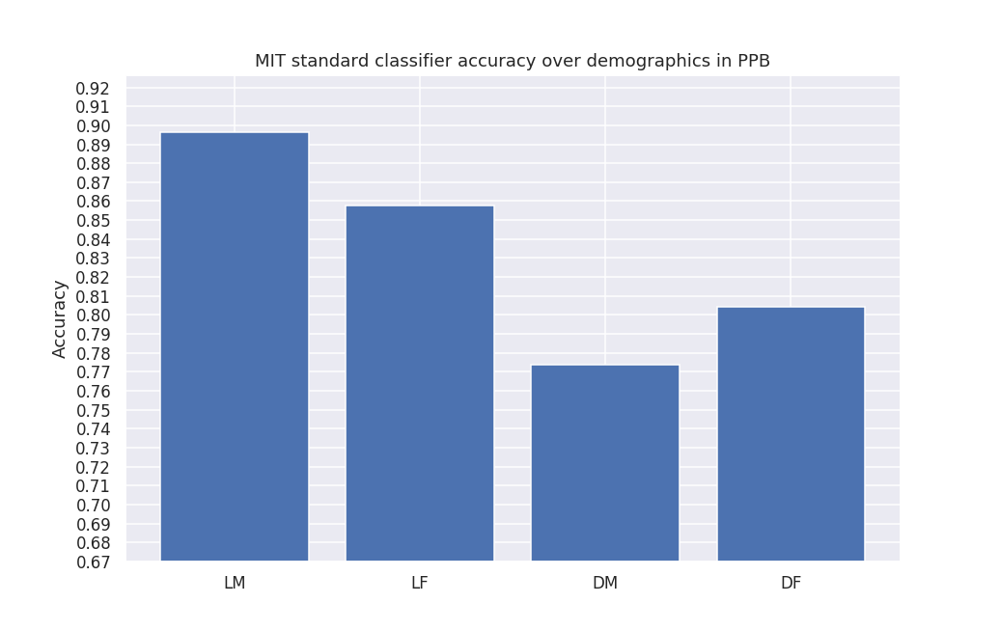

In [13]:
mit_standard_classifier_ppb_bias_stats = util.evaluate_on_ppb(model=mit_standard_classifier,
                                                              test_loader=ppb_test_loader,
                                                              title='MIT standard classifier accuracy over demographics in PPB')

The barplot above should show bias towards some demographic groups. While, given the bias in data towards White, you would expect this bias is always towards LM and/or LF, this is not actually the case. If you rerun the cell, you might see a different kind of biases in this evaluation. The most likely reasons for this is the stochastic nature of optimization leading to different local minima. 

At the end of this notebook, we show evaluations averaged over several runs. The bias looks clearer in this experiment. However, don't forget to keep the variation on the shown means in mind and remember that we did not see a consistent bias towards White people in this experiment.

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the standard CNN on the OUR Dataset. Here we will look at race, gender and age independently.

<IPython.core.display.Javascript object>


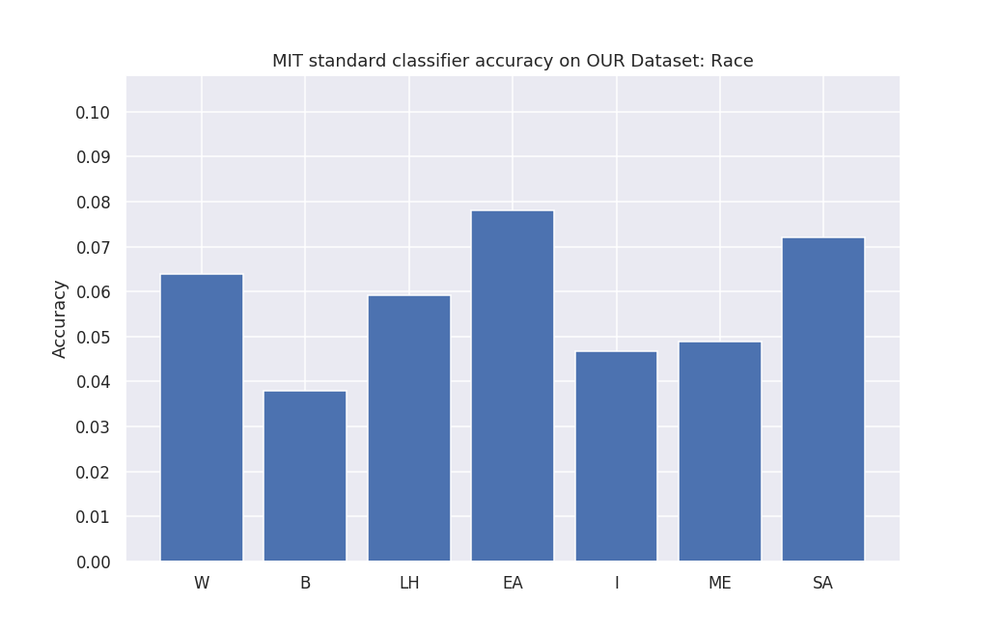

<IPython.core.display.Javascript object>


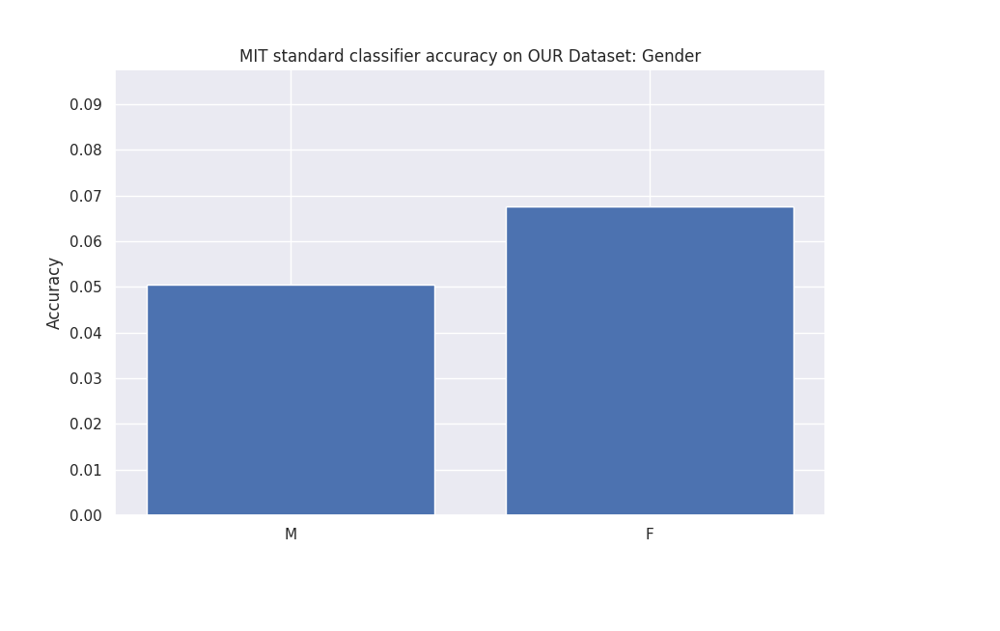

<IPython.core.display.Javascript object>


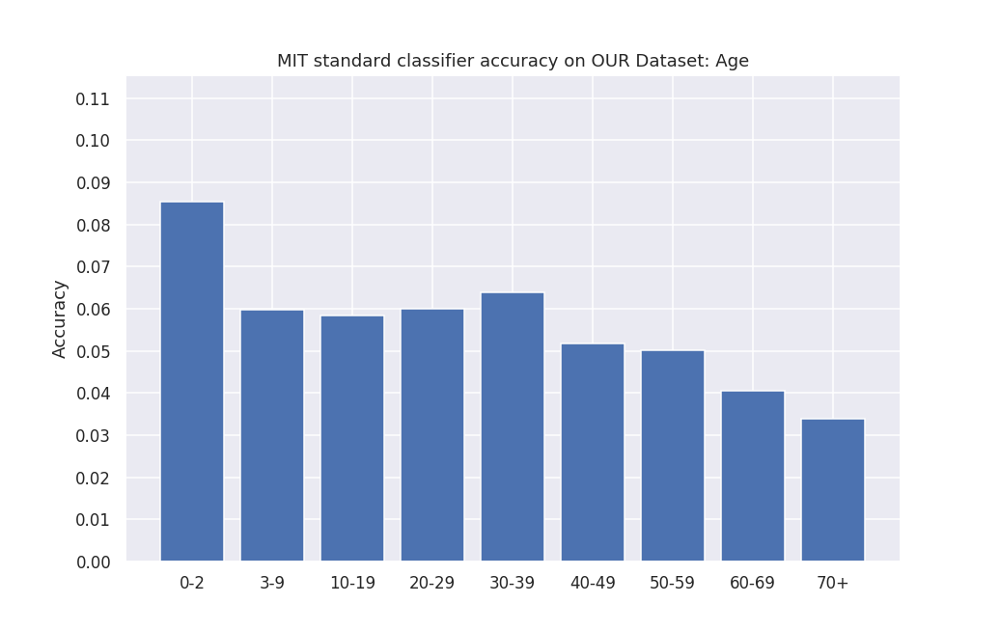

In [14]:
mit_standard_classifier_our_bias_stats = util.get_bias_stats_on_our_dataset(model=mit_standard_classifier,
                                                                            test_loader=our_val_loader,
                                                                            title='MIT standard classifier accuracy on OUR Dataset')

We can see the model does not generalize to OUR Dataset, and we can thus not give any meaningful insights on bias here. However, it indicates that the model overfits on Mit Dataset. As the PPB dataset also comes from a different source, there is a good chance that evaluation results are also affected by this change in domain.

## 2.2 Training on OUR Dataset

We will now train the standard classifier on Our Datset for ten epochs. Here we can also use the validation set of OUR Dataset for checking overfitting.

<IPython.core.display.Javascript object>


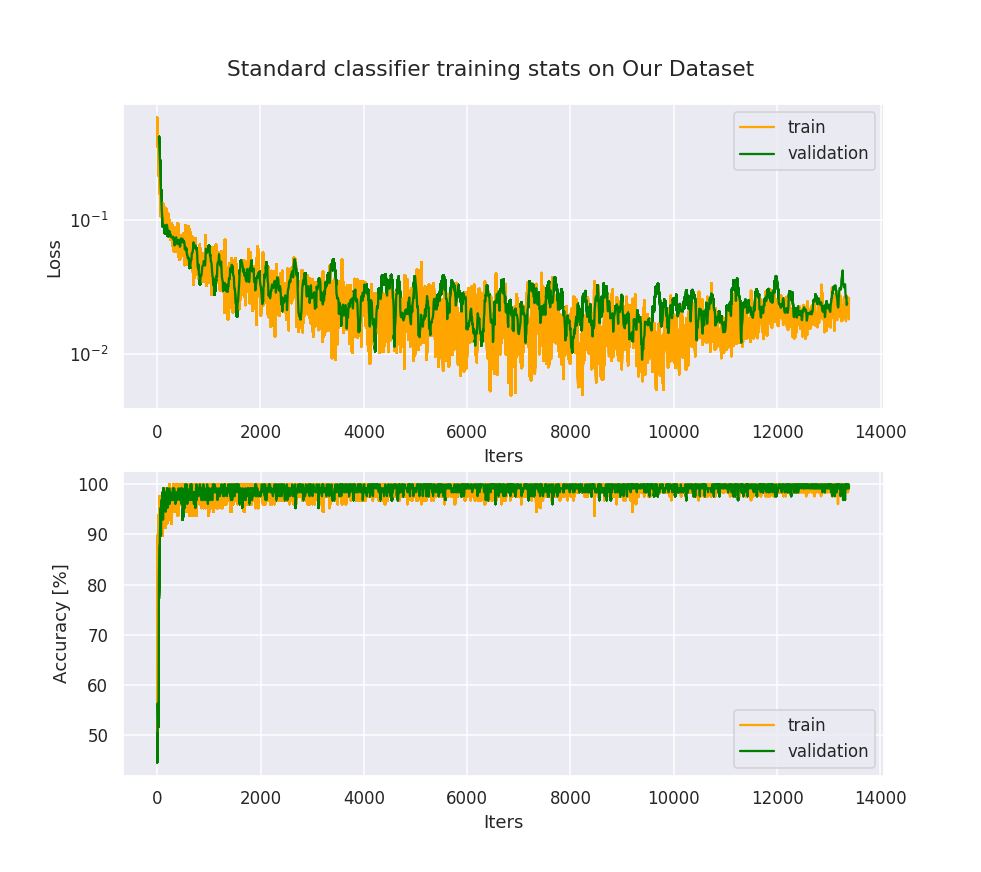

Epoch 01/10: mean acc train/val=97.32%/96.56% ; mean train/val loss=7.42e-02/8.00e-02
Epoch 02/10: mean acc train/val=98.82%/98.65% ; mean train/val loss=3.34e-02/3.54e-02
Epoch 03/10: mean acc train/val=99.15%/98.98% ; mean train/val loss=2.42e-02/2.85e-02
Epoch 04/10: mean acc train/val=99.28%/99.21% ; mean train/val loss=2.04e-02/2.39e-02
Epoch 05/10: mean acc train/val=99.38%/99.25% ; mean train/val loss=1.82e-02/2.42e-02
Epoch 06/10: mean acc train/val=99.46%/99.22% ; mean train/val loss=1.64e-02/2.24e-02
Epoch 07/10: mean acc train/val=99.54%/99.30% ; mean train/val loss=1.49e-02/2.04e-02
Epoch 08/10: mean acc train/val=99.63%/99.31% ; mean train/val loss=1.46e-02/2.19e-02
Epoch 09/10: mean acc train/val=99.68%/99.38% ; mean train/val loss=1.80e-02/2.41e-02
Epoch 10/10: mean acc train/val=99.68%/99.46% ; mean train/val loss=2.03e-02/2.47e-02



In [15]:
# Init standard classifier for Mit Dataset
our_standard_classifier = cnn_face_detection.CNN()
our_standard_classifier = our_standard_classifier.to(our_standard_classifier.device)

# Train classifier
our_standard_classifier_train_stats = our_standard_classifier.run_training(batch_size=128, num_epochs=10,
                                                                           train_dataset=our_train_loader,
                                                                           title='Standard classifier training stats on Our Dataset',
                                                                           validation_dataset=our_val_loader)
# Saving the model
#util.save_model(our_standard_classifier, "OUR_standard_cnn")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Init standard classifier for Mit Dataset
our_standard_classifier = cnn_face_detection.CNN()
our_standard_classifier = our_standard_classifier.to(our_standard_classifier.device)

# Load model from file
our_standard_classifier.load_state_dict(torch.load("OUR_standard_cnn.pt", map_location=our_standard_classifier.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of Our trained standard classifier on the PPB dataset.
For the PPB data, we look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 0.98
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 0.96
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.91
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.95


<IPython.core.display.Javascript object>


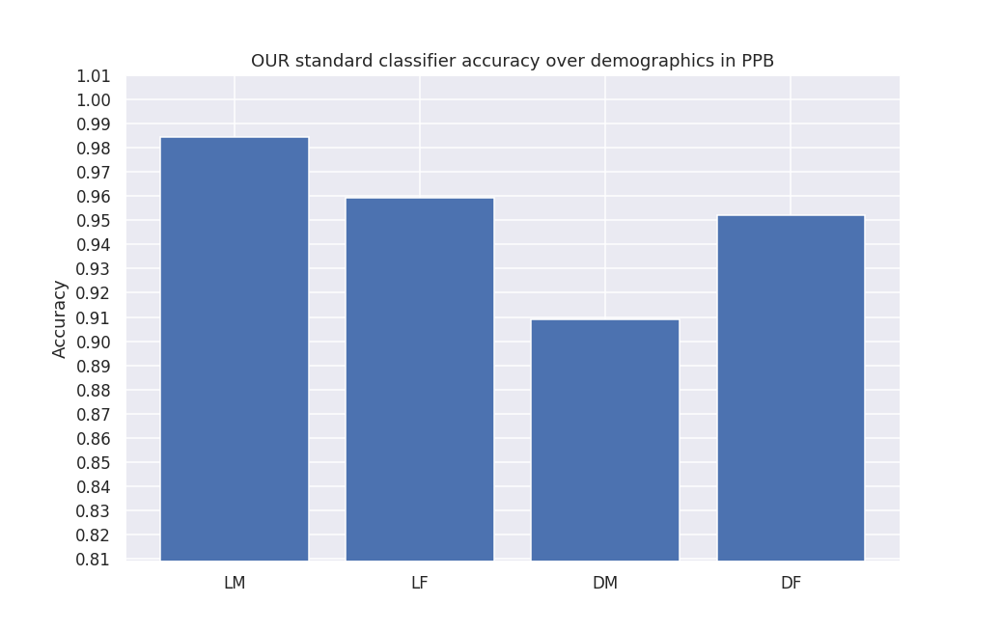

In [16]:
our_standard_classifier_ppb_bias_stats = util.evaluate_on_ppb(model=our_standard_classifier,
                                                              test_loader=ppb_test_loader,
                                                              title='OUR standard classifier accuracy over demographics in PPB')

Again we see bias towards demographic groups, this time more consistently towards DM and DF. We discuss the implications and variance of these results in depth later.

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the standard classifier on OUR Dataset. Here we will look at race, gender and age independently.

<IPython.core.display.Javascript object>


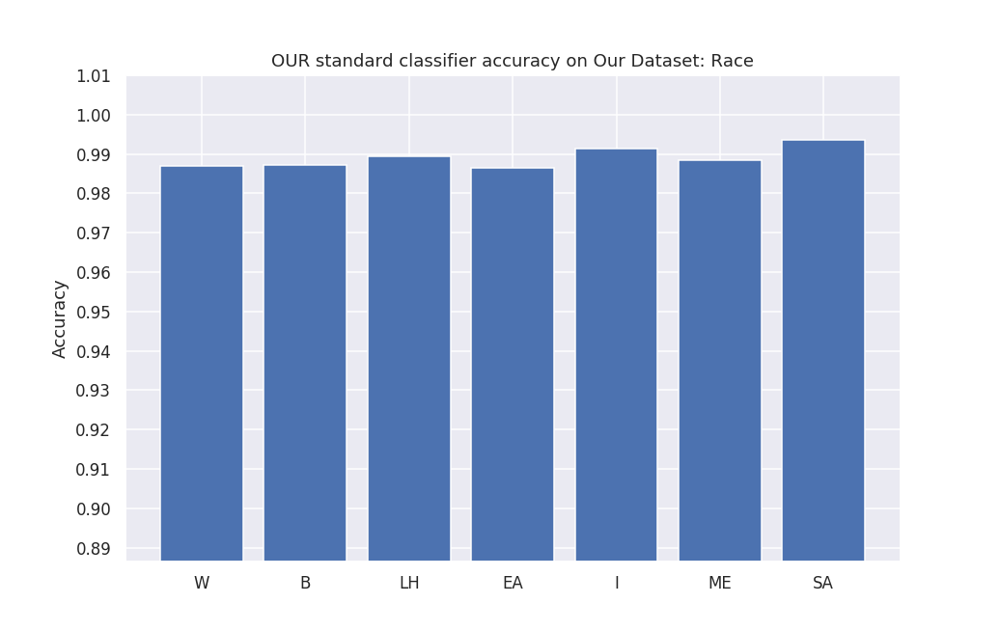

<IPython.core.display.Javascript object>


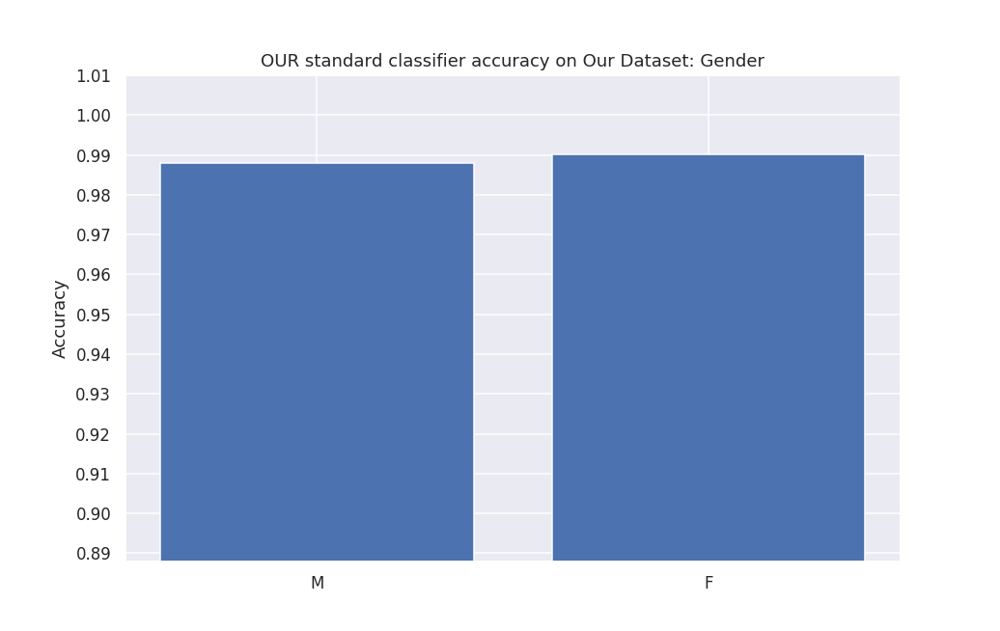

<IPython.core.display.Javascript object>


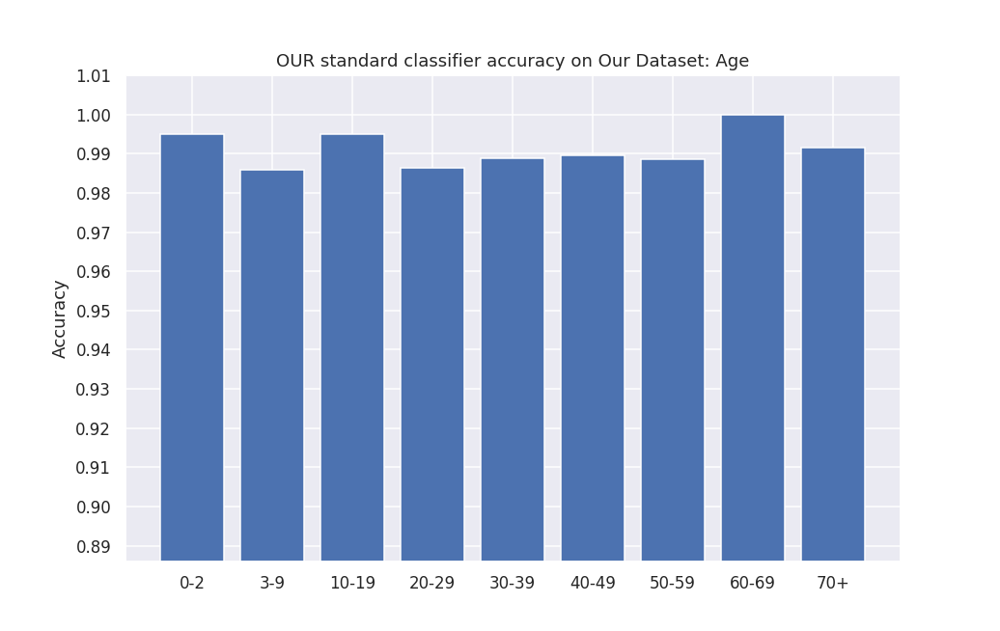

In [17]:
our_standard_classifier_our_bias_stats = util.get_bias_stats_on_our_dataset(model=our_standard_classifier,
                                                                            test_loader=our_val_loader,
                                                                            title='OUR standard classifier accuracy on Our Dataset')

In comparison to evaluation on PPB, there is little to no bias here, neither in race, gender, nor age. The training and testing data seem to capture information in all groups adequately. The bias on PPB might be explained by the different nature of training and validation set in this case. 

## 2.3 Training on OUR-B dataset: simulating MIT dataset

Finally, we train the standard classifier on OUR-B dataset, which is simulating a similar inter-race distribution as in the Mit Dataset. We train for ten epochs and use OUR validation set to checking overfit.

<IPython.core.display.Javascript object>


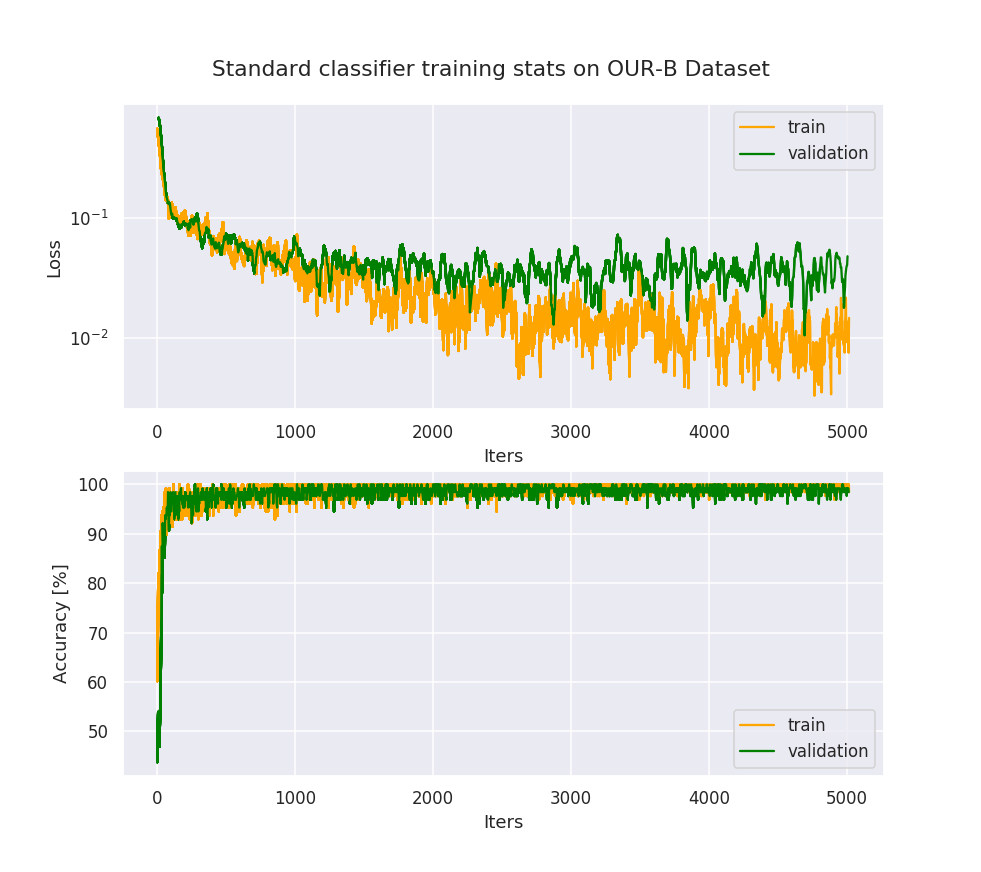

Epoch 01/10: mean acc train/val=95.57%/93.71% ; mean train/val loss=1.16e-01/1.34e-01
Epoch 02/10: mean acc train/val=98.28%/98.10% ; mean train/val loss=4.99e-02/5.21e-02
Epoch 03/10: mean acc train/val=98.85%/98.48% ; mean train/val loss=3.19e-02/4.13e-02
Epoch 04/10: mean acc train/val=99.16%/98.68% ; mean train/val loss=2.31e-02/3.90e-02
Epoch 05/10: mean acc train/val=99.31%/98.70% ; mean train/val loss=1.93e-02/3.52e-02
Epoch 06/10: mean acc train/val=99.49%/98.81% ; mean train/val loss=1.45e-02/3.63e-02
Epoch 07/10: mean acc train/val=99.52%/98.87% ; mean train/val loss=1.43e-02/3.56e-02
Epoch 08/10: mean acc train/val=99.55%/98.79% ; mean train/val loss=1.30e-02/3.89e-02
Epoch 09/10: mean acc train/val=99.62%/98.86% ; mean train/val loss=1.09e-02/3.45e-02
Epoch 10/10: mean acc train/val=99.66%/98.80% ; mean train/val loss=1.01e-02/3.65e-02



In [18]:
# Init standard classifier for Mit Dataset
our_biased_standard_classifier = cnn_face_detection.CNN()
our_biased_standard_classifier = our_biased_standard_classifier.to(our_biased_standard_classifier.device)

# Train classifier
our_biased_standard_classifier_train_stats = our_biased_standard_classifier.run_training(batch_size=128, num_epochs=10,
                                                                                         train_dataset=our_biased_train_loader,
                                                                                         title='Standard classifier training stats on OUR-B Dataset',
                                                                                         validation_dataset=our_val_loader)

# Saving the model
#util.save_model(our_biased_standard_classifier, "OUR-B_standard_cnn")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Init standard classifier for Mit Dataset
our_biased_standard_classifier = cnn_face_detection.CNN()

our_biased_standard_classifier = our_biased_standard_classifier.to(our_biased_standard_classifier.device)
# Load model from file
our_biased_standard_classifier.load_state_dict(torch.load("OUR-B_standard_cnn.pt",map_location=our_biased_standard_classifier.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of our biased standard classifier on the PPB dataset.
For the PPB data, we'll look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 1.00
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 1.00
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.92
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.97


/home/frederic/FACT-AI/util.py:1059: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9.5, 6), num=title)


<IPython.core.display.Javascript object>


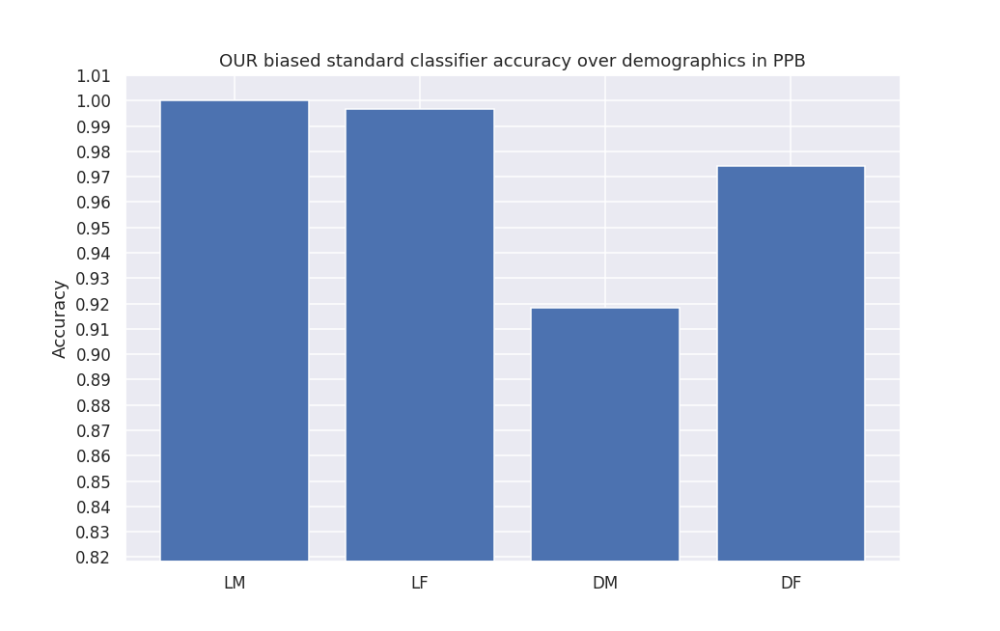

In [19]:
our_biased_standard_classifier_ppb_bias_stats = util.evaluate_on_ppb(model=our_biased_standard_classifier,
                                                                     test_loader=ppb_test_loader,
                                                                     title='OUR biased standard classifier accuracy over demographics in PPB')

Interestingly the bias is comparable to the one on OUR dataset. It seems like the shift in dataset distribution did not have a large impact.

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the standard classifier on OUR dataset. Here we will look at race, gender and age independently.

/home/frederic/FACT-AI/util.py:1224: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9.5, 6), num=title)


<IPython.core.display.Javascript object>


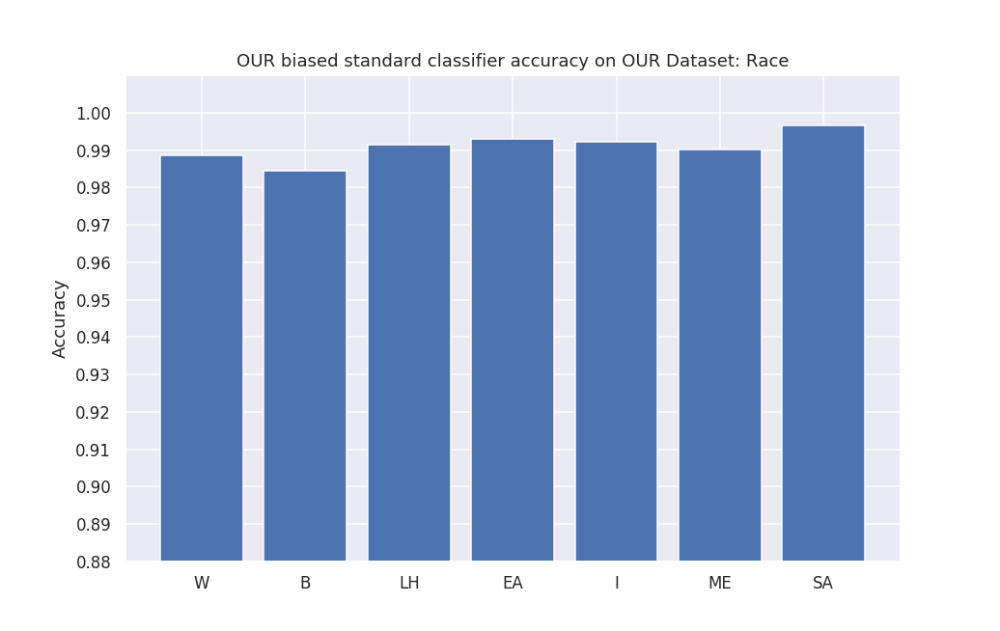

<IPython.core.display.Javascript object>


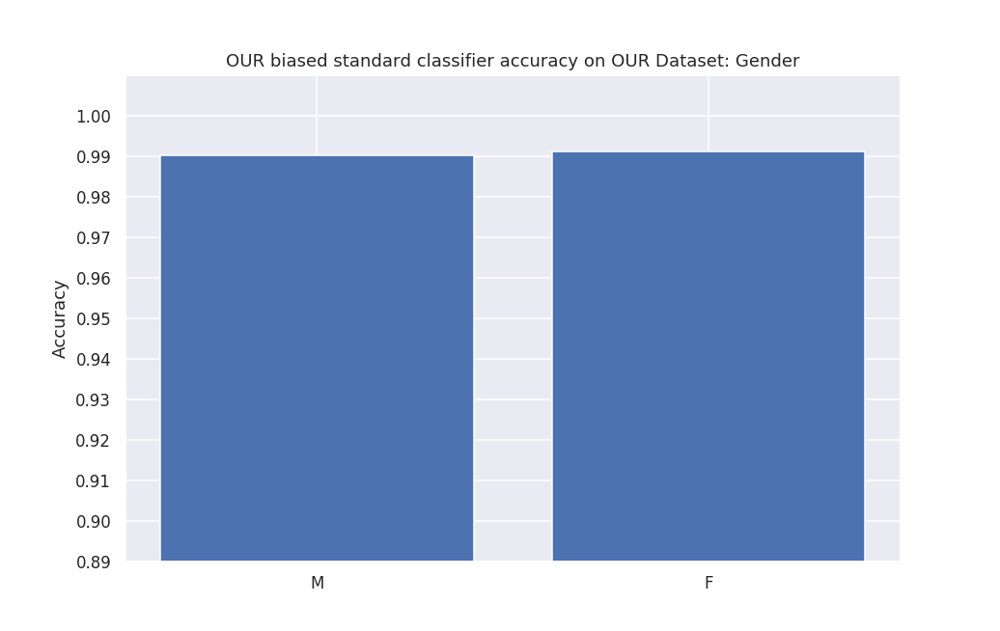

<IPython.core.display.Javascript object>


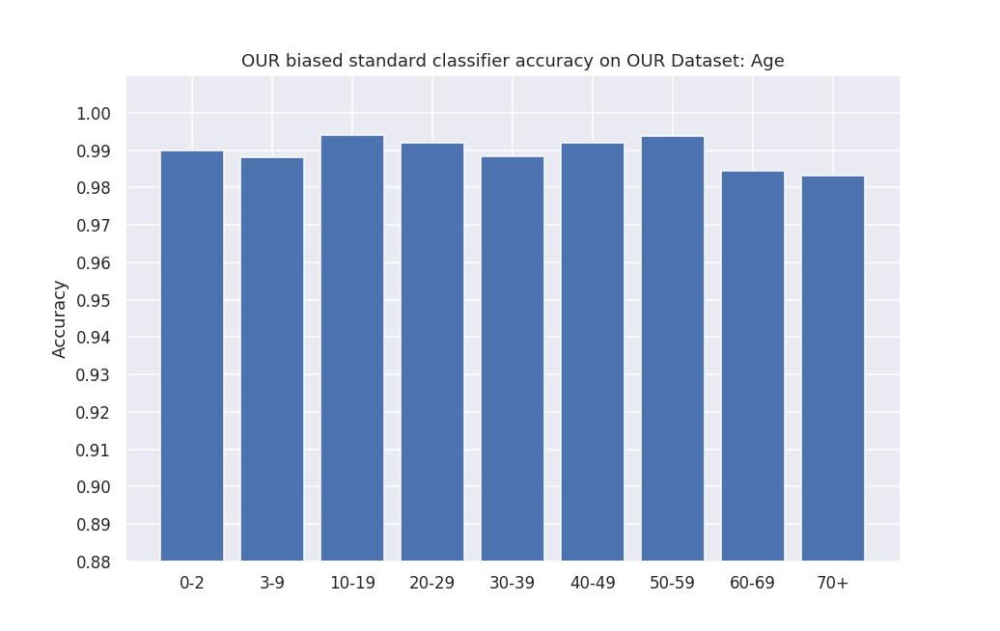

In [20]:
our_biased_standard_classifier_our_bias_stats = util.get_bias_stats_on_our_dataset(model=our_biased_standard_classifier,
                                                                                   test_loader=our_val_loader,
                                                                                   title='OUR biased standard classifier accuracy on OUR Dataset')

Also in this evaluation the massive shift in training data distribution did not lead to a big difference in results. 

## 2.4 Barplot comparing bias evaluations

/home/frederic/FACT-AI/stats_util.py:284: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9.5, 7), num=title)


<IPython.core.display.Javascript object>


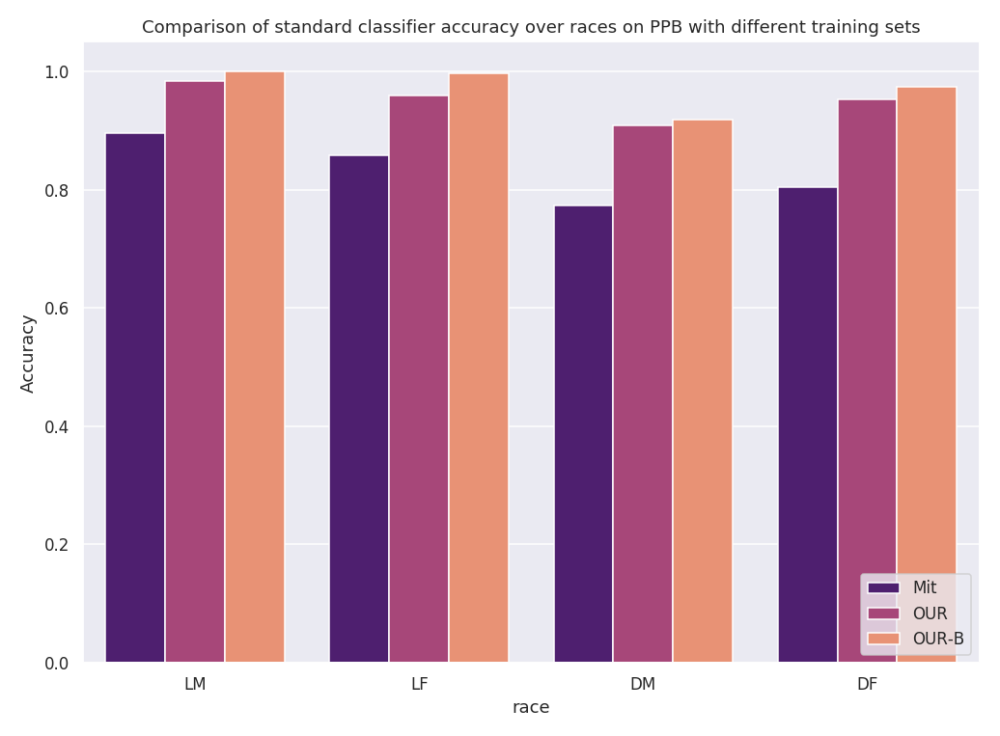

/home/frederic/FACT-AI/stats_util.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(3, 1, figsize=(9.5, 9.5), num=title)


<IPython.core.display.Javascript object>


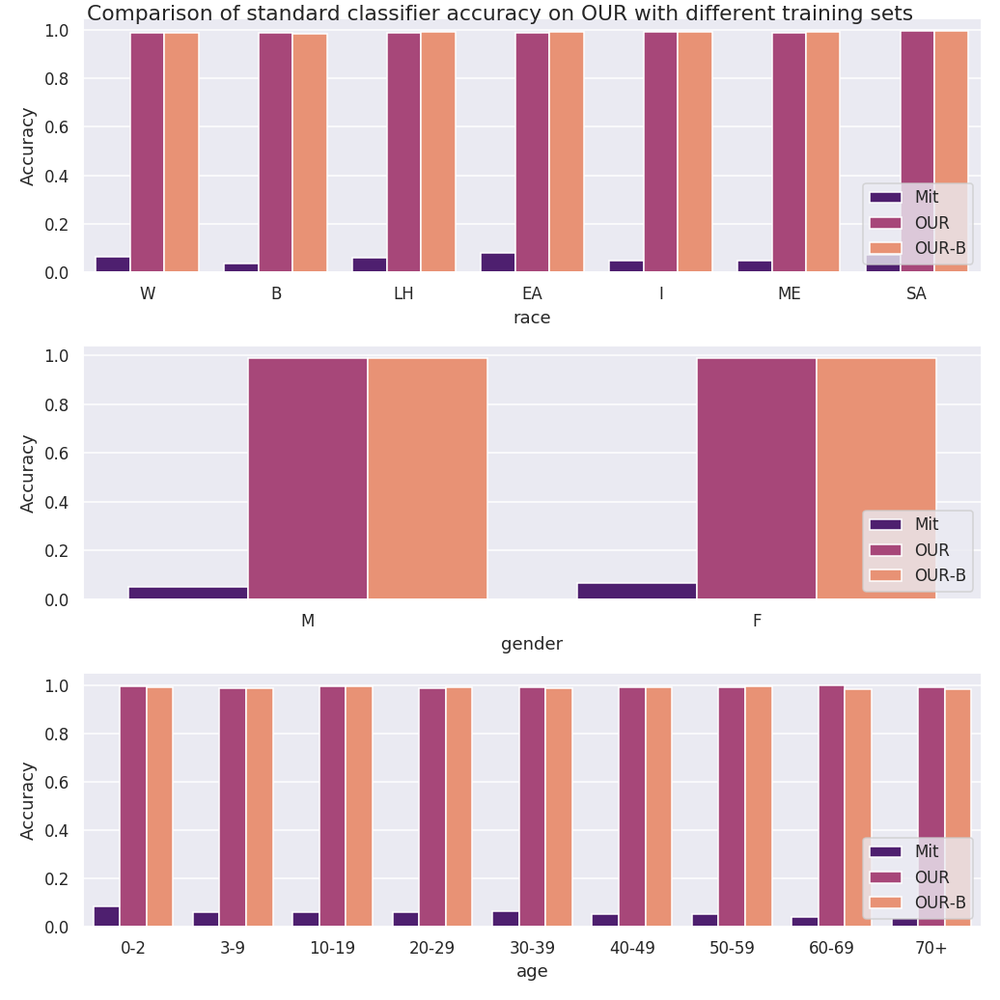

In [21]:
stats_util.barplot_compare_ppb(mit_standard_classifier_ppb_bias_stats,
                               our_standard_classifier_ppb_bias_stats,
                               our_biased_standard_classifier_ppb_bias_stats,
                               title="Comparison of standard classifier accuracy over races on PPB with different training sets")

stats_util.barplot_compare_our(mit_standard_classifier_our_bias_stats,
                               our_standard_classifier_our_bias_stats,
                               our_biased_standard_classifier_our_bias_stats,
                               title="Comparison of standard classifier accuracy on OUR with different training sets")

Interestingly resutls on OUR and OUR-B are very comparable. OUR-B does not show the same tendency as MIT eventhough the inter-race distribution is now very similar. An observation to keep in mind. We will investigate this deeper on the multi-run results at the end of the notebook.

# 3. VAE for debiasing (DB-VAE)

Now that we have got some intuition on bias in face detection, we can dive into the world of the DB-VAE. We going to start by briefly discussing it's functionality, then we train and validate it, as we did for the standard classifier. 

The image below shows the general structure of the DB-VAE (source image from the original paper). As you can see, its main architecture is very similar to the one of a standard VAE. It consists of an encoder that projects samples $x$ into a latent space $z$ and a decoder that aims to reconstruct $x$ from $z$. 

<img src="images_jupyter_notebook/DBVAE.png">


Importantly, note how the encoder portion in the DB-VAE architecture also outputs a single supervised variable,
$z_o$, corresponding to the class prediction -- face or not face. In this way, the encoder also functions as a classifier. Usually, traditional VAEs are not trained to output any supervised variables (such as a class prediction)! Thus, this is a key distinction of the DB-VAE. 

Another distinction can be drawn with regard to training. Generally, the DB-VAE trains the latent space and reconstruction using the same loss a standard VAE. However, the latent space is only updated to capture information regarding the face-class. This means that gradients of non-face samples are blocked by masking, indicated in the figure by the cut lines.  

To sum up, **for faces**, our DB-VAE model both learns a representation of the unsupervised latent variables,
captured by the distribution $q_\phi(z|x)$, **and** outputs a supervised class prediction $z_o$, but **for
negative examples**, it only outputs a class prediction $z_o$. This makes sense as faces are what we're ultimately are debiasing against. Thus, we arrive at the following sample loss function, which is averaged over samples in case of batches:

$$\begin{equation}
\mathcal{L}_{SAMPLE}=
c_{class} \cdot \underbrace{\left[y \log (\frac{1}{\hat{y}})\right]}_{\mathcal{L}{class}(y, \hat{y})}
+ y \cdot \underbrace{\left[c_{recon} \cdot \underbrace{\left[\|x-\hat{x}\|_{2}\right]}_{\mathcal{L}_{recon}(x, \hat{x})}
+c_{KL} \cdot \underbrace{\left[\frac{1}{2} \sum_{j=0}^{k-1}\left(\sigma_{j}+\mu_{j}^{2}-1-\log \left(\sigma_{j}\right)\right)\right]}_{\mathcal{L}_{K L}(\mu, \sigma)}\right]}_{\mathcal{L}_{VAE}}
\end{equation}$$

The two main terms $\mathcal{L}_{class}$ and $\mathcal{L}_{VAE}$ represent the two main objectives in DB-VAE, namely classification and modelling latent distribution. For the former, we use Binary-Cross-Entropy. For the latter, we use the L-2 Norm for the reconstruction loss $\mathcal{L}_{recon}$ and the KL divergence for $\mathcal{L}_{KL}$. Importantly, you can also see the masking happening here, as the $\mathcal{L}_{VAE}$ is multiplied by the label $y$ to set it to zero for non-face samples. Furthermore, the individual loss terms are weighted by $c_{class}$, $c_{recon}$ and $c_{KL}$, which allows steering the focus of the model. In our experiments these weights are chosen by experimentation to $c_{class}=0.2$, $c_{recon}=0.1$ and $c_{KL}=0.05$. In general, we observed that setting the KL loss weight in magnitude lower than the others helped to let the latent space settle better. 

Finally, the most significant contribution of the DB-VAE is the idea of using the learned latent distribution for generating sample probabilities $\mathcal{P}(X| Z)$. This is achieved by fitting a probability distribution over the latent means of all training samples. The MIT paper is not very precise on this step, nor does the MIT implementation seem to follow the paper. Nevertheless, we try to keep as close as possible to the paper and present our implementation on the resampling.

We start the process by fitting a ten-bin histogram $\hat{\mathcal{Q}}_{i}\left(\boldsymbol{z}_{i} | X\right)$ to each latent mean dimension $z_i$ independently. This histogram can then be used to approximate the latent probability of individual samples $\\mathcal{P_Q}_{i}\left(X | \hat{\mathcal{Q}}_{i}( \boldsymbol{z}_{i} | X)\right)$ by the probability mass of their respective bins. To combine the sample probabilities $\mathcal{P_Q}_{i}$ over the individual latent dimensions $z_i$ we use the log sum trick, as multiplying the dimensions, as presented in the paper, would lead to numerical instabilities. Furthermore, as we want to give samples with high latent probability mass a low sample probability, we need to invert the latent probability. Thus, the sample weights $\mathcal{W}(X| Z)$ are given by

$$
\mathcal{W}(X | Z) = \sum_{i} \log \left( \frac{1}{\mathcal{P_Q}_{i}\left(X | \hat{\mathcal{Q}}_{i}( \boldsymbol{z}_{i} | X)\right)+\alpha}  +1 \right)
$$

Where a smoothing factor $\alpha$ can be added to regularize the amount of debiasing by forcing the sample distribution toward a uniform distribution with increasing $\alpha$. The $+1$ is added to make sure the log is always positive and probabilites are accumulated over latent dimensions. To make $\mathcal{W}(X| Z)$ a valid probability distribution $\mathcal{P}(X | Z)$ we can normalize the values:

$$
\mathcal{P}(X | Z) = \frac{\mathcal{W}(X | Z)}{\sum_{j} \mathcal{W}(x_j | Z)}
$$

$\mathcal{P}(X | Z)$ is recalculated at the beginning of every epoch and is used to sample from the training data. As the model does not necessarily see all the data, one epoch is defined after the model sees as many images as in the complete dataset. 

The encoder architecture is identical to the one used in the standard classifier introduces in chapter 2. The only addition is two latent heads, parallel to the classifier head. These use the same architecture as the classifier but with no output activation. The decoder architecture is a mirror of the encoder using deconvolutions.

More details can be found in the implementation of `db_vae.py`.

## 3.1 Training on Mit Dataset

We now train the DB-VAE on Mit dataset.

/home/frederic/FACT-AI/db_vae.py:946: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  self.metric_plots['fig'] = plt.figure(figsize=(9, 10.5), num=title)


<IPython.core.display.Javascript object>


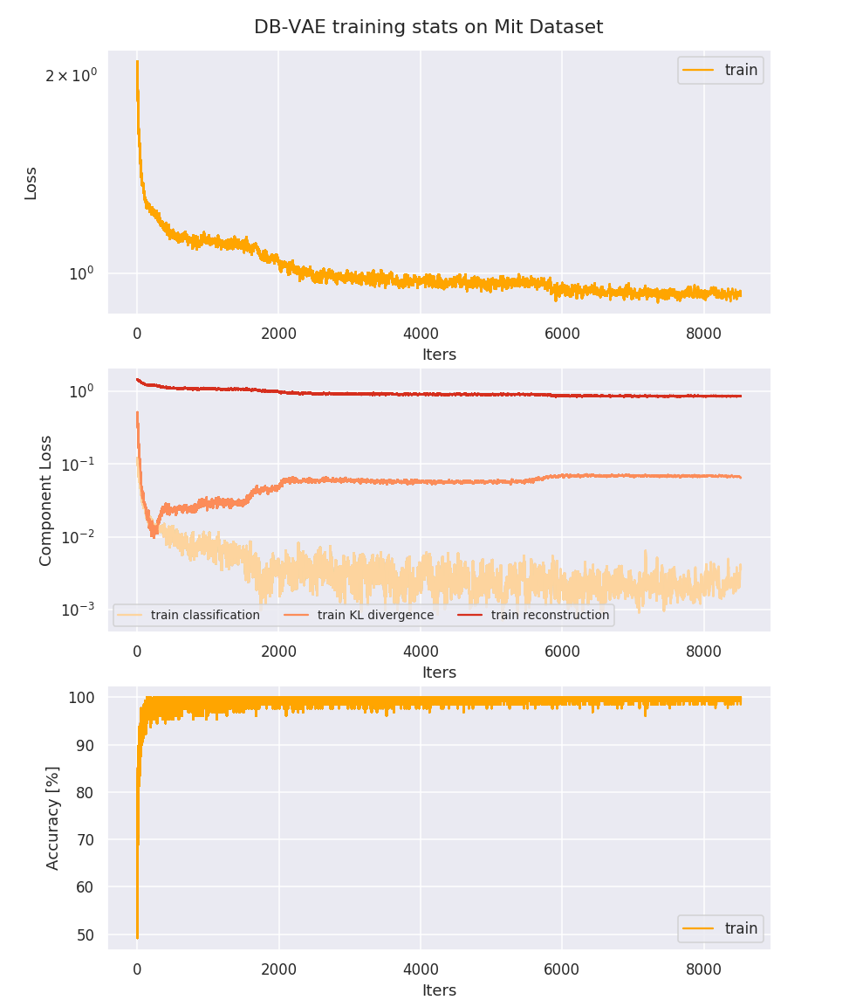

Recomputing debiasing sample probabilities..


/home/frederic/FACT-AI/db_vae.py:709: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9.5, 8), num=title)


<IPython.core.display.Javascript object>


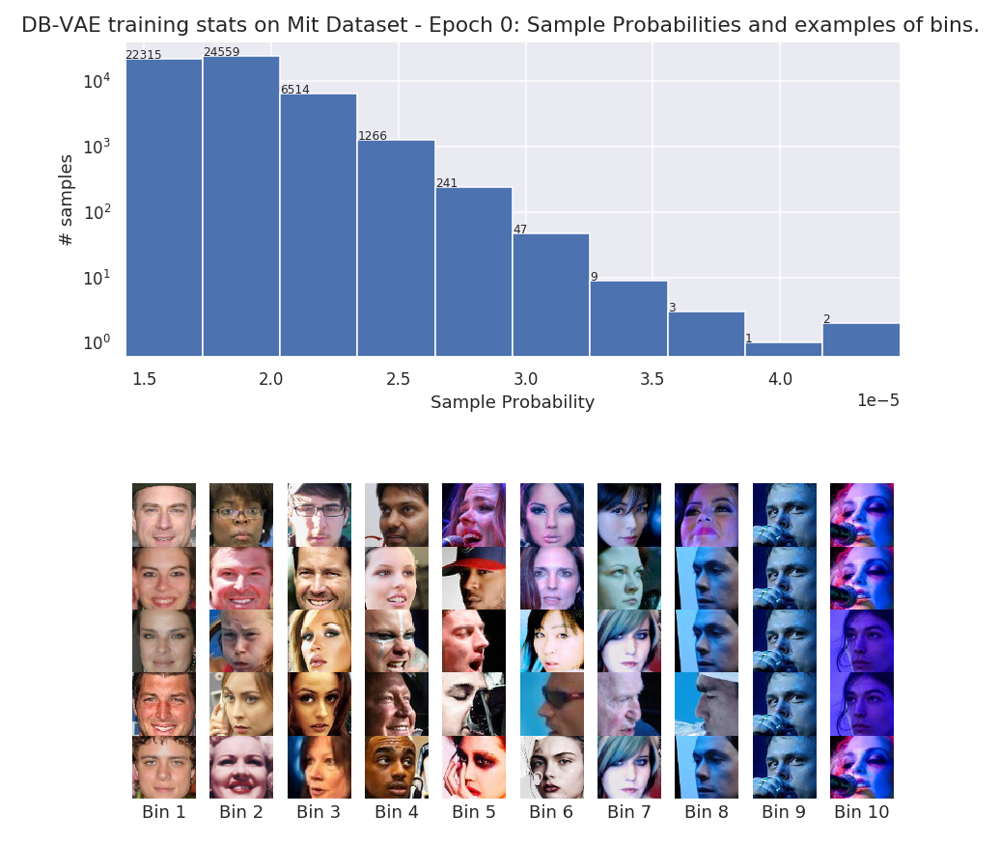

Will be interpolated.


/home/frederic/FACT-AI/db_vae.py:879: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9.5, 4), num=title)


<IPython.core.display.Javascript object>


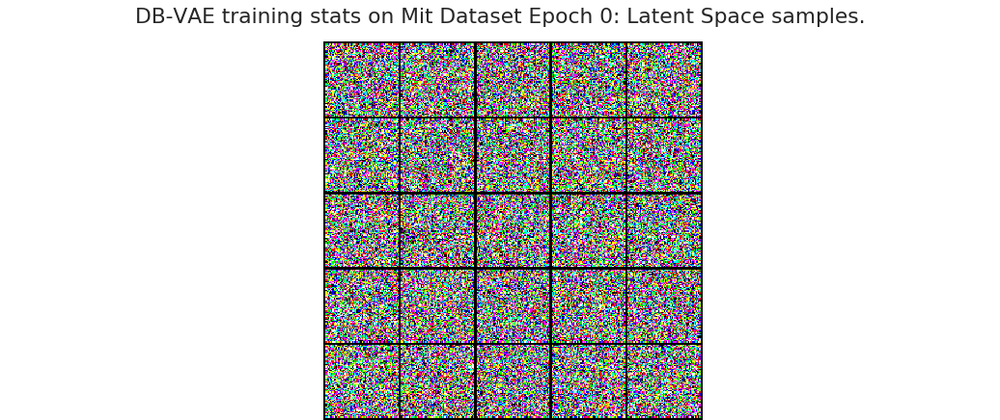

/home/frederic/FACT-AI/db_vae.py:457: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(9, 4.5), num=title)


<IPython.core.display.Javascript object>


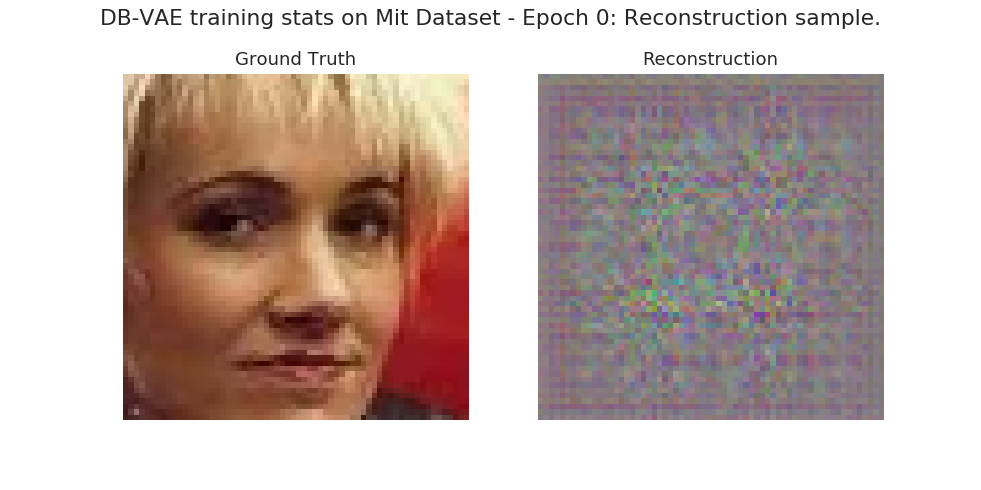

/home/frederic/FACT-AI/db_vae.py:461: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt1 = fig.add_subplot(1, 2, 1)
/home/frederic/FACT-AI/db_vae.py:469: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt2 = fig.add_subplot(1, 2, 2)




 Epoch 01/10:
   mean accuracy   train/val = 97.06%   / -- 
   mean train loss train/val = 1.22e+00 / -- 
   mean class loss train/val = 1.67e-02 / -- 
   mean KL loss    train/val = 3.59e-02 / -- 
   mean recon loss train/val = 1.17e+00 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


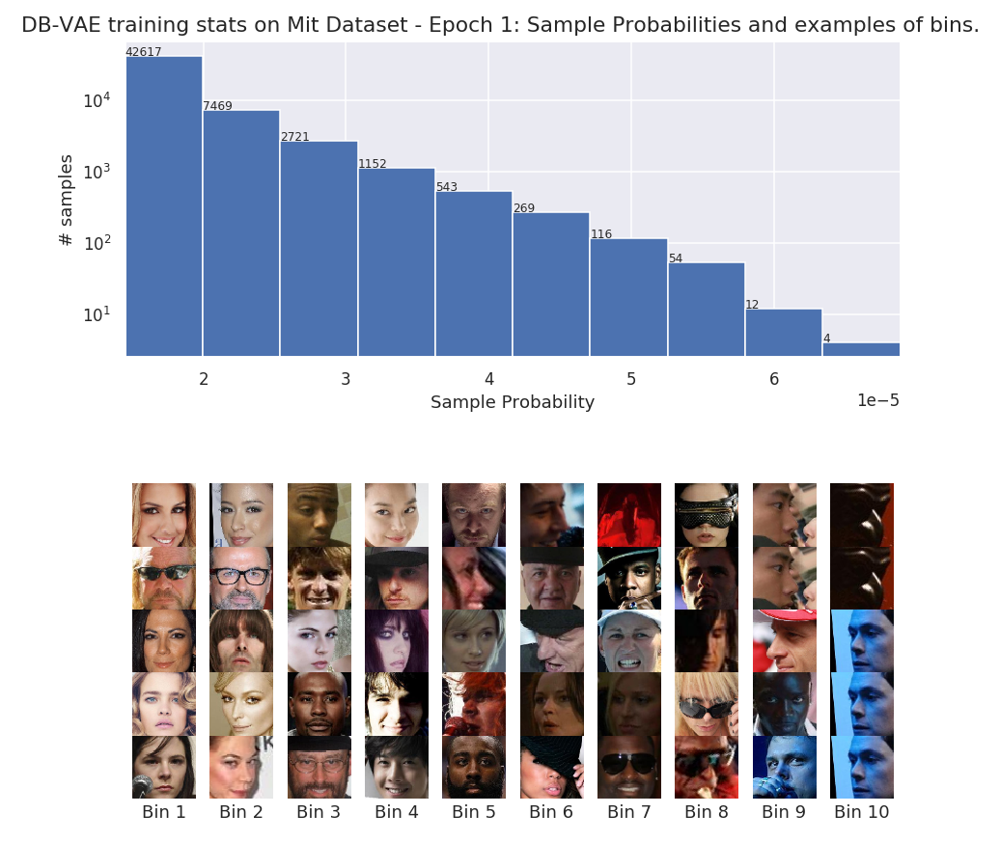

<IPython.core.display.Javascript object>


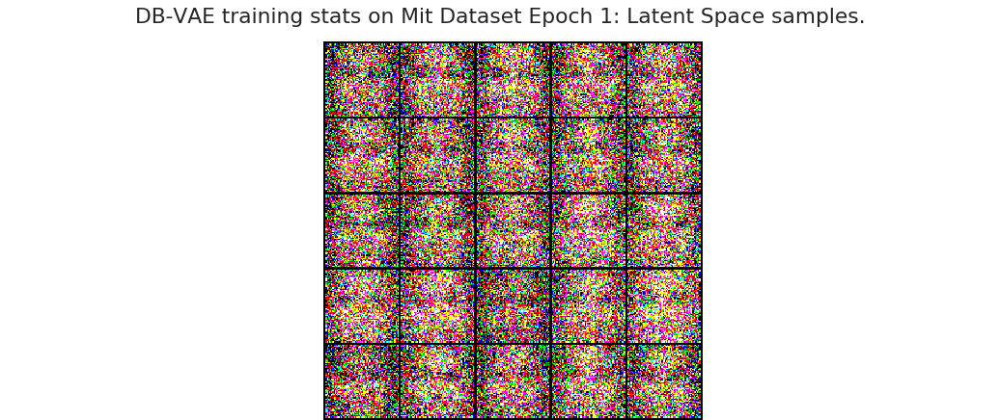

<IPython.core.display.Javascript object>


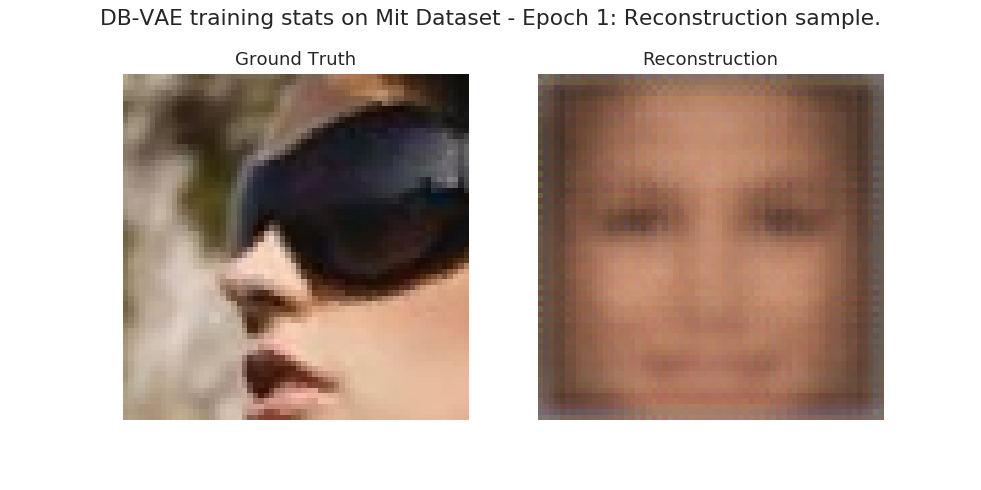



 Epoch 02/10:
   mean accuracy   train/val = 98.97%   / -- 
   mean train loss train/val = 1.11e+00 / -- 
   mean class loss train/val = 6.28e-03 / -- 
   mean KL loss    train/val = 3.13e-02 / -- 
   mean recon loss train/val = 1.07e+00 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


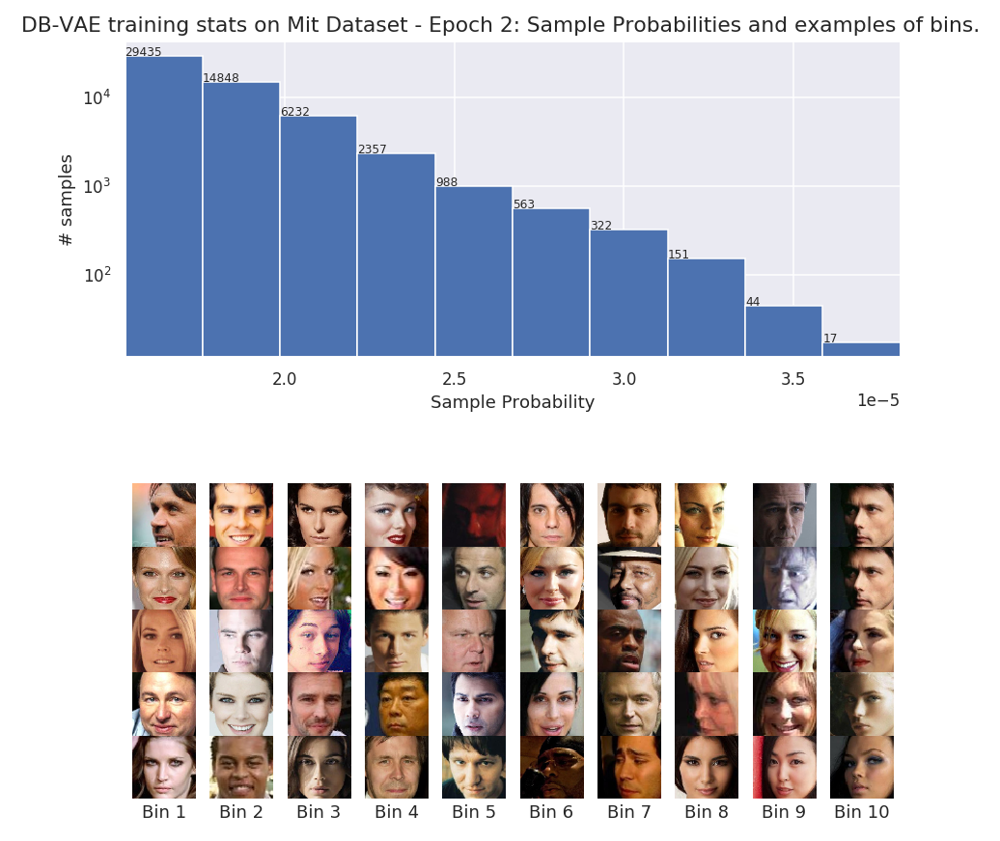

<IPython.core.display.Javascript object>


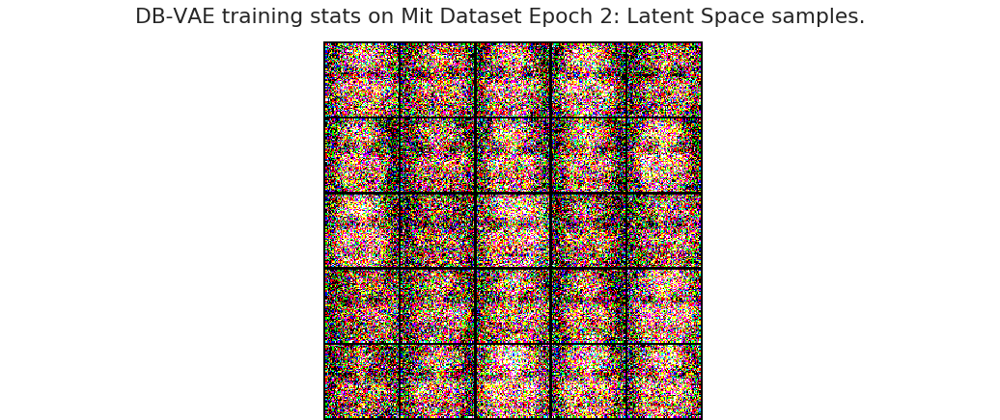

<IPython.core.display.Javascript object>


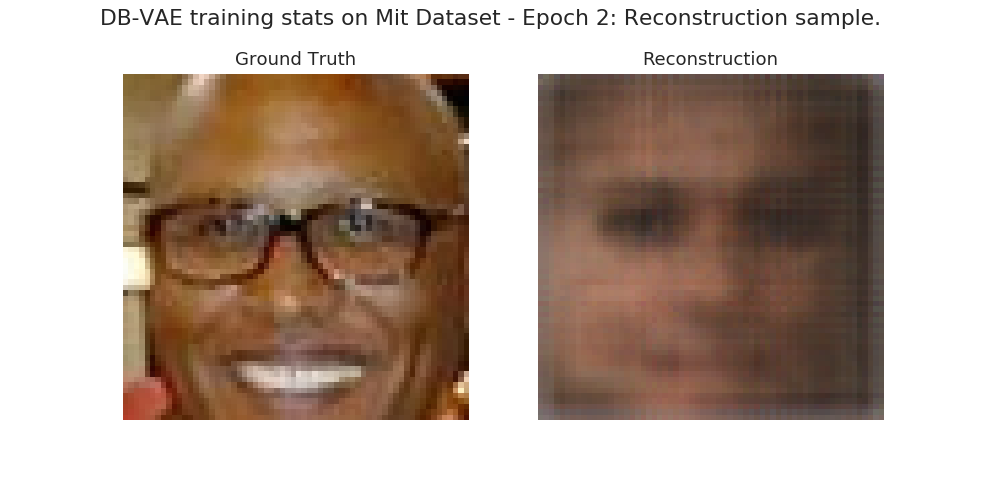



 Epoch 03/10:
   mean accuracy   train/val = 99.43%   / -- 
   mean train loss train/val = 1.03e+00 / -- 
   mean class loss train/val = 3.50e-03 / -- 
   mean KL loss    train/val = 5.42e-02 / -- 
   mean recon loss train/val = 9.68e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


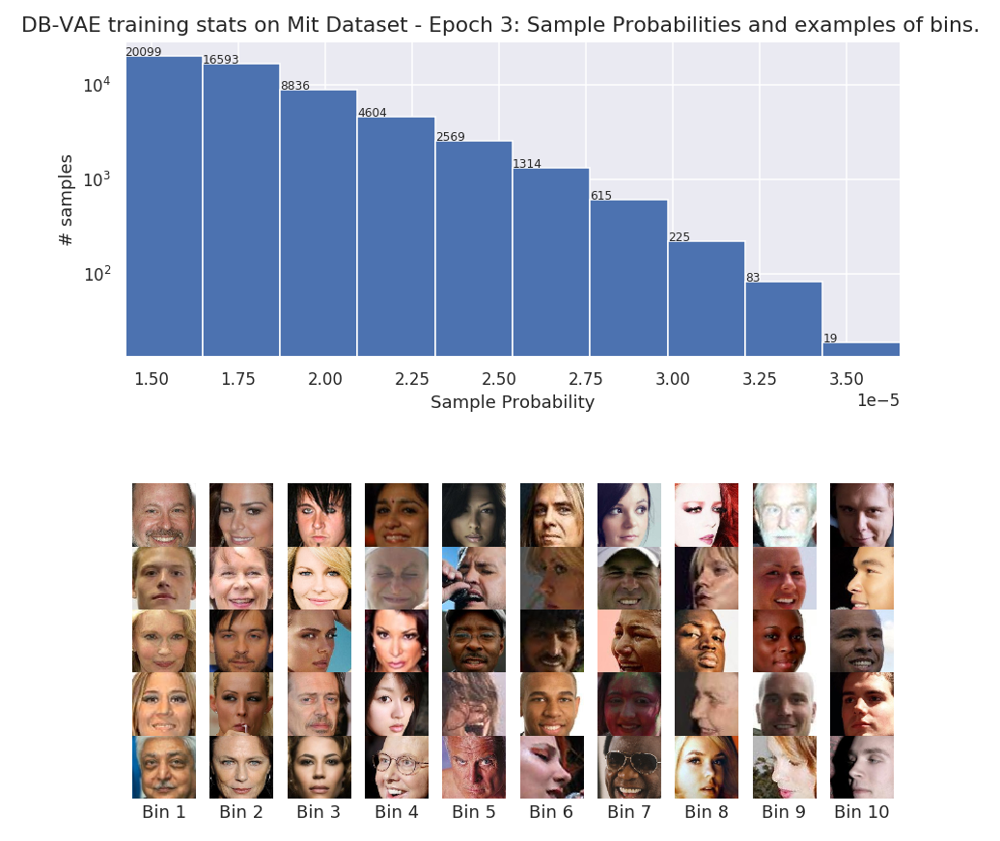

<IPython.core.display.Javascript object>


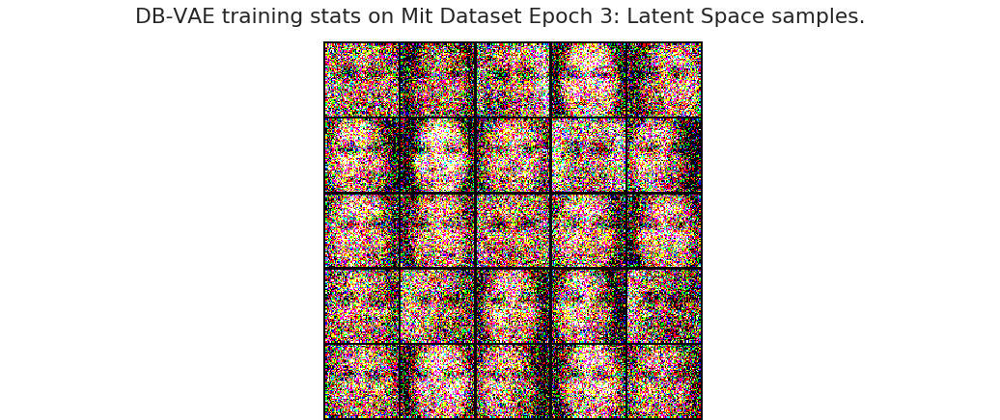

<IPython.core.display.Javascript object>


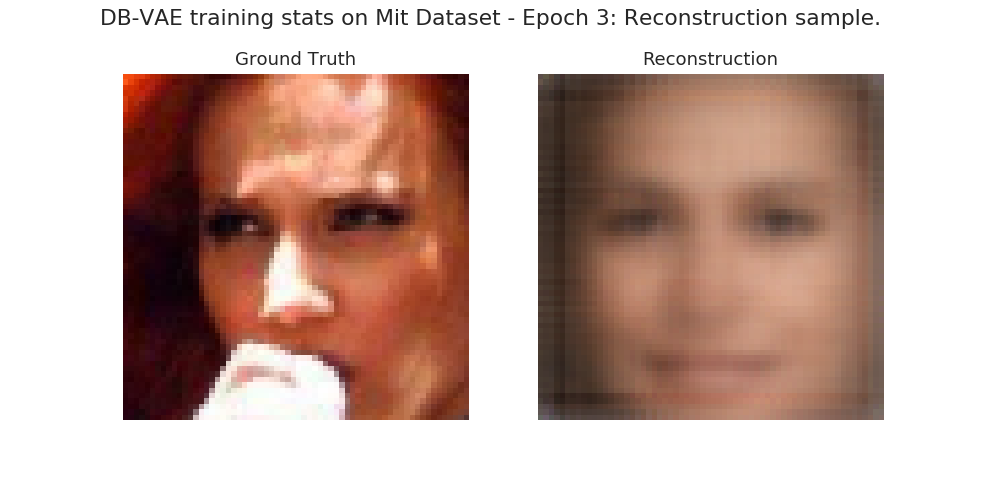



 Epoch 04/10:
   mean accuracy   train/val = 99.49%   / -- 
   mean train loss train/val = 9.86e-01 / -- 
   mean class loss train/val = 3.37e-03 / -- 
   mean KL loss    train/val = 5.96e-02 / -- 
   mean recon loss train/val = 9.23e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


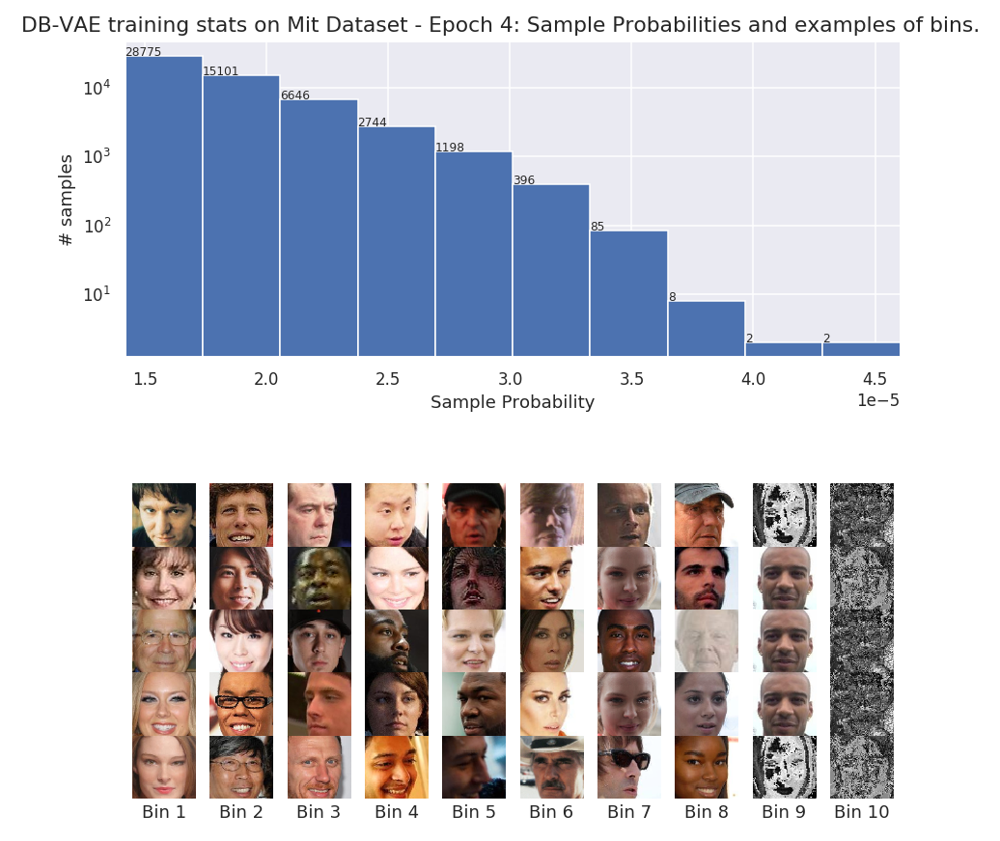

<IPython.core.display.Javascript object>


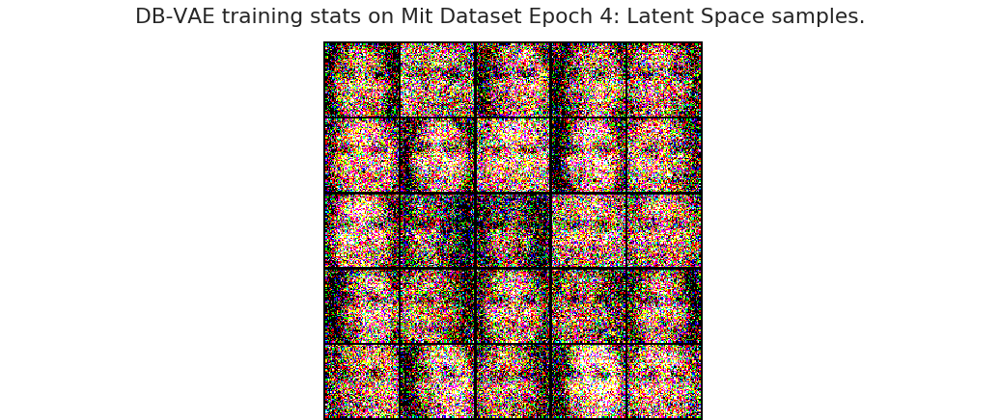

<IPython.core.display.Javascript object>


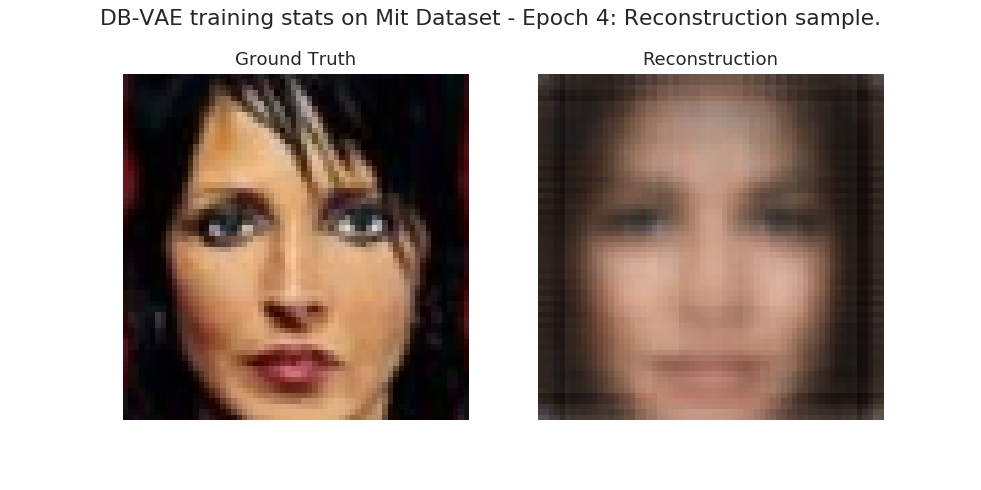



 Epoch 05/10:
   mean accuracy   train/val = 99.56%   / -- 
   mean train loss train/val = 9.76e-01 / -- 
   mean class loss train/val = 2.90e-03 / -- 
   mean KL loss    train/val = 5.73e-02 / -- 
   mean recon loss train/val = 9.16e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


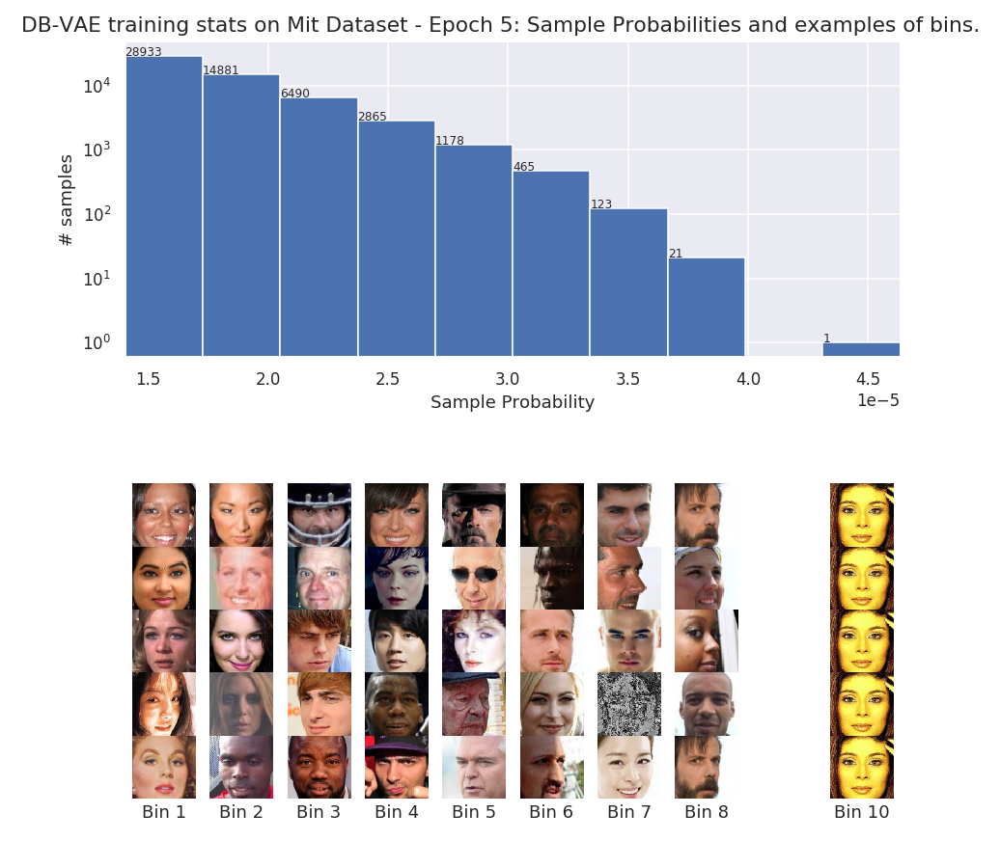

<IPython.core.display.Javascript object>


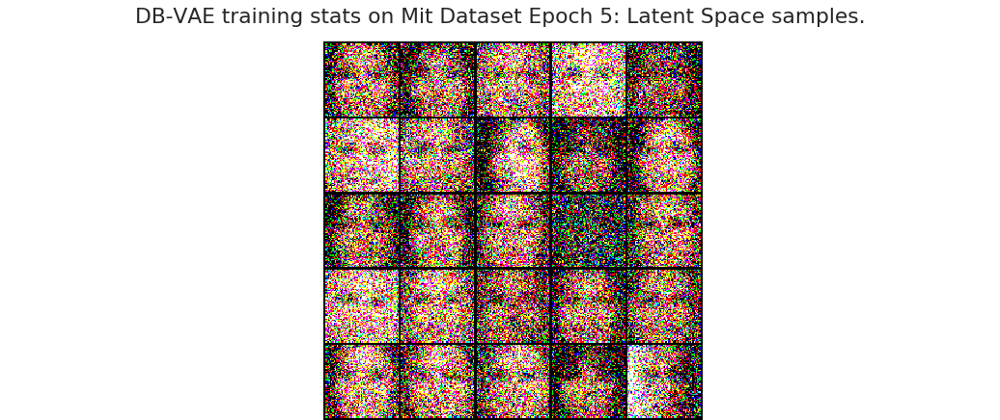

<IPython.core.display.Javascript object>


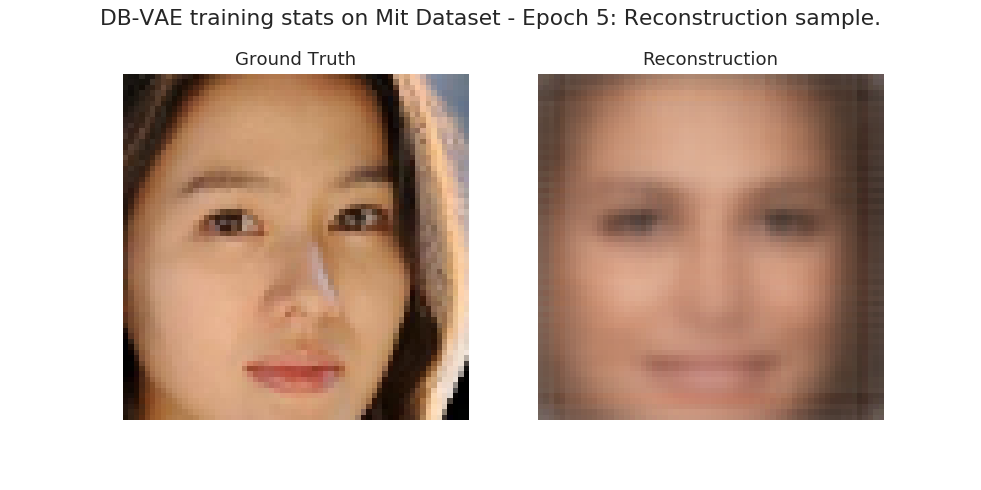

/home/frederic/FACT-AI/db_vae.py:1424: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  self.metric_plots['fig'].canvas.draw()




 Epoch 06/10:
   mean accuracy   train/val = 99.60%   / -- 
   mean train loss train/val = 9.67e-01 / -- 
   mean class loss train/val = 2.70e-03 / -- 
   mean KL loss    train/val = 5.72e-02 / -- 
   mean recon loss train/val = 9.08e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


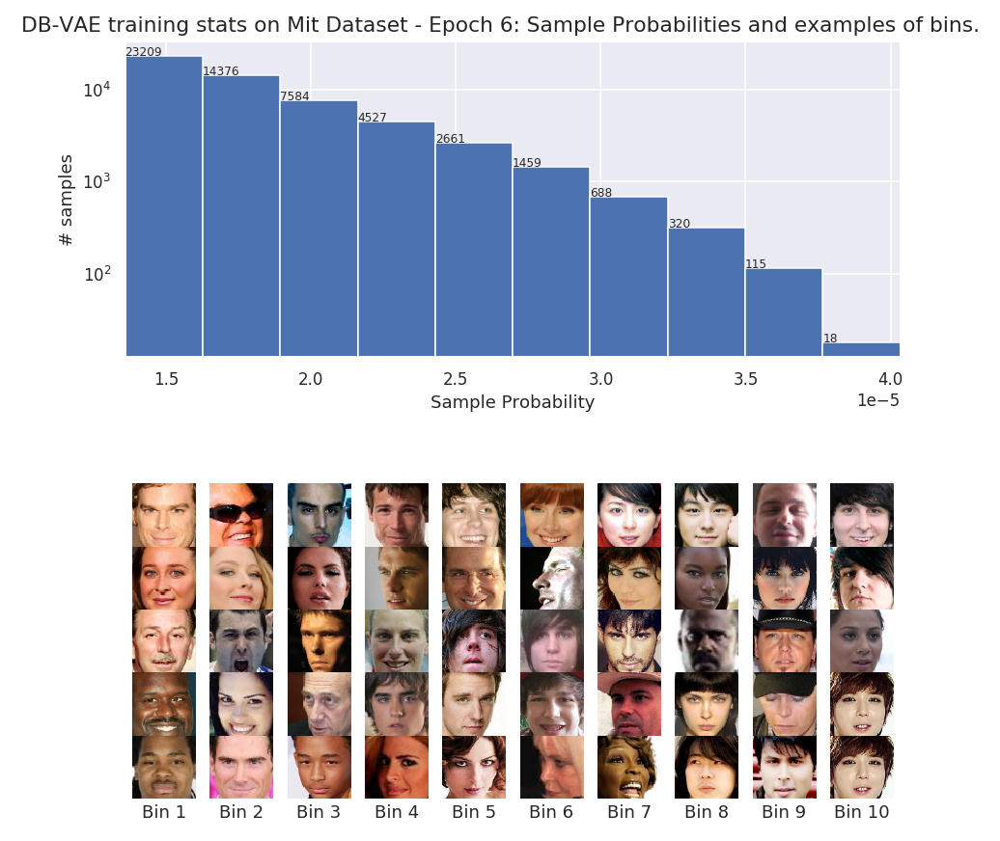

<IPython.core.display.Javascript object>


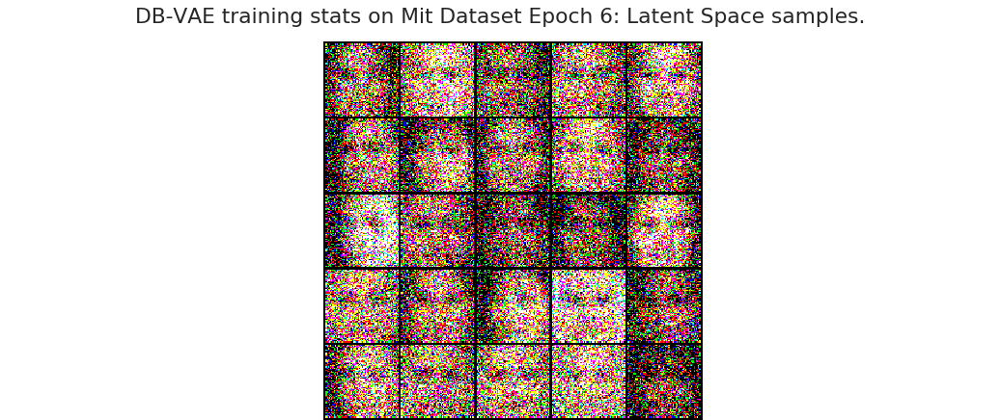

<IPython.core.display.Javascript object>


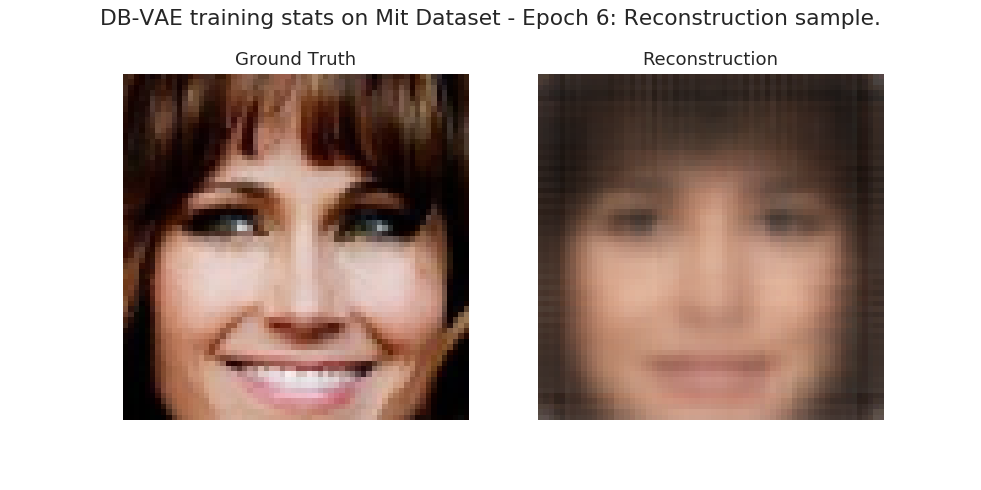



 Epoch 07/10:
   mean accuracy   train/val = 99.64%   / -- 
   mean train loss train/val = 9.64e-01 / -- 
   mean class loss train/val = 2.55e-03 / -- 
   mean KL loss    train/val = 6.17e-02 / -- 
   mean recon loss train/val = 8.99e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


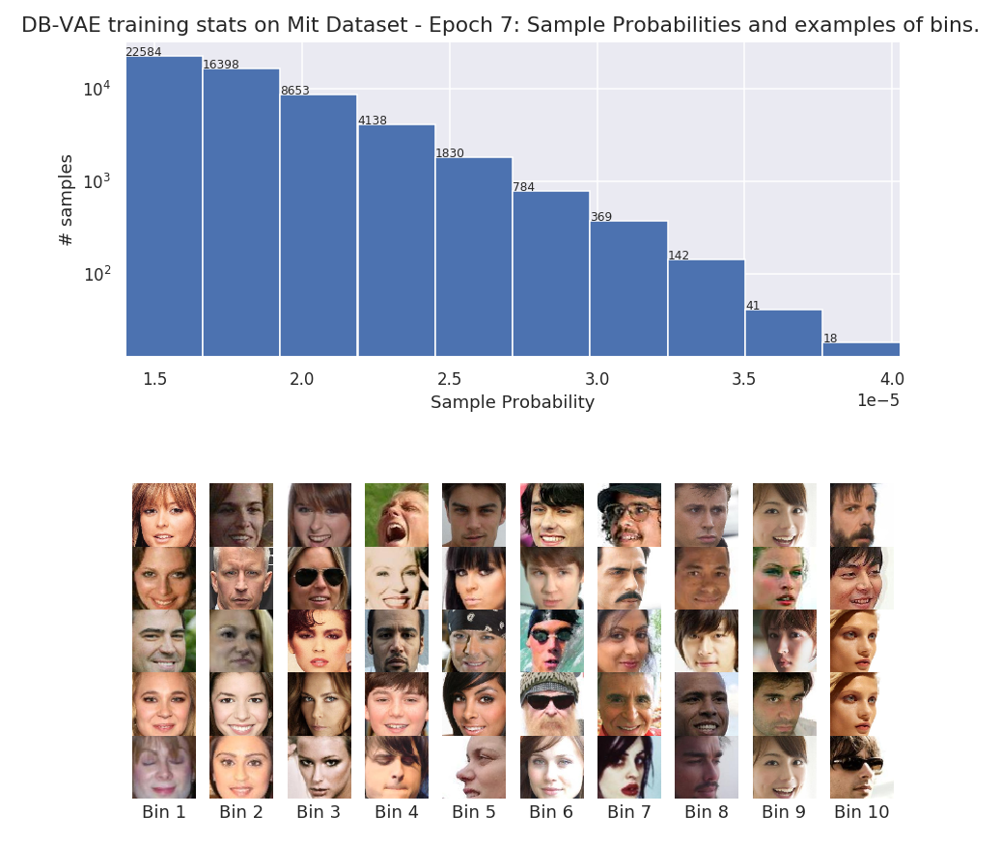

<IPython.core.display.Javascript object>


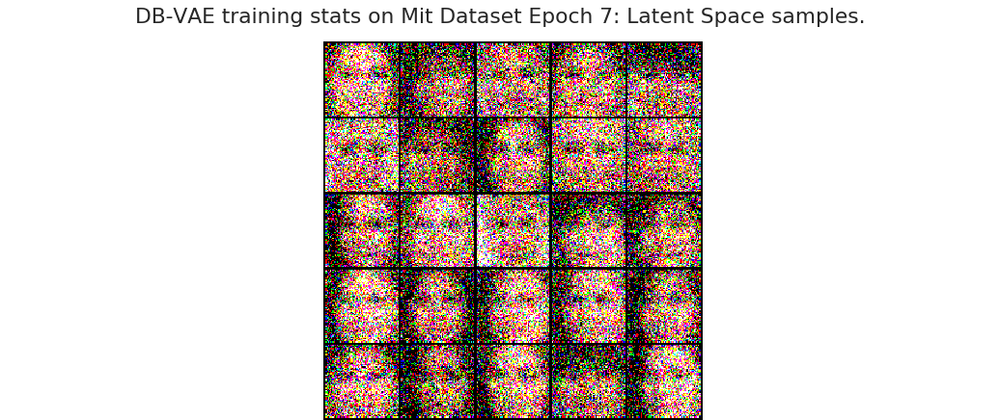

<IPython.core.display.Javascript object>


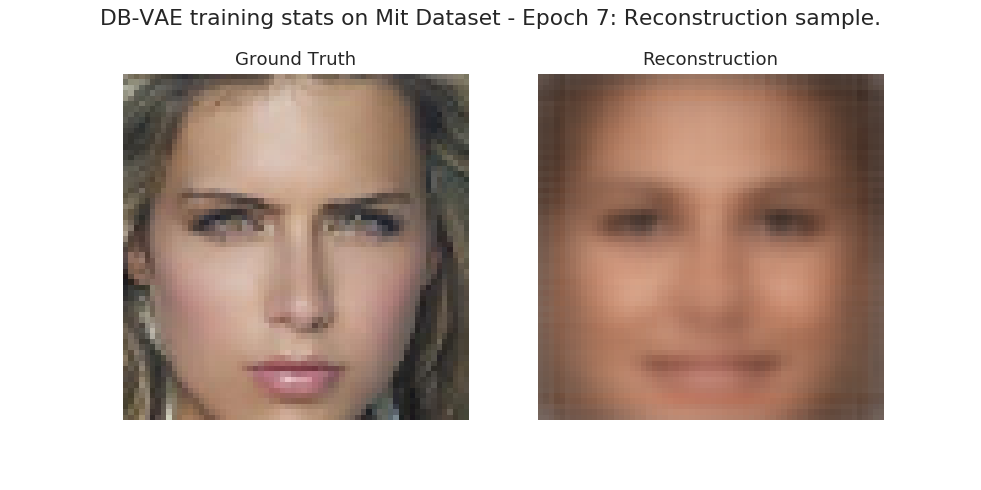



 Epoch 08/10:
   mean accuracy   train/val = 99.74%   / -- 
   mean train loss train/val = 9.40e-01 / -- 
   mean class loss train/val = 2.25e-03 / -- 
   mean KL loss    train/val = 6.93e-02 / -- 
   mean recon loss train/val = 8.68e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


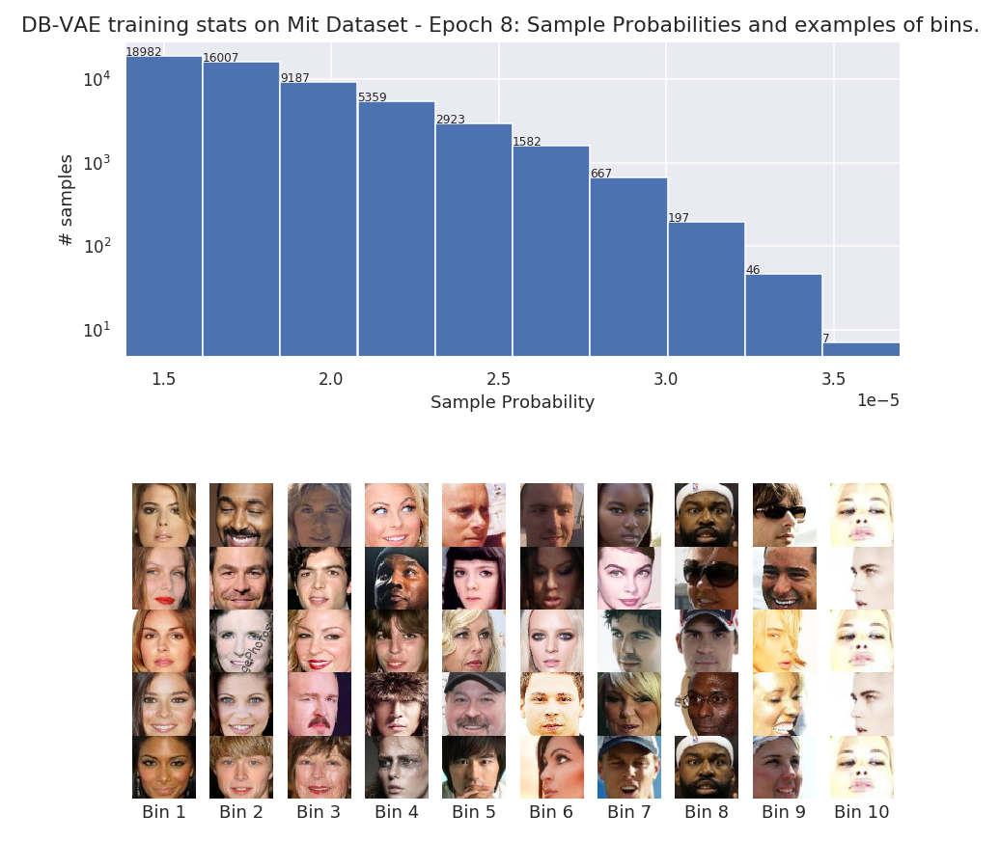

<IPython.core.display.Javascript object>


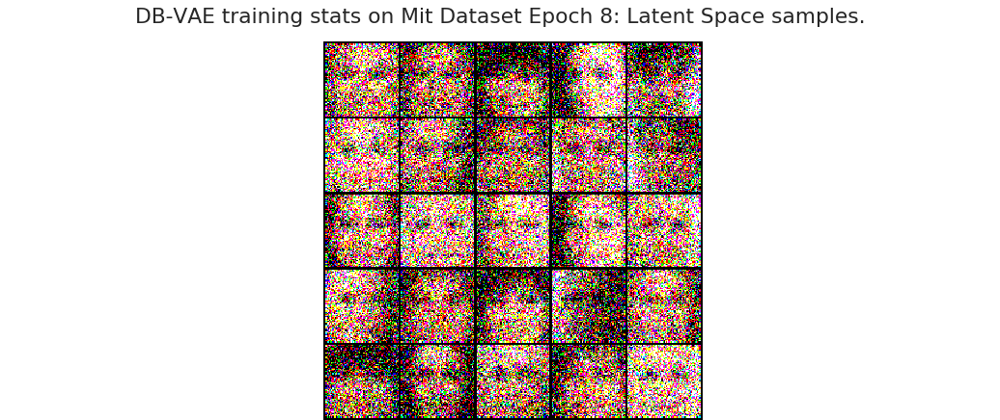

<IPython.core.display.Javascript object>


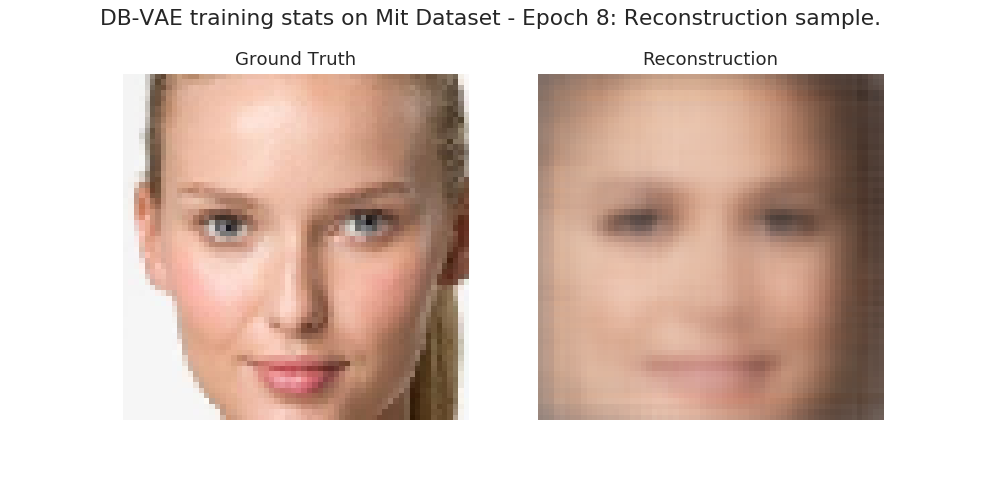



 Epoch 09/10:
   mean accuracy   train/val = 99.75%   / -- 
   mean train loss train/val = 9.32e-01 / -- 
   mean class loss train/val = 2.24e-03 / -- 
   mean KL loss    train/val = 6.90e-02 / -- 
   mean recon loss train/val = 8.61e-01 / -- 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


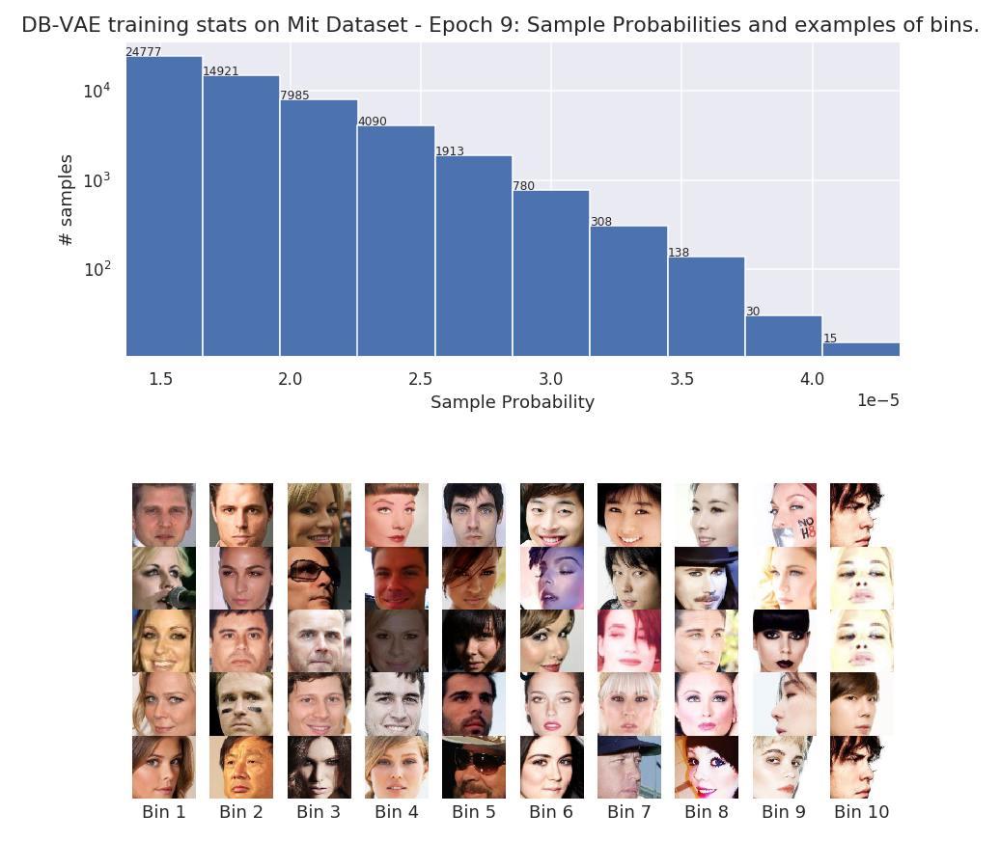

<IPython.core.display.Javascript object>


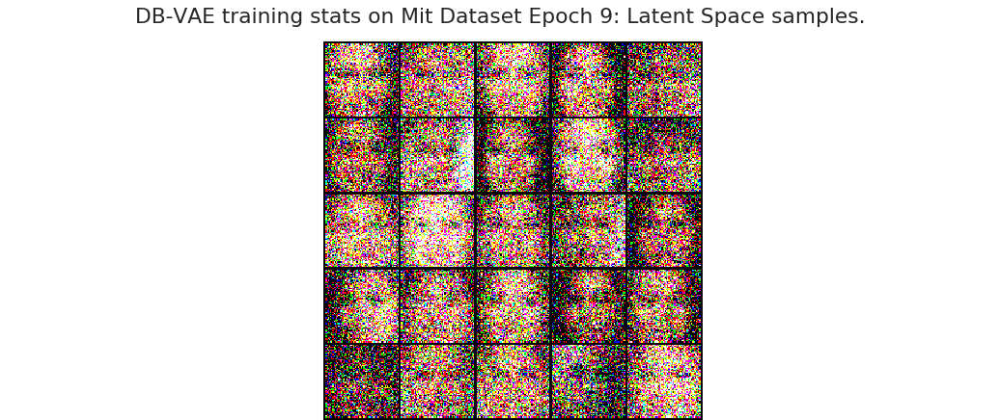

<IPython.core.display.Javascript object>


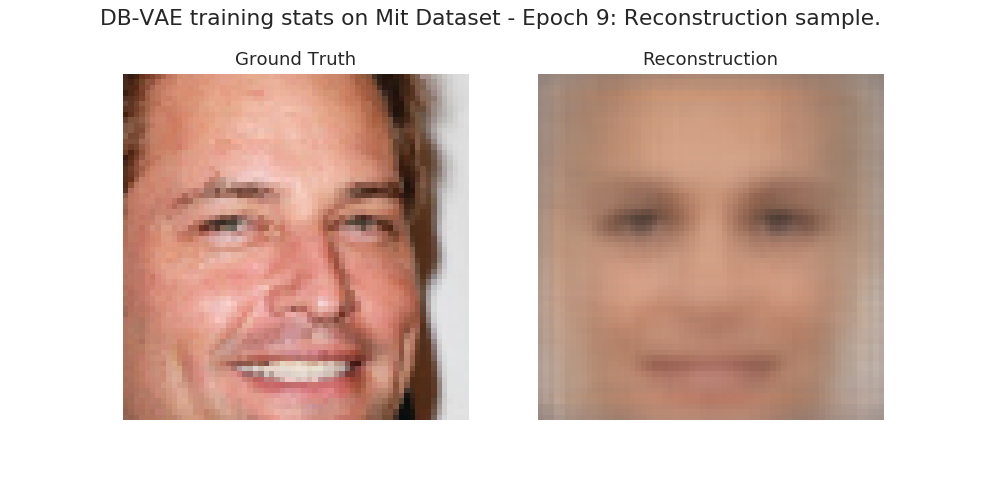



 Epoch 10/10:
   mean accuracy   train/val = 99.77%   / -- 
   mean train loss train/val = 9.33e-01 / -- 
   mean class loss train/val = 2.39e-03 / -- 
   mean KL loss    train/val = 6.85e-02 / -- 
   mean recon loss train/val = 8.62e-01 / -- 

Computing final debiasing sample probabilities..


<IPython.core.display.Javascript object>


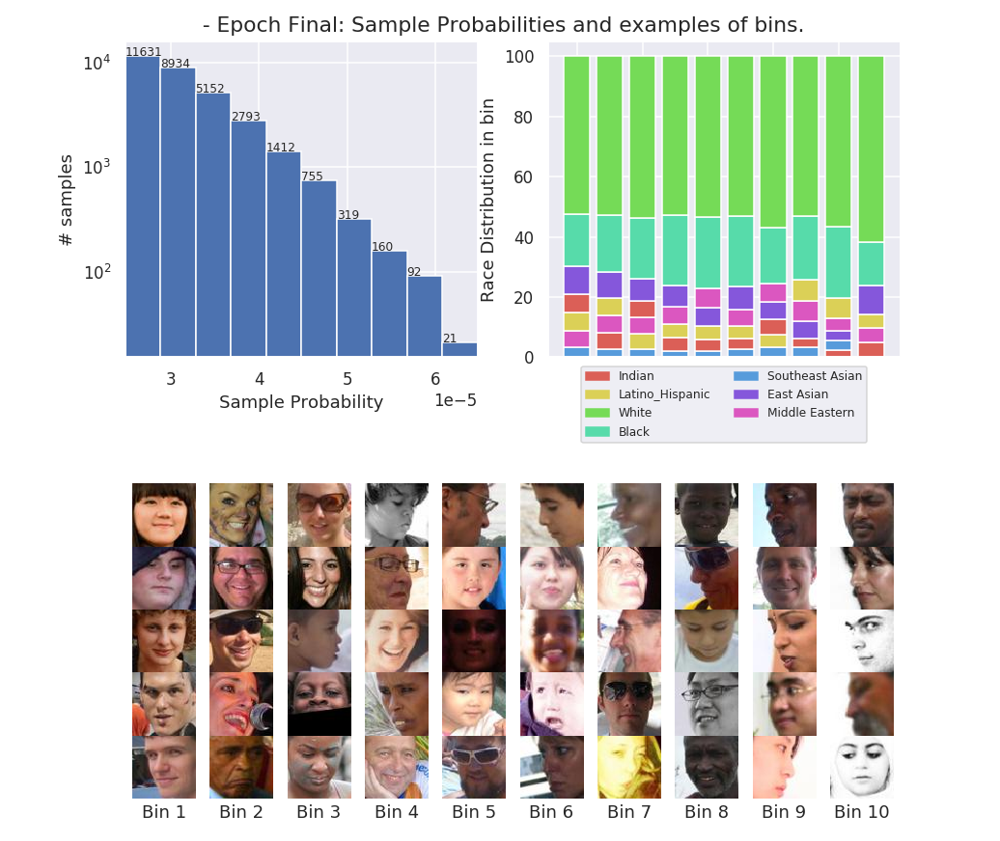

In [22]:
# Construct the end to end vae
mit_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                          kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
mit_db_vae = mit_db_vae.to(mit_db_vae.device)

# Train the VAE
mit_db_vae_train_stats = mit_db_vae.run_training(batch_size=128, num_epochs=10,
                                                 train_dataset=mit_train_loader,
                                                 enable_debiasing=True, smoothing_fac=0.005,
                                                 title='DB-VAE training stats on Mit Dataset')

# Saving the model
# util.save_model(mit_db_vae, "mit_standard_vae")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Construct the end to end vae
mit_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                          kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
mit_db_vae = mit_db_vae.to(mit_db_vae.device)

# Load model from file
mit_db_vae.load_state_dict(torch.load("mit_standard_vae.pt", map_location=mit_db_vae.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of our DB-VAE on the PPB dataset.
For the PPB data, we'll look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 0.92
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 0.91
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.80
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.87


<IPython.core.display.Javascript object>


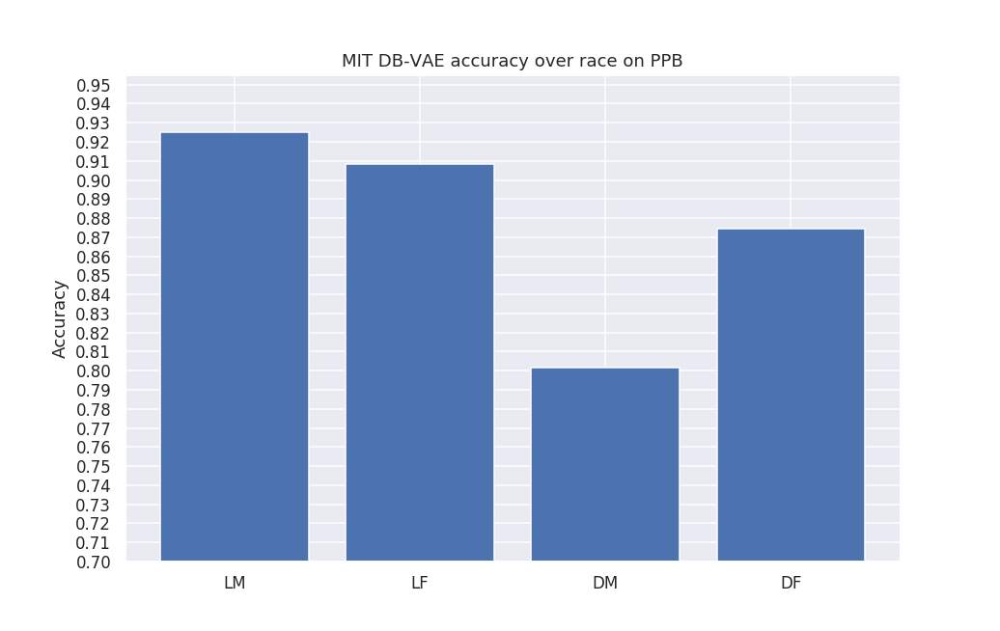

In [23]:
mit_db_vae_ppb_bias_stats = util.evaluate_on_ppb(model=mit_db_vae.encoder,
                                                 test_loader=ppb_test_loader,
                                                 title='MIT DB-VAE accuracy over race on PPB',
                                                 output_index=0)

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the DB-VAE on the OUR dataset. Here we will first look at gender and race independently.

<IPython.core.display.Javascript object>


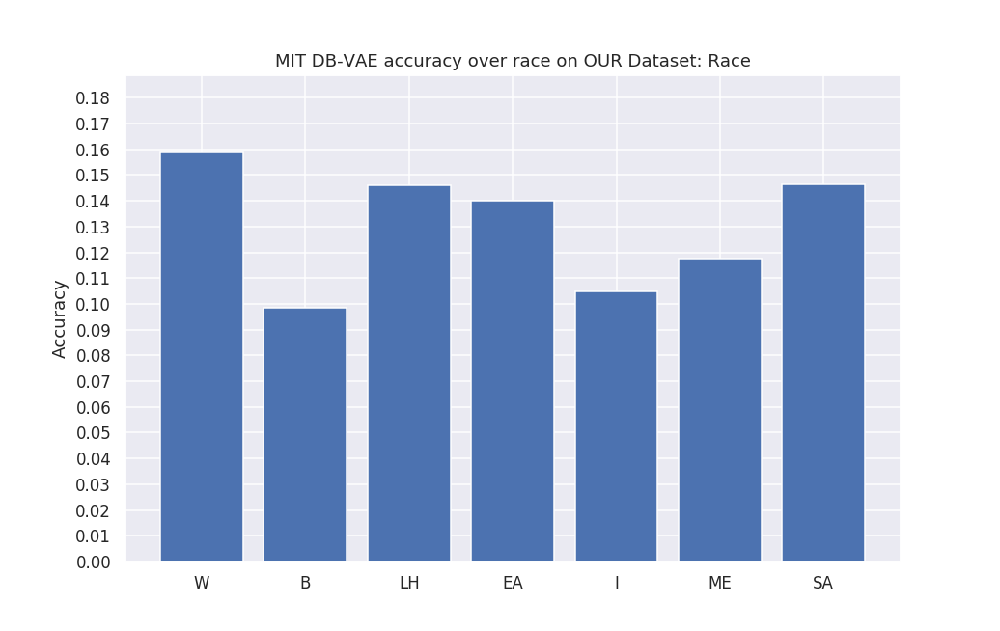

<IPython.core.display.Javascript object>


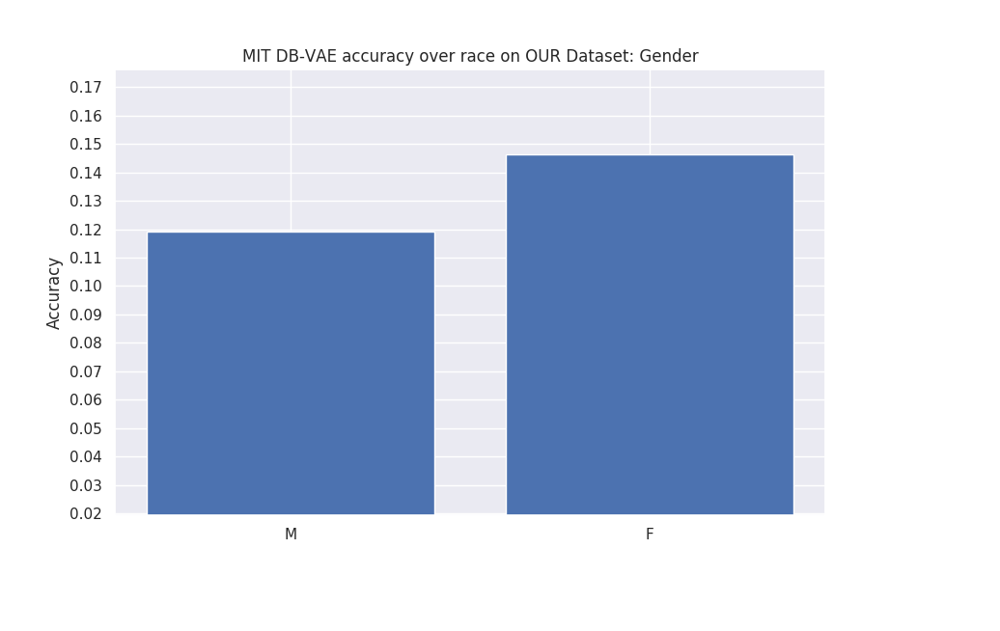

<IPython.core.display.Javascript object>


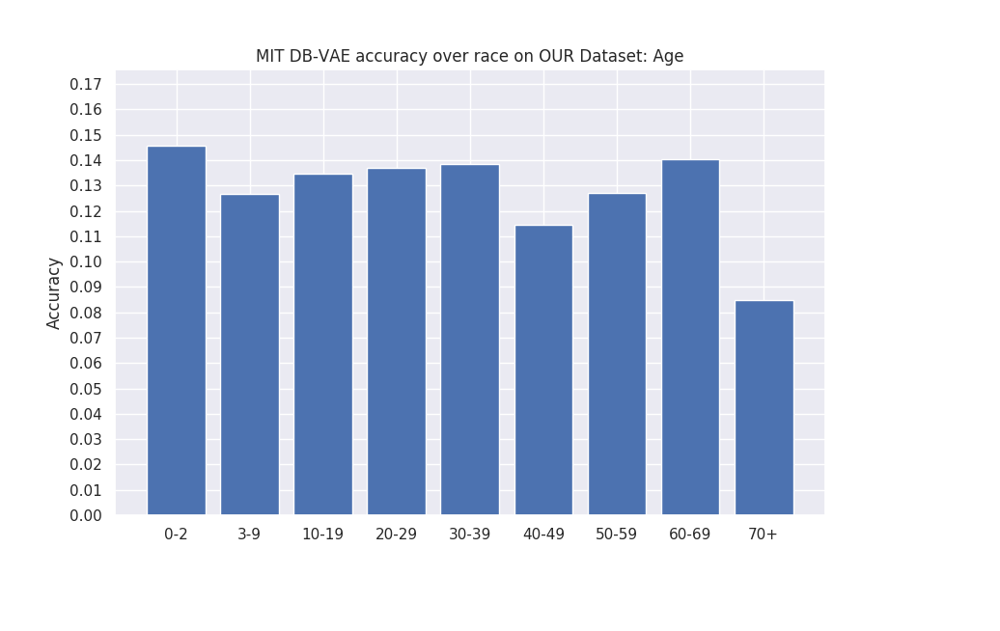

In [24]:
mit_db_vae_our_bias_stats = util.get_bias_stats_on_our_dataset(model=mit_db_vae.encoder,
                                                         test_loader=our_val_loader,                                                         
                                                         title='MIT DB-VAE accuracy over race on OUR Dataset',
                                                         output_index=0)


## 3.2 Training on OUR Dataset

We now train our DB-VAE on OUR training dataset.

<IPython.core.display.Javascript object>


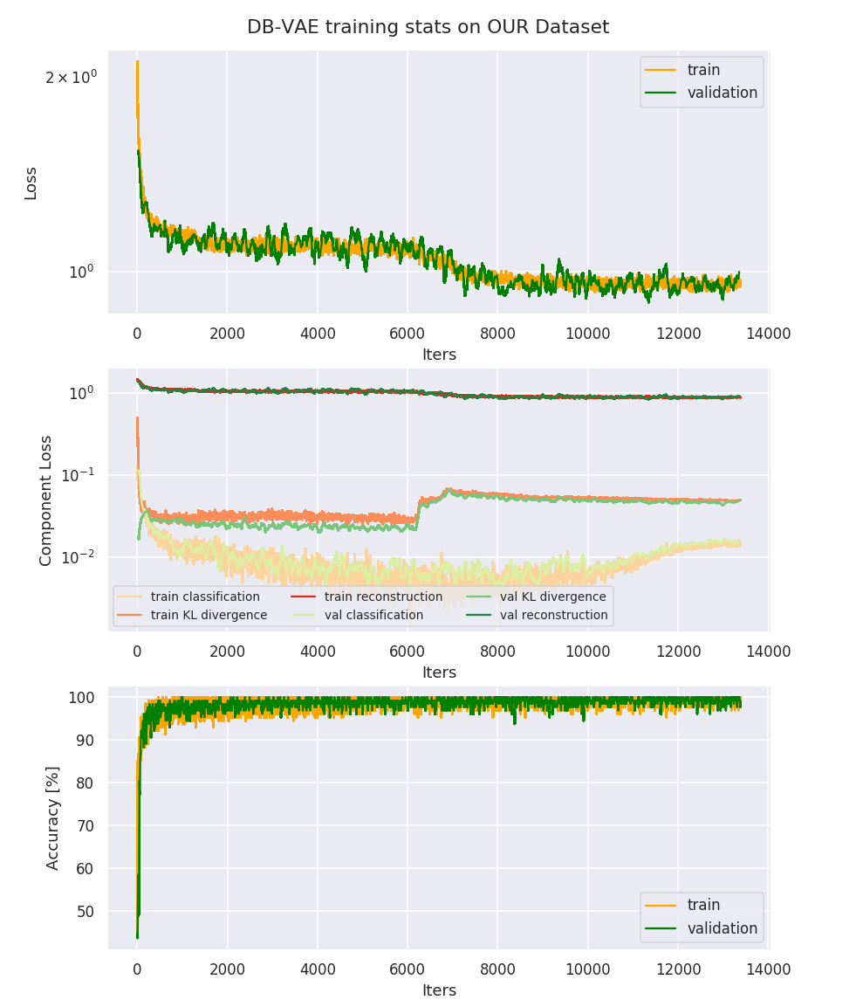

Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


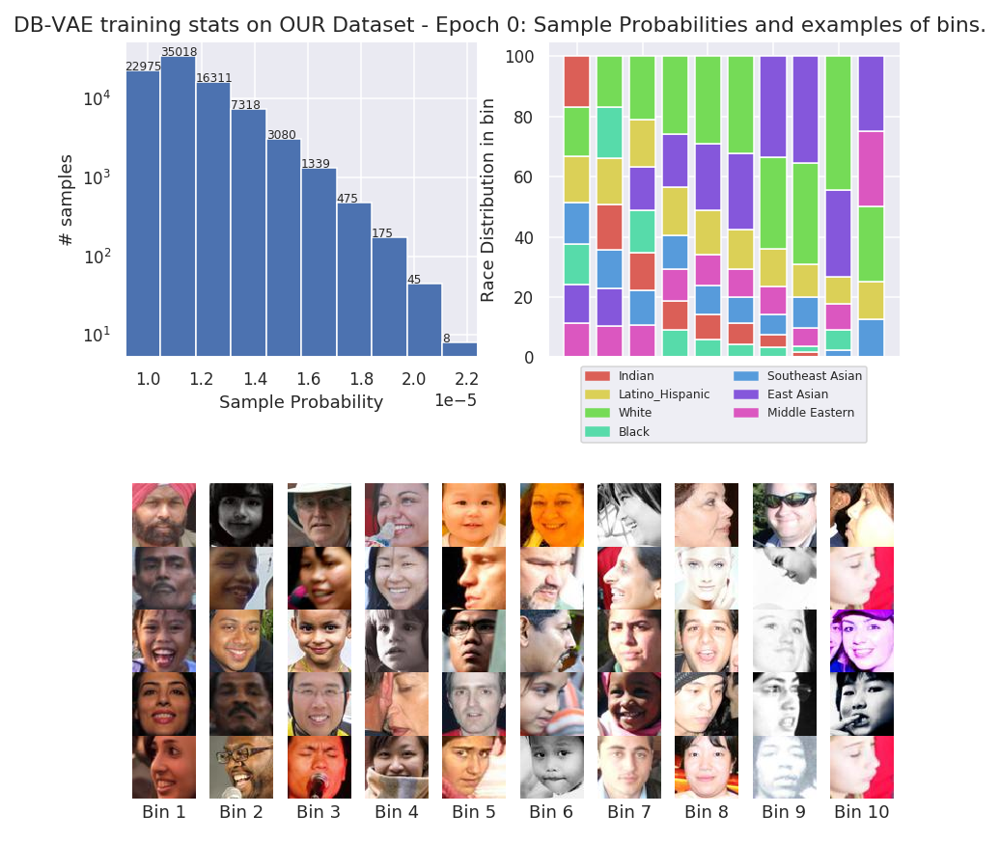

Will be interpolated.


<IPython.core.display.Javascript object>


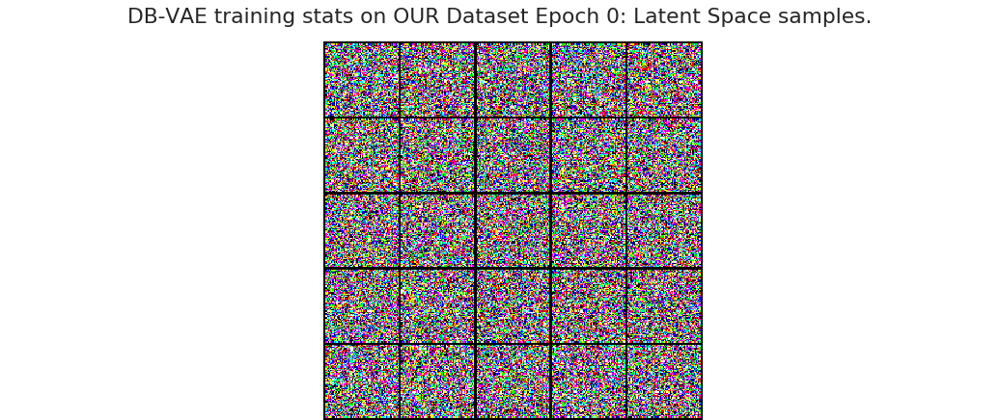

<IPython.core.display.Javascript object>


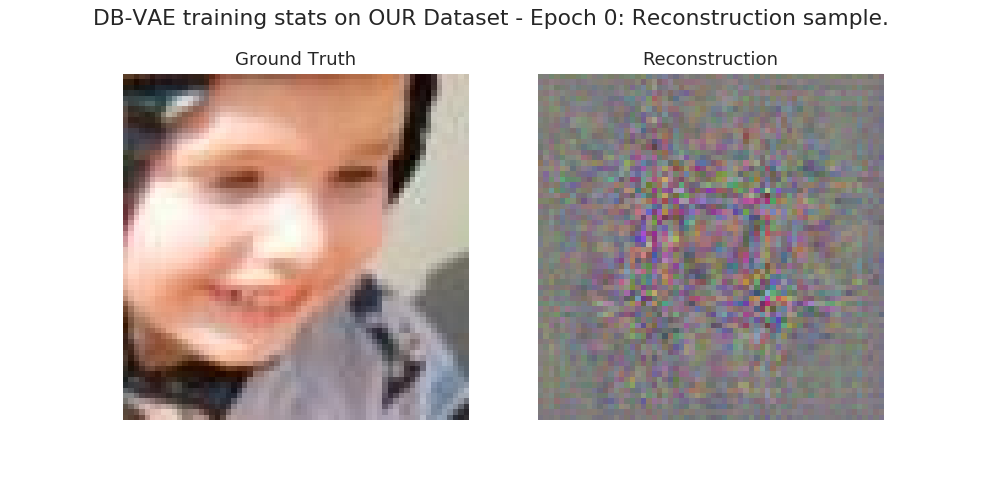



 Epoch 01/10:
   mean accuracy   train/val = 95.92%   / 94.60% 
   mean train loss train/val = 1.20e+00 / 1.17e+00 
   mean class loss train/val = 2.15e-02 / 2.46e-02 
   mean KL loss    train/val = 3.94e-02 / 2.79e-02 
   mean recon loss train/val = 1.14e+00 / 1.12e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


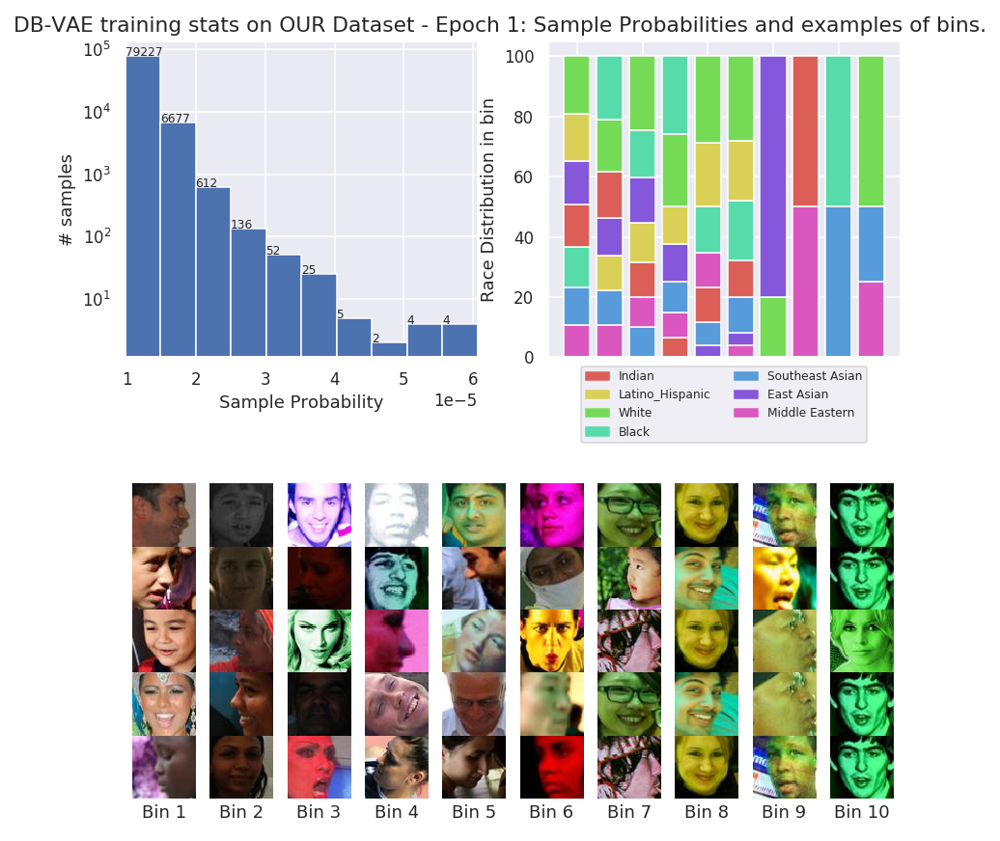

<IPython.core.display.Javascript object>


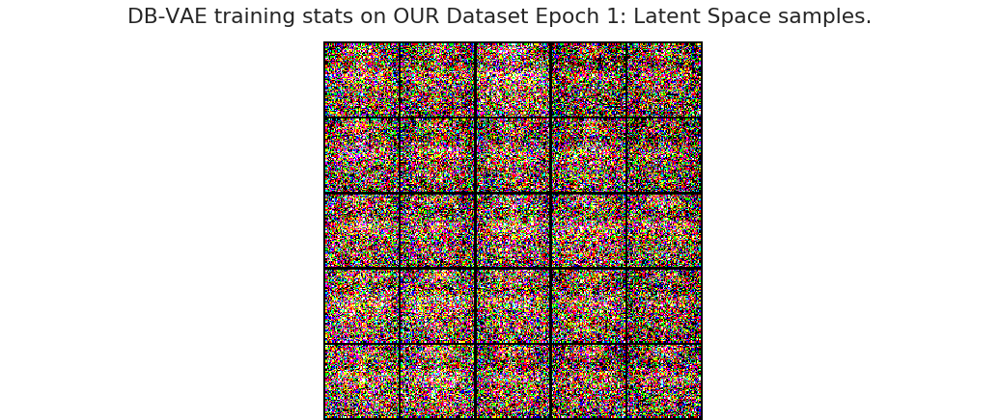

<IPython.core.display.Javascript object>


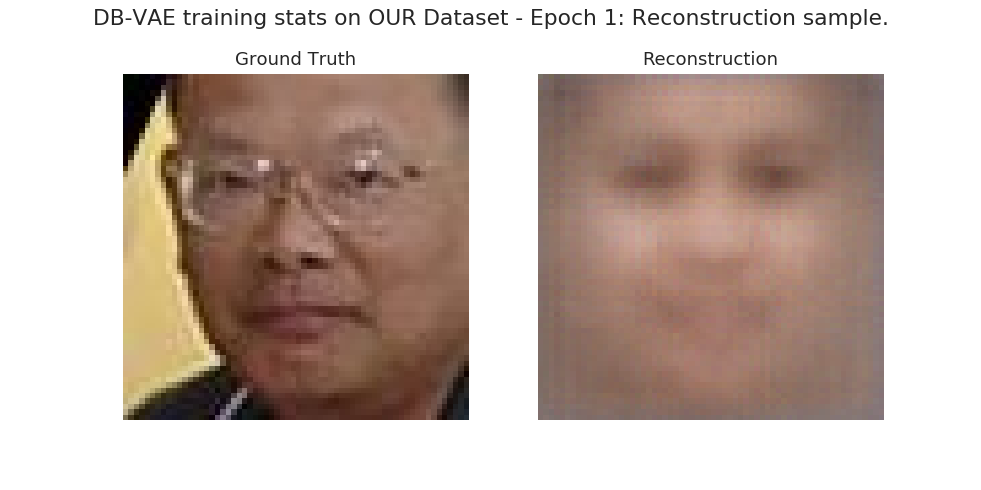



 Epoch 02/10:
   mean accuracy   train/val = 98.15%   / 98.07% 
   mean train loss train/val = 1.10e+00 / 1.11e+00 
   mean class loss train/val = 1.05e-02 / 1.07e-02 
   mean KL loss    train/val = 3.17e-02 / 2.51e-02 
   mean recon loss train/val = 1.06e+00 / 1.07e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


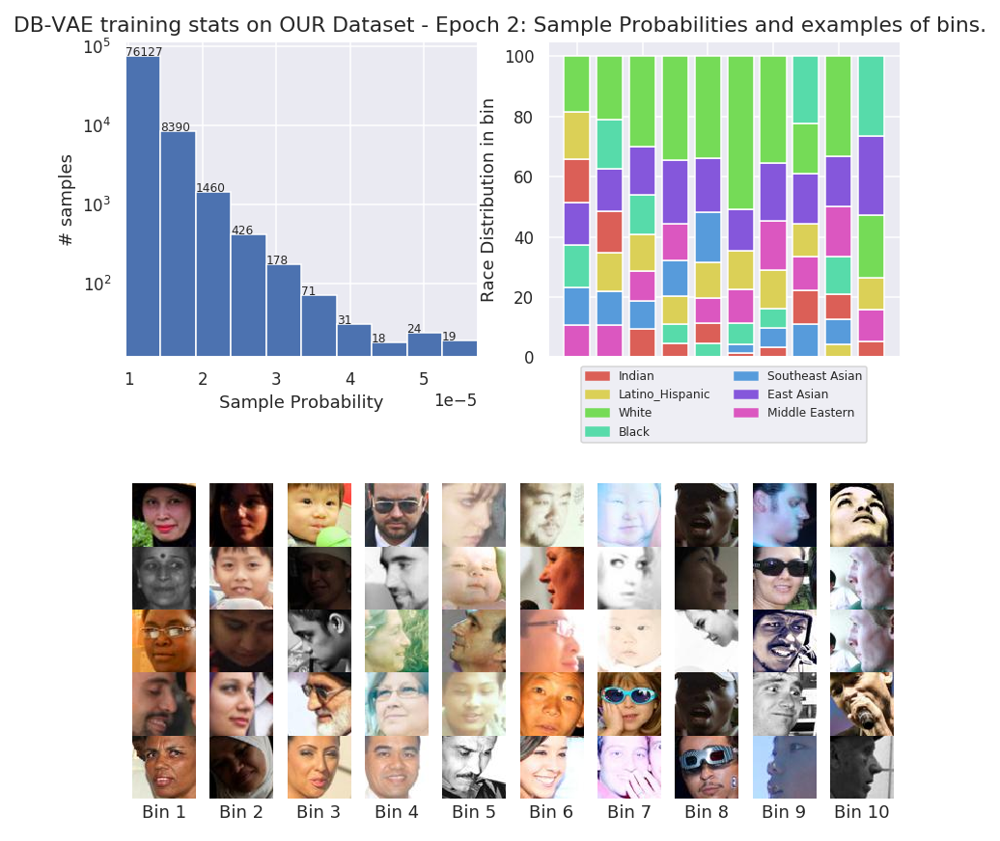

<IPython.core.display.Javascript object>


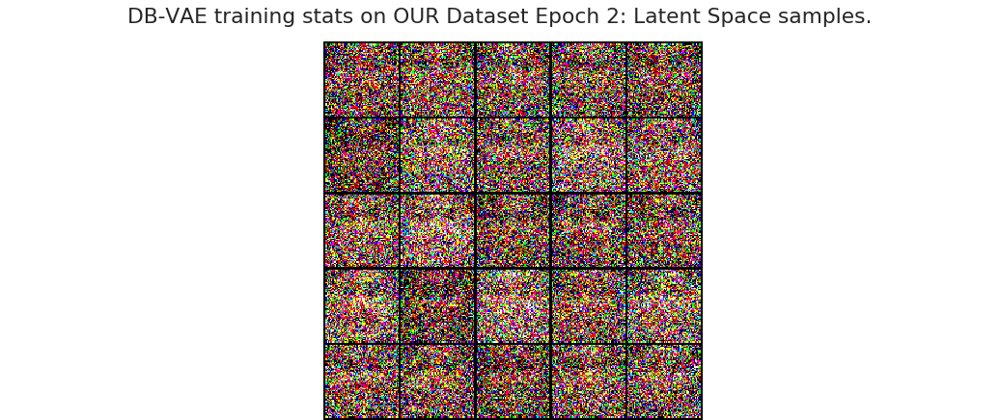

<IPython.core.display.Javascript object>


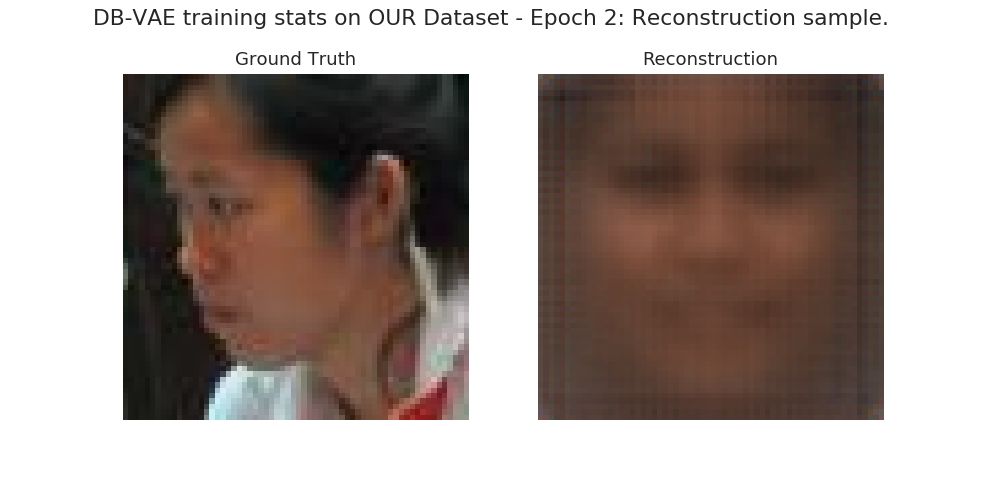



 Epoch 03/10:
   mean accuracy   train/val = 98.68%   / 98.58% 
   mean train loss train/val = 1.10e+00 / 1.10e+00 
   mean class loss train/val = 7.68e-03 / 8.19e-03 
   mean KL loss    train/val = 3.22e-02 / 2.41e-02 
   mean recon loss train/val = 1.06e+00 / 1.07e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


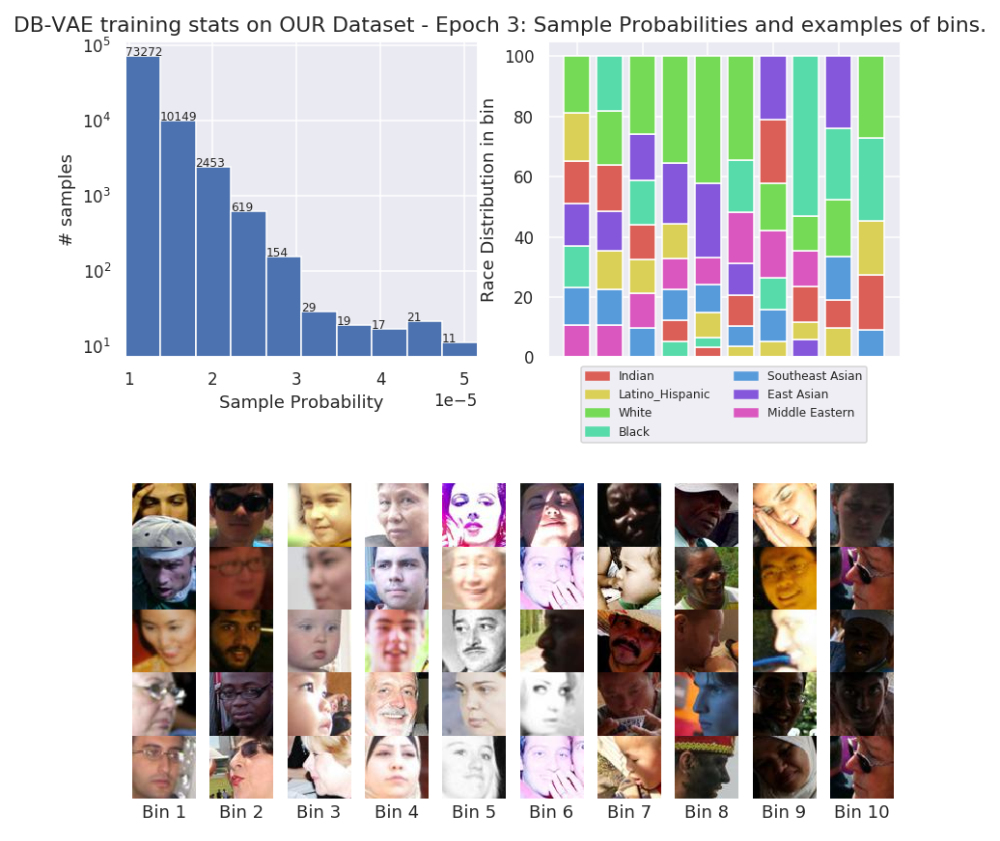

<IPython.core.display.Javascript object>


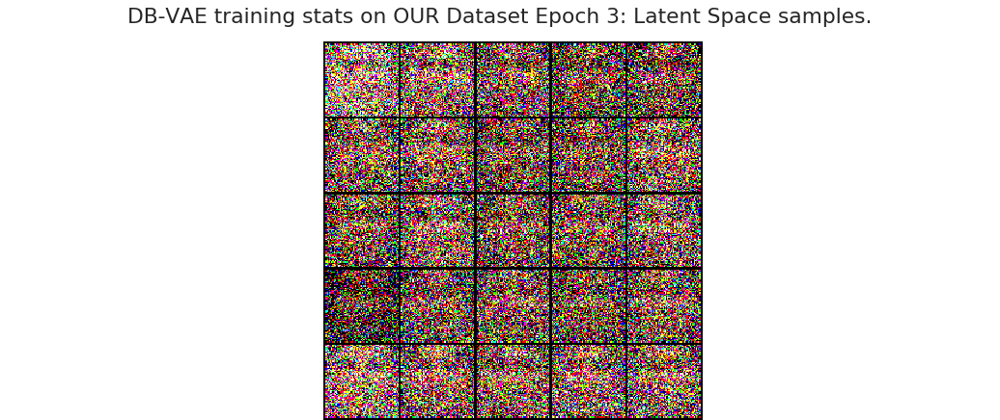

<IPython.core.display.Javascript object>


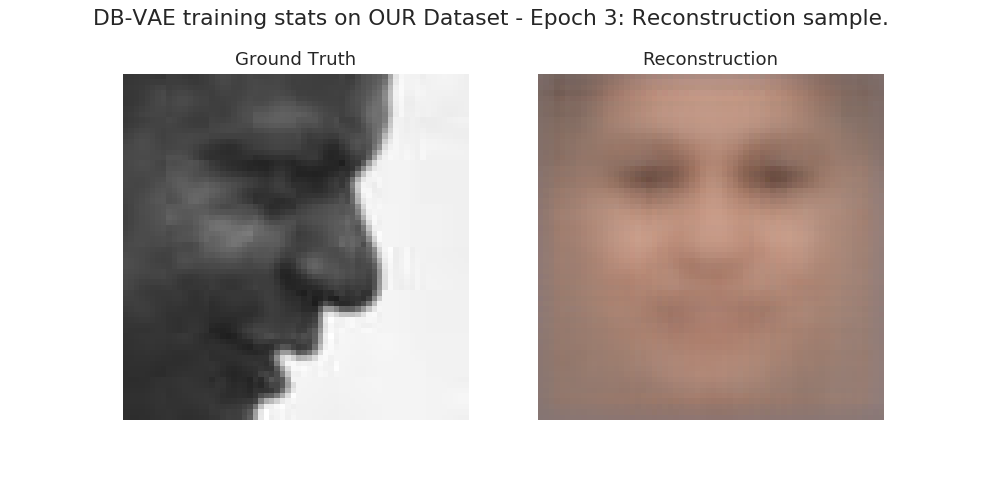



 Epoch 04/10:
   mean accuracy   train/val = 98.95%   / 98.75% 
   mean train loss train/val = 1.09e+00 / 1.10e+00 
   mean class loss train/val = 6.07e-03 / 7.29e-03 
   mean KL loss    train/val = 3.05e-02 / 2.33e-02 
   mean recon loss train/val = 1.05e+00 / 1.07e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


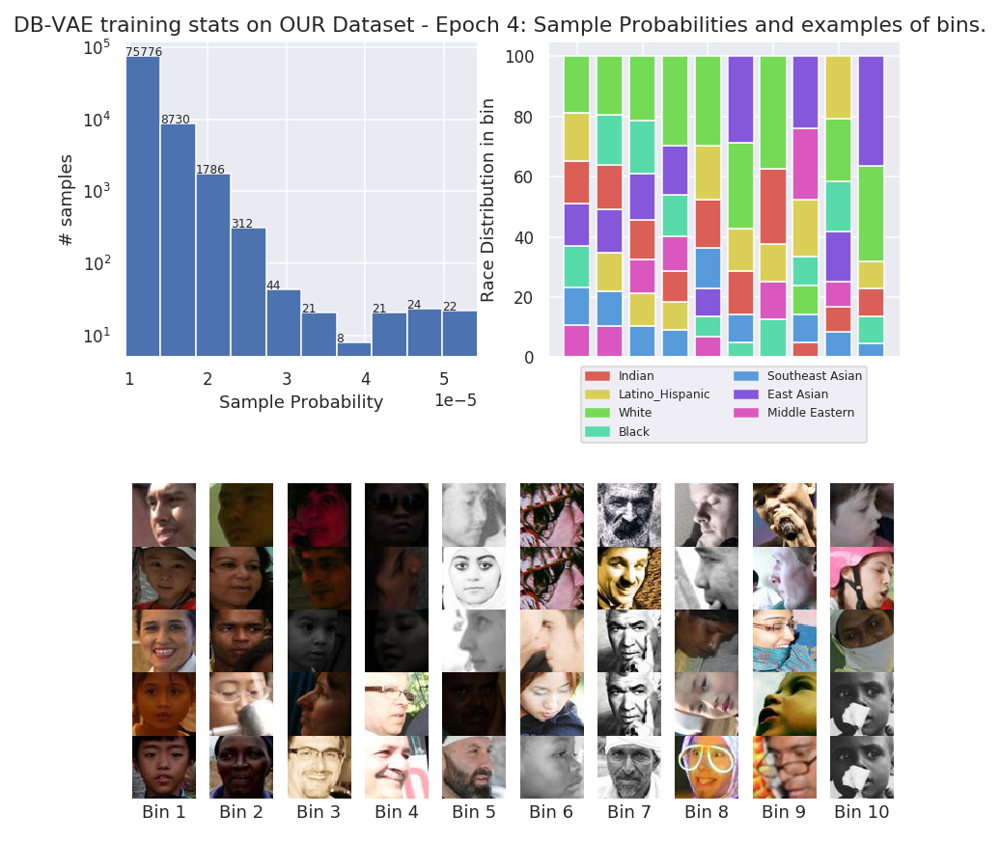

<IPython.core.display.Javascript object>


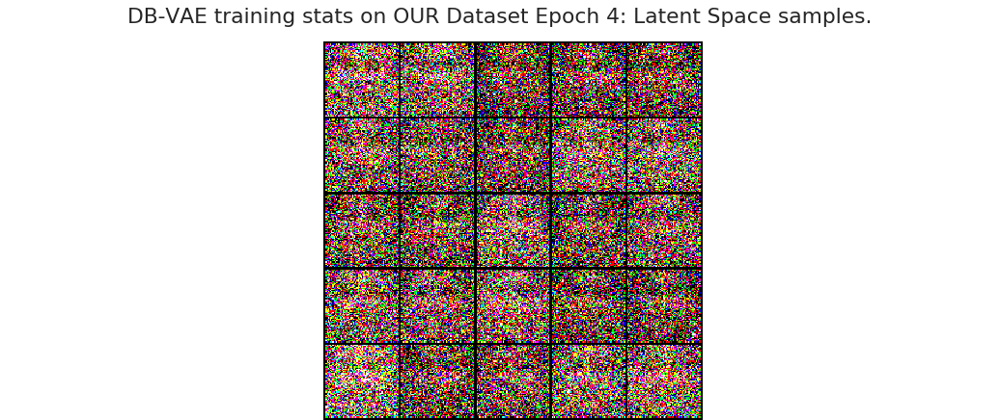

<IPython.core.display.Javascript object>


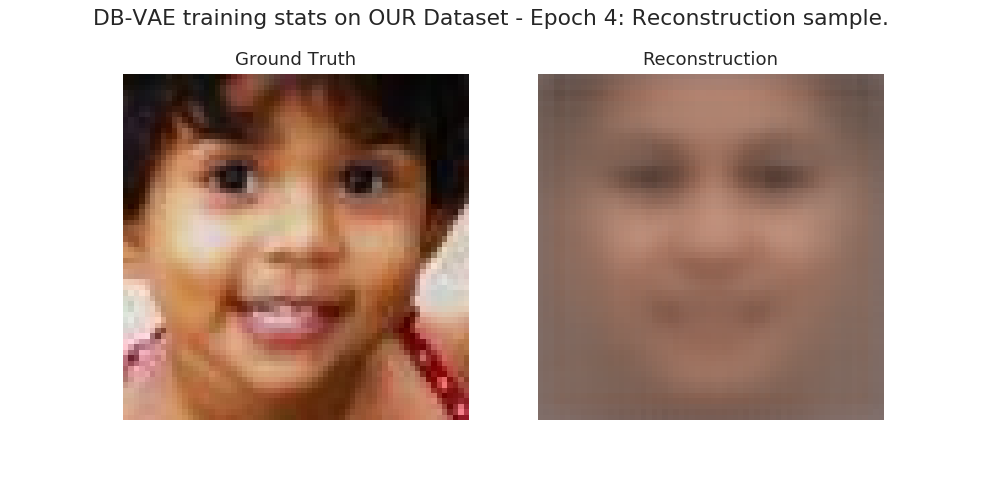



 Epoch 05/10:
   mean accuracy   train/val = 99.09%   / 98.81% 
   mean train loss train/val = 1.07e+00 / 1.08e+00 
   mean class loss train/val = 5.38e-03 / 6.87e-03 
   mean KL loss    train/val = 3.74e-02 / 3.23e-02 
   mean recon loss train/val = 1.03e+00 / 1.04e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


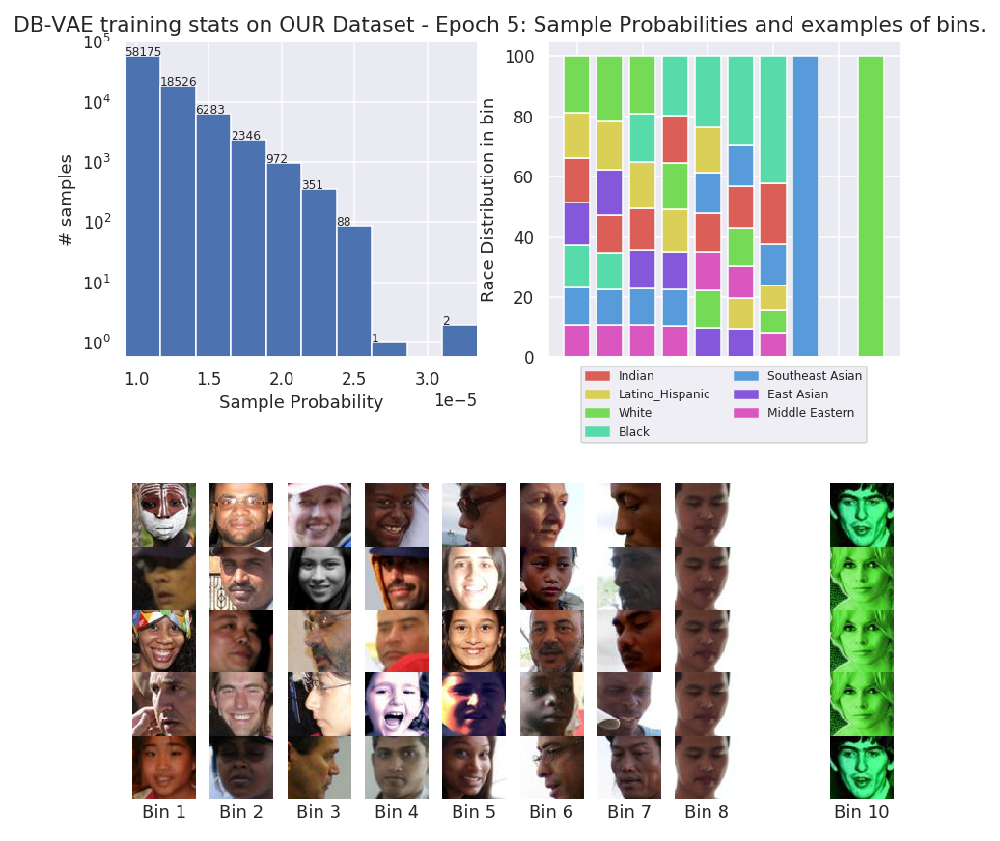

<IPython.core.display.Javascript object>


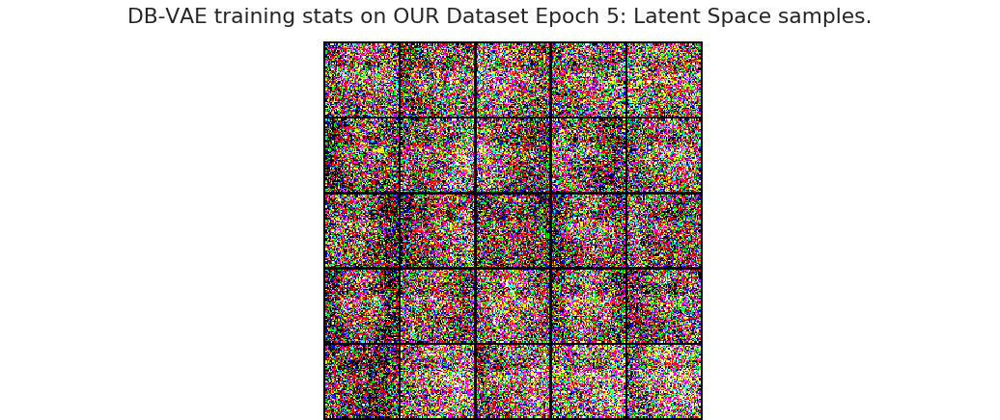

<IPython.core.display.Javascript object>


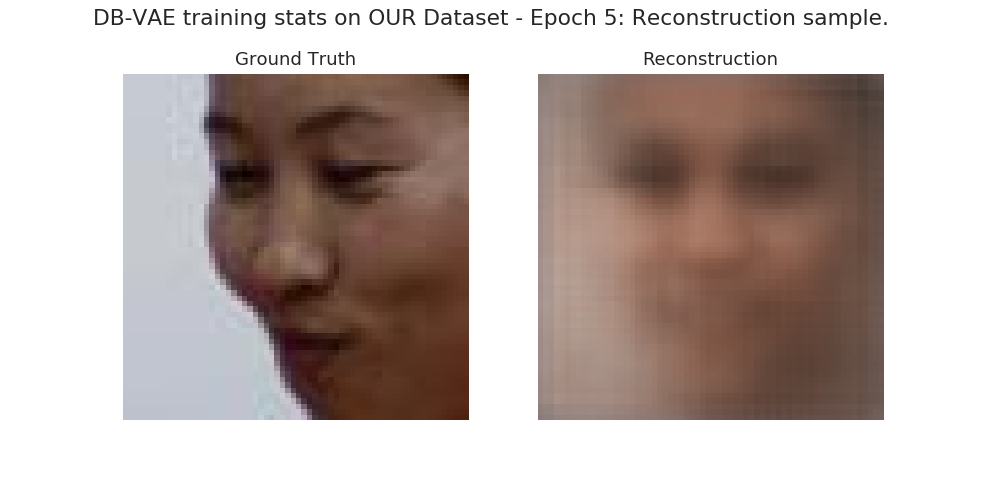



 Epoch 06/10:
   mean accuracy   train/val = 99.27%   / 98.91% 
   mean train loss train/val = 9.93e-01 / 9.88e-01 
   mean class loss train/val = 4.61e-03 / 6.51e-03 
   mean KL loss    train/val = 6.08e-02 / 5.71e-02 
   mean recon loss train/val = 9.28e-01 / 9.24e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


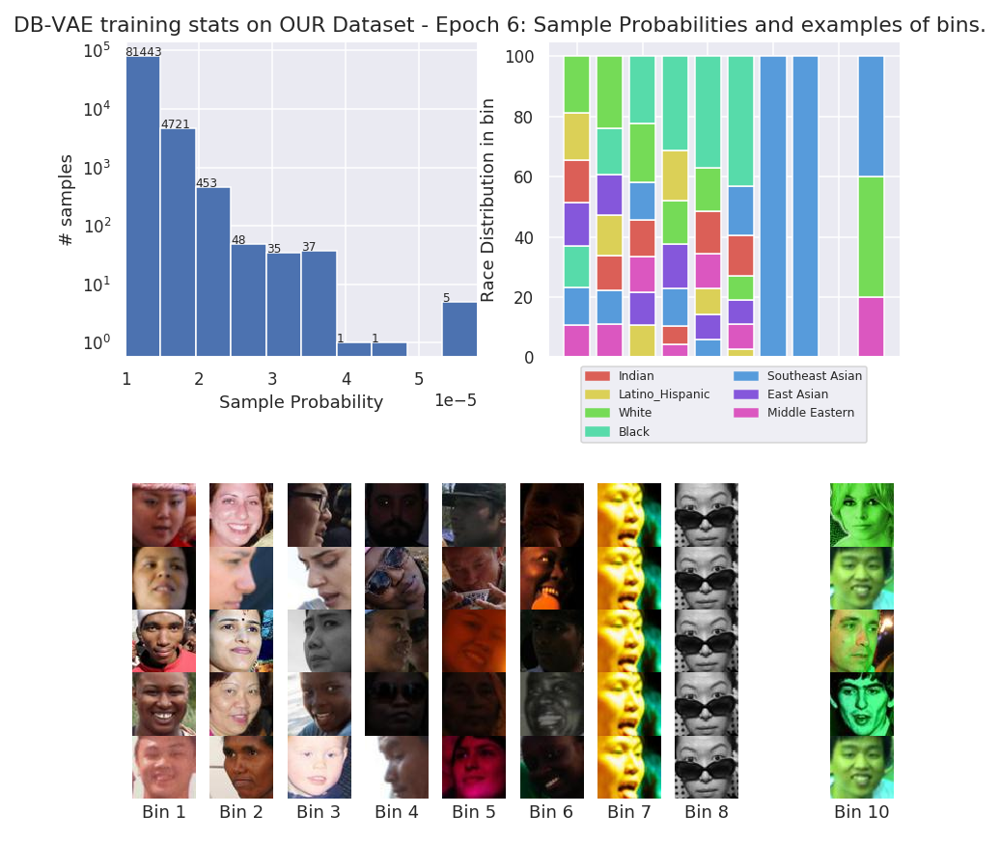

<IPython.core.display.Javascript object>


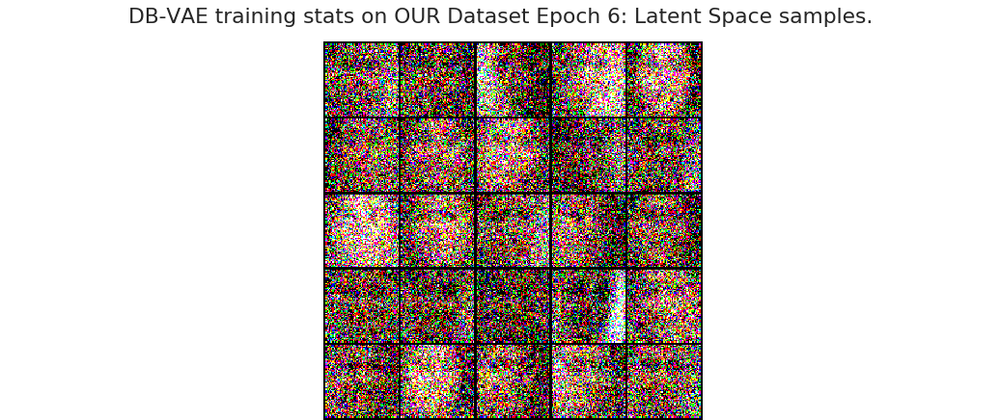

<IPython.core.display.Javascript object>


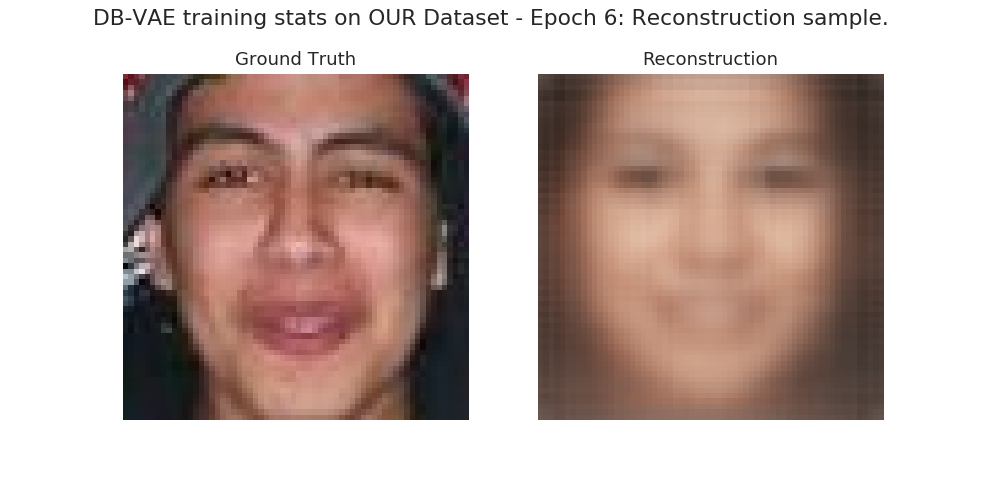



 Epoch 07/10:
   mean accuracy   train/val = 99.23%   / 98.91% 
   mean train loss train/val = 9.66e-01 / 9.59e-01 
   mean class loss train/val = 5.53e-03 / 6.95e-03 
   mean KL loss    train/val = 5.48e-02 / 5.11e-02 
   mean recon loss train/val = 9.05e-01 / 9.01e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


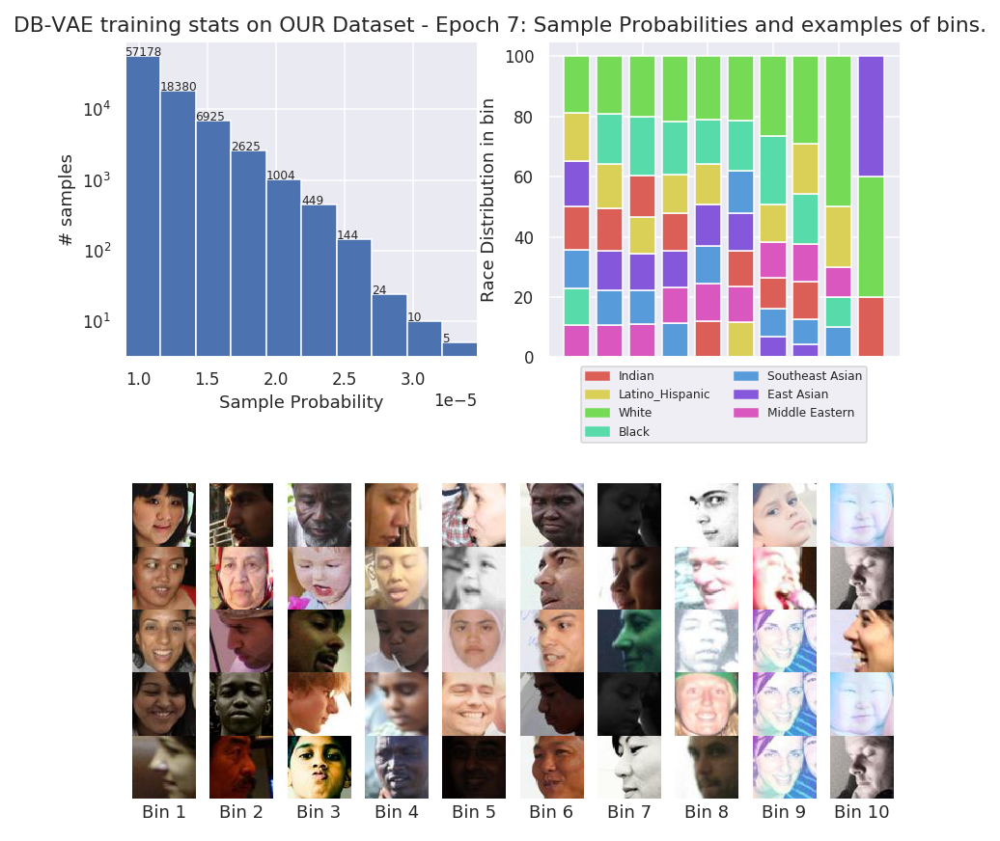

<IPython.core.display.Javascript object>


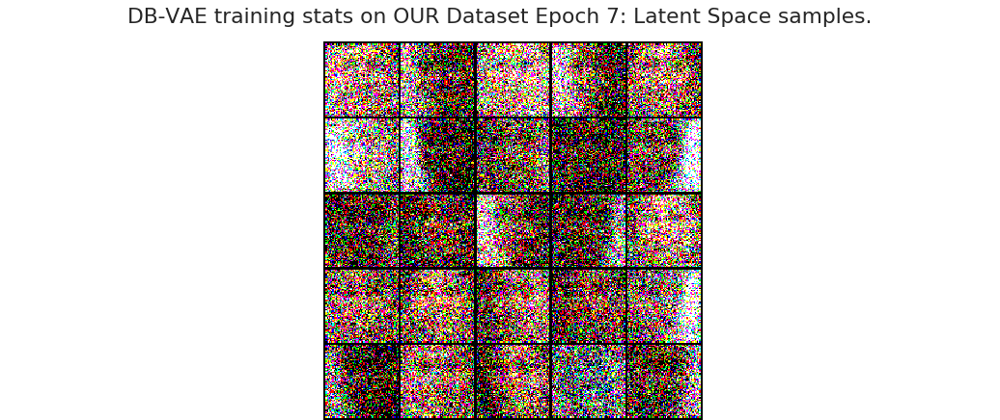

<IPython.core.display.Javascript object>


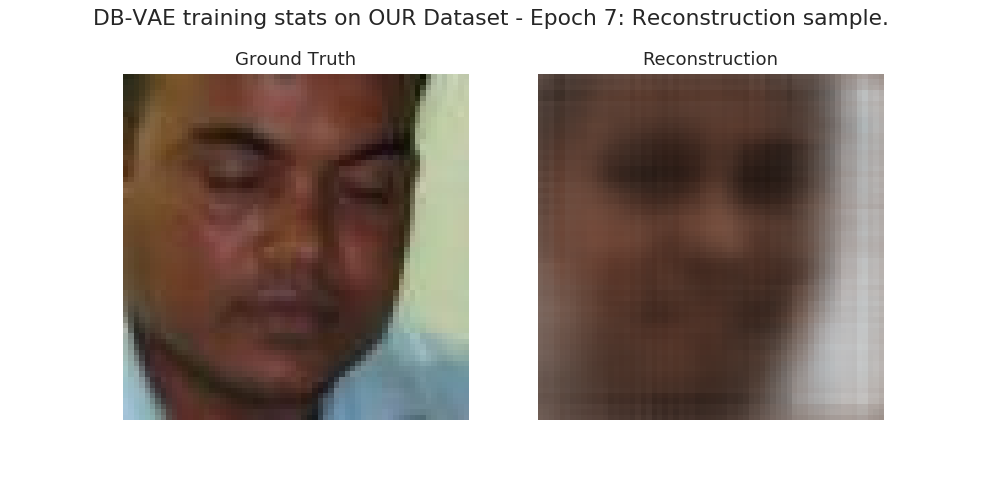



 Epoch 08/10:
   mean accuracy   train/val = 99.29%   / 99.08% 
   mean train loss train/val = 9.59e-01 / 9.54e-01 
   mean class loss train/val = 6.78e-03 / 7.93e-03 
   mean KL loss    train/val = 5.30e-02 / 4.93e-02 
   mean recon loss train/val = 8.99e-01 / 8.96e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


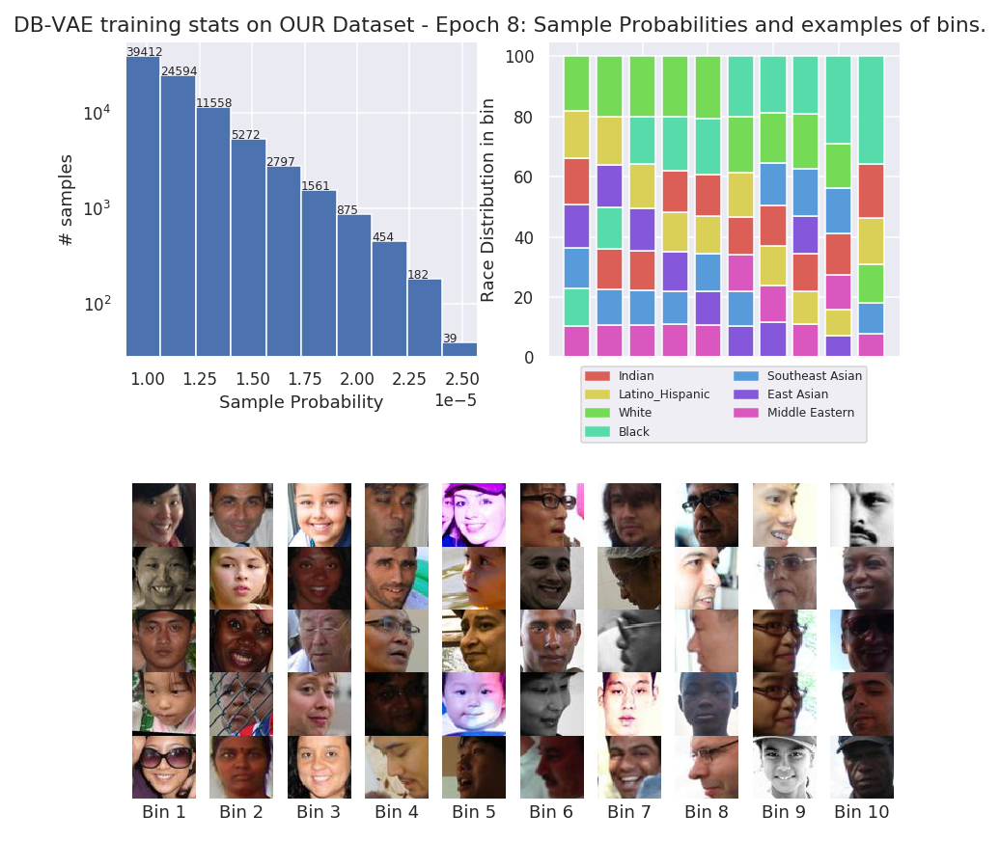

<IPython.core.display.Javascript object>


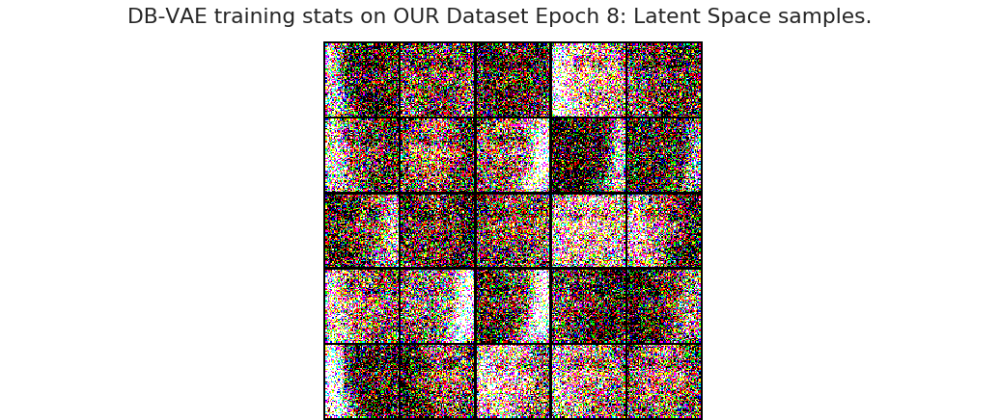

<IPython.core.display.Javascript object>


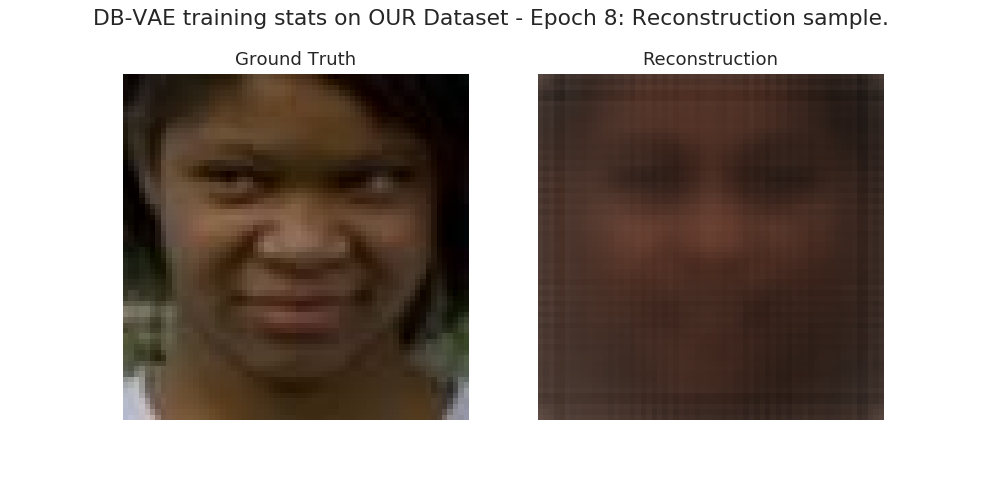



 Epoch 09/10:
   mean accuracy   train/val = 99.42%   / 99.24% 
   mean train loss train/val = 9.59e-01 / 9.57e-01 
   mean class loss train/val = 1.05e-02 / 1.17e-02 
   mean KL loss    train/val = 5.12e-02 / 4.78e-02 
   mean recon loss train/val = 8.97e-01 / 8.97e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


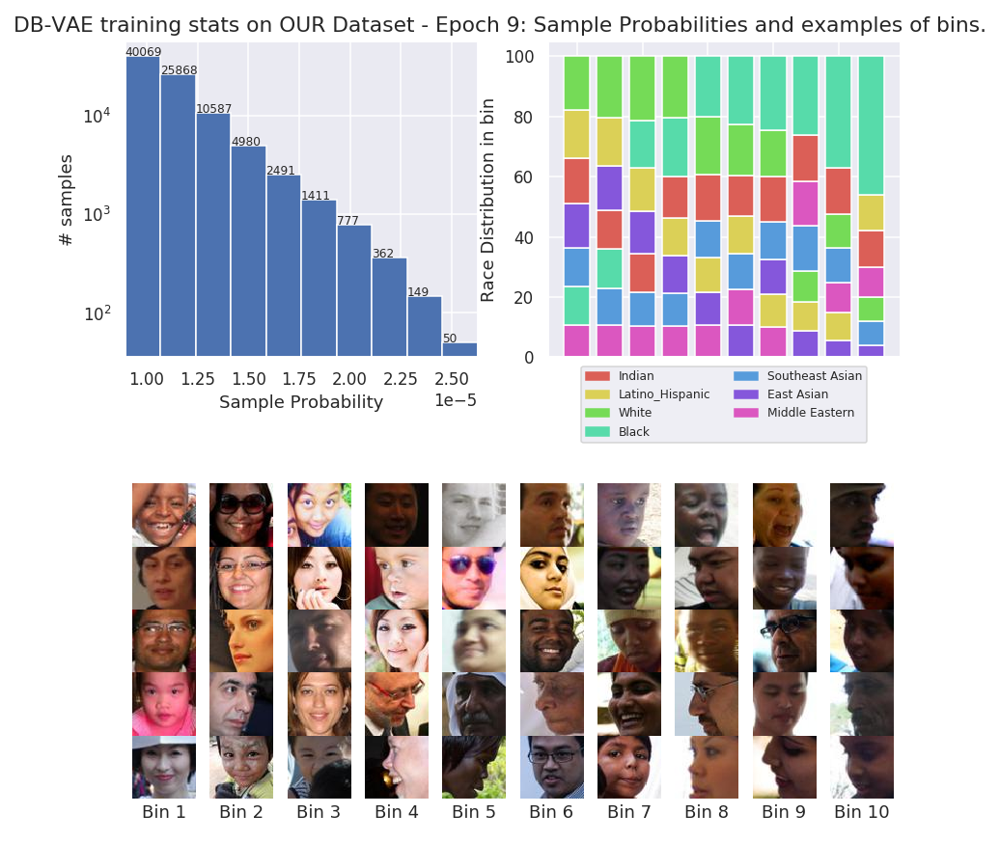

<IPython.core.display.Javascript object>


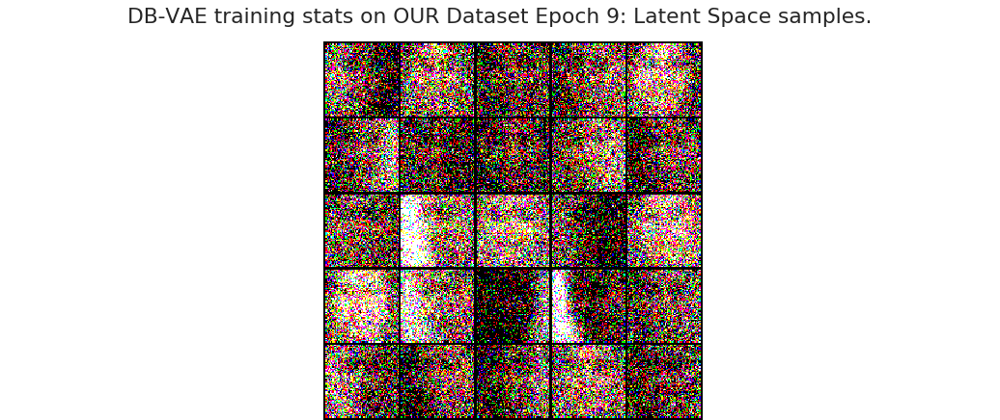

<IPython.core.display.Javascript object>


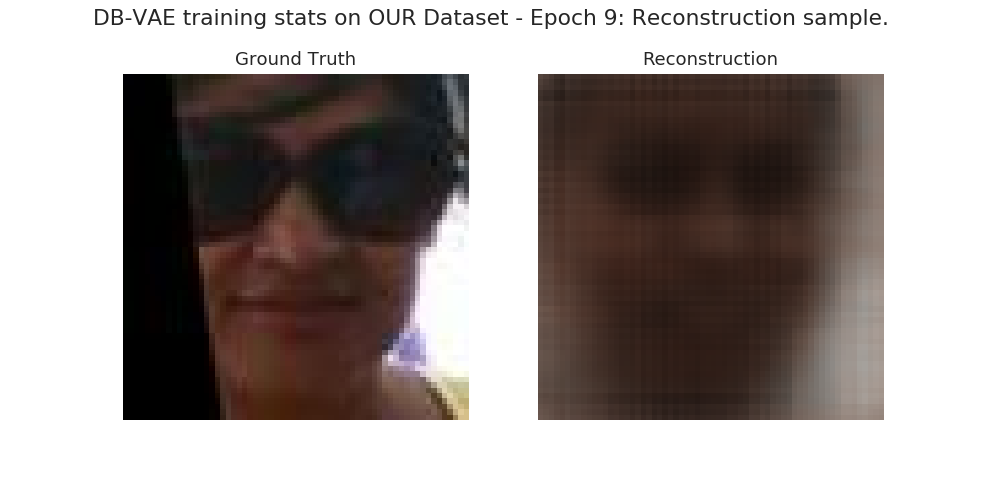



 Epoch 10/10:
   mean accuracy   train/val = 99.41%   / 99.16% 
   mean train loss train/val = 9.55e-01 / 9.57e-01 
   mean class loss train/val = 1.42e-02 / 1.52e-02 
   mean KL loss    train/val = 4.99e-02 / 4.68e-02 
   mean recon loss train/val = 8.91e-01 / 8.95e-01 

Computing final debiasing sample probabilities..


In [25]:
# Construct the end to end vae
our_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                          kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
our_db_vae = our_db_vae.to(our_db_vae.device)

# Train the VAE
our_db_vae_train_stats = our_db_vae.run_training(batch_size=128, num_epochs=10,
                                                 train_dataset=our_train_loader,
                                                 enable_debiasing=True, smoothing_fac=0.005,
                                                 title='DB-VAE training stats on OUR Dataset',
                                                 validation_dataset=our_val_loader)
# Saving the model
#util.save_model(our_db_vae, "OUR_standard_vae")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Construct the end to end vae
our_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                          kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
our_db_vae = our_db_vae.to(our_db_vae.device)

# Load model from file
our_db_vae.load_state_dict(torch.load("OUR_standard_vae.pt", map_location=our_db_vae.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of our DB-VAE on the PPB dataset.
For the PPB data, we'll look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 1.00
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 1.00
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.94
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.94


<IPython.core.display.Javascript object>


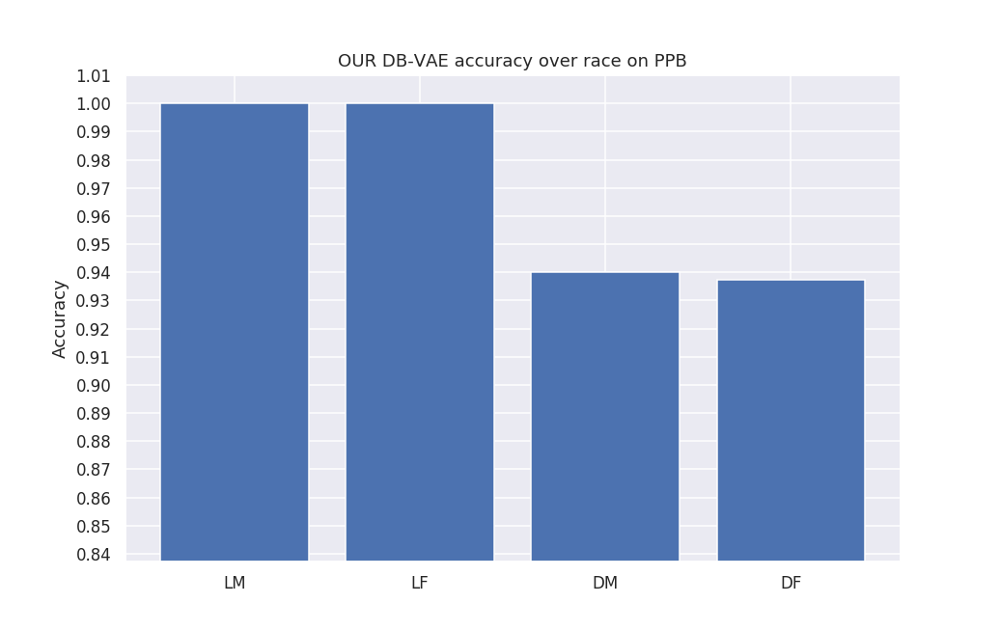

In [26]:
our_db_vae_ppb_bias_stats = util.evaluate_on_ppb(model=our_db_vae.encoder,
                                                 test_loader=ppb_test_loader,
                                                 title='OUR DB-VAE accuracy over race on PPB',
                                                 output_index=0)

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the DB-VAE on the OUR dataset. Here we will first look at gender and race independently.

<IPython.core.display.Javascript object>


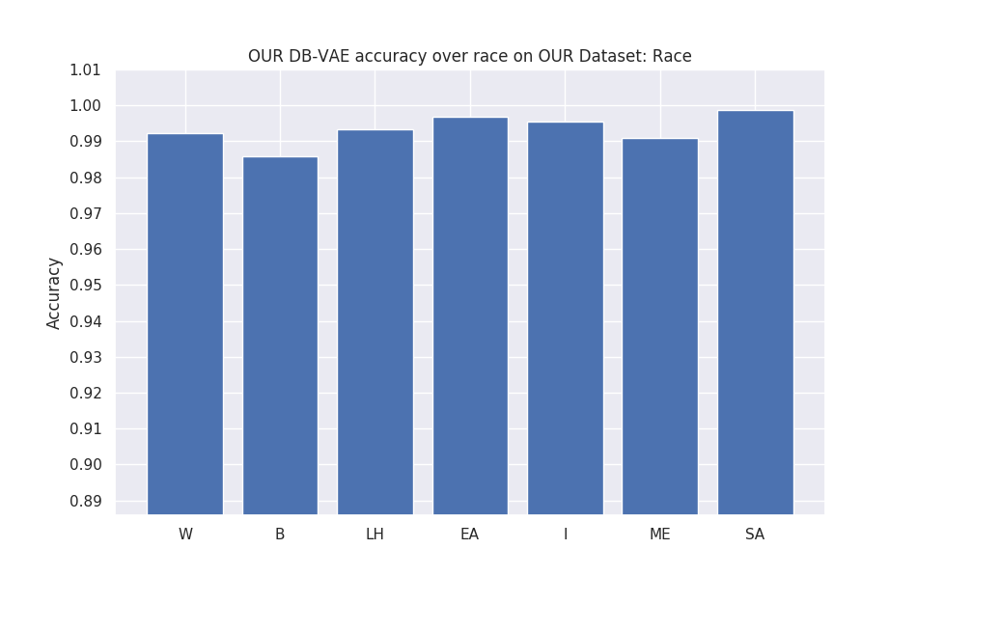

<IPython.core.display.Javascript object>


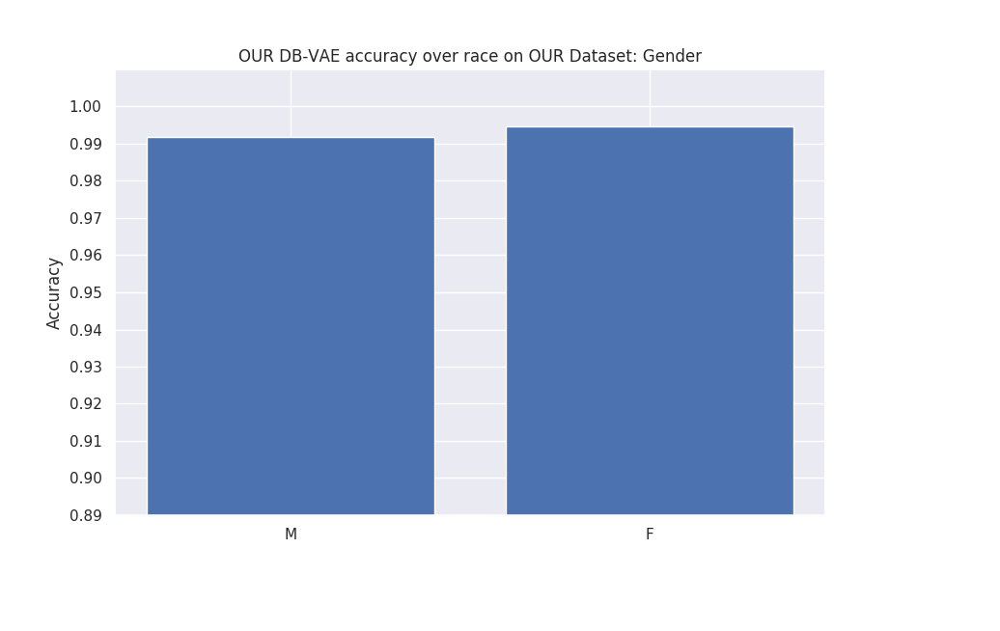

<IPython.core.display.Javascript object>


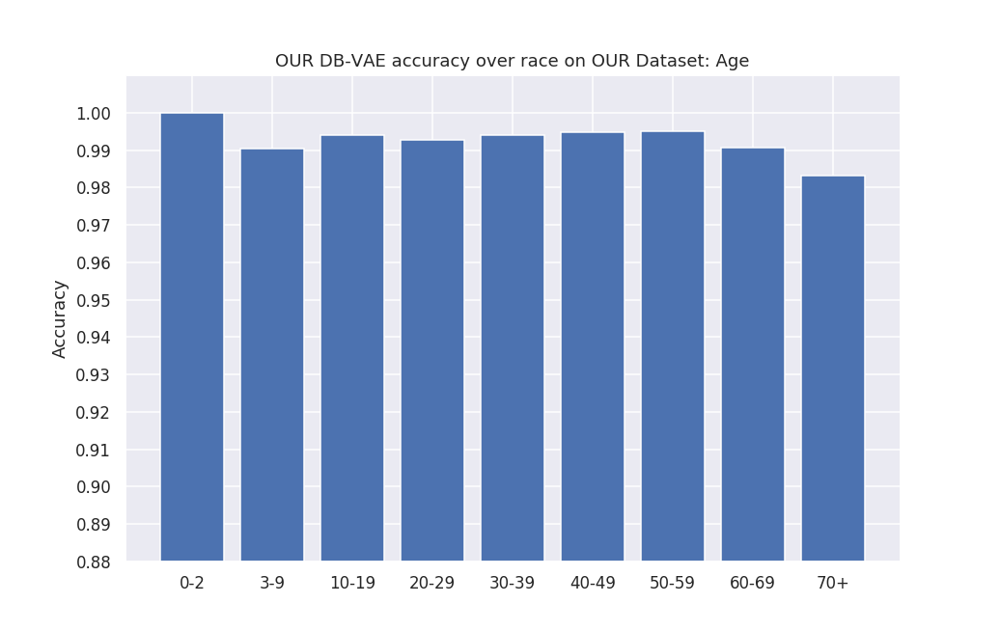

In [27]:
our_db_vae_our_bias_stats = util.get_bias_stats_on_our_dataset(model=our_db_vae.encoder,
                                                         test_loader=our_val_loader,                                                         
                                                         title='OUR DB-VAE accuracy over race on OUR Dataset',
                                                         output_index=0)

## 3.3 Training on OUR-B dataset: simulating MIT dataset

We now train the DB-VAE on OUR-B training dataset which has a similar distribution to MIT dataset for three epochs. Here we can also use our validation set for checking overfit.

<IPython.core.display.Javascript object>


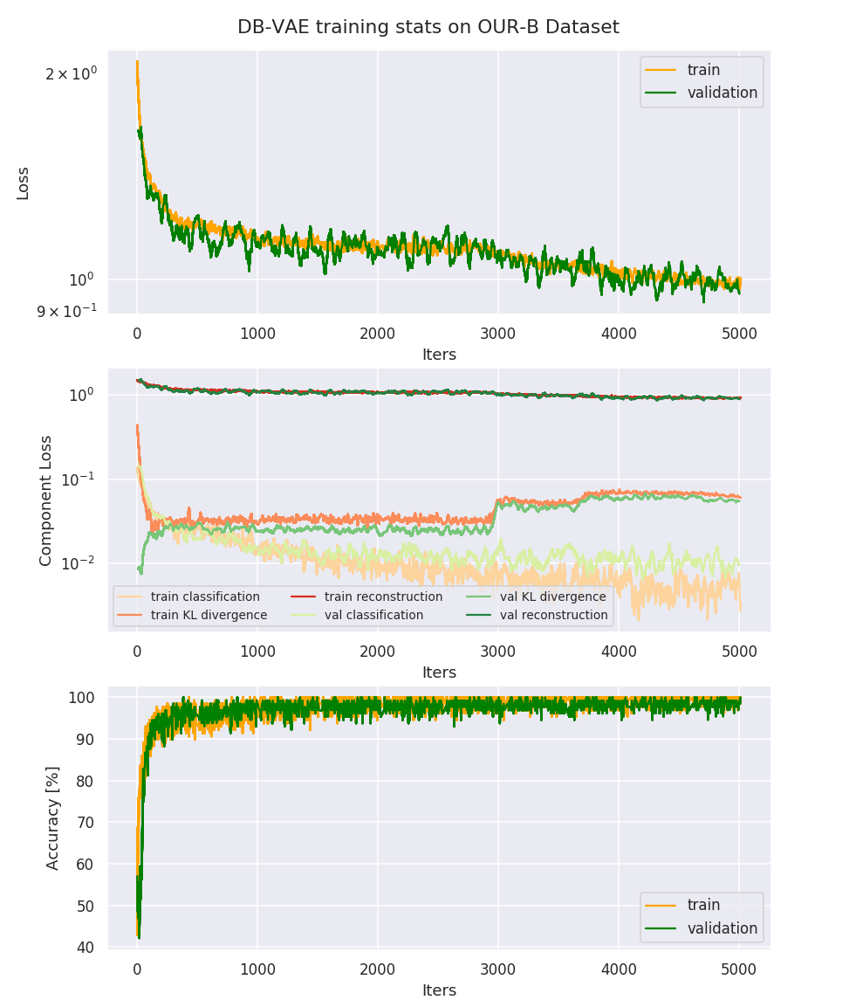

Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


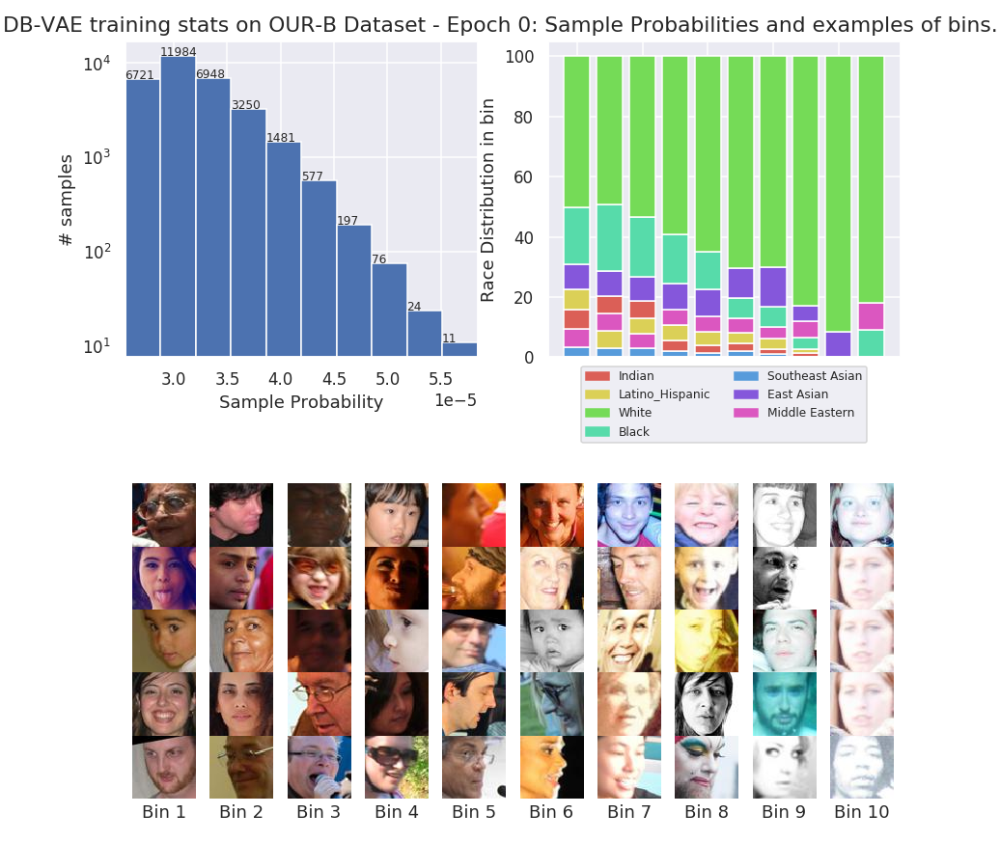

Will be interpolated.


<IPython.core.display.Javascript object>


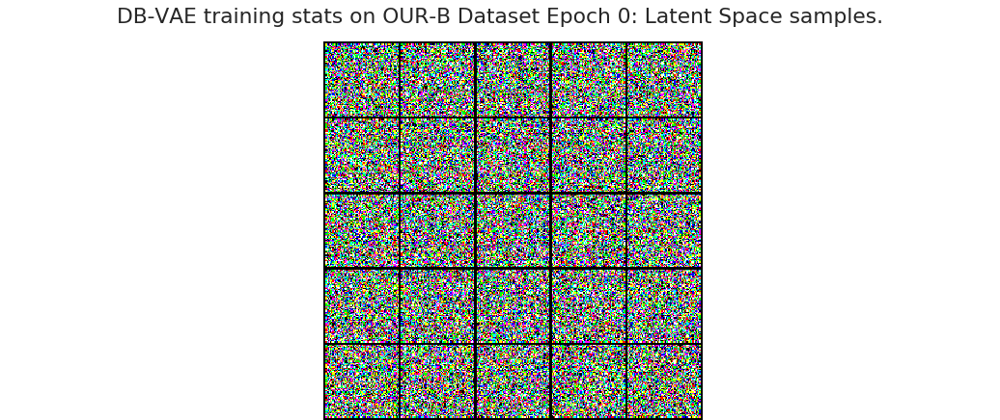

<IPython.core.display.Javascript object>


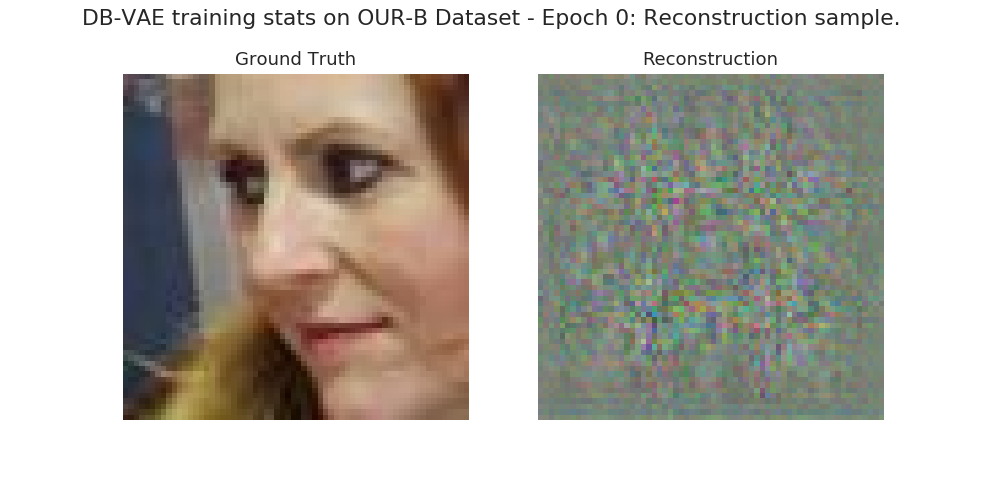



 Epoch 01/10:
   mean accuracy   train/val = 91.95%   / 89.63% 
   mean train loss train/val = 1.34e+00 / 1.29e+00 
   mean class loss train/val = 3.99e-02 / 4.46e-02 
   mean KL loss    train/val = 5.11e-02 / 2.26e-02 
   mean recon loss train/val = 1.25e+00 / 1.22e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


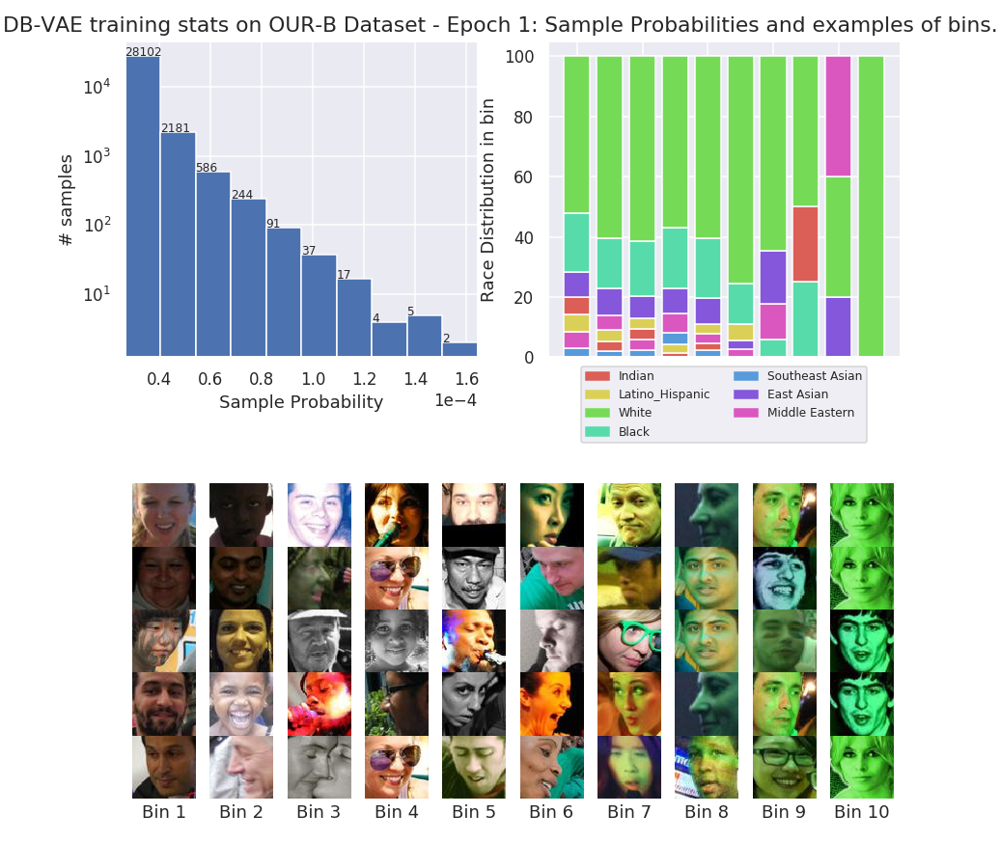

<IPython.core.display.Javascript object>


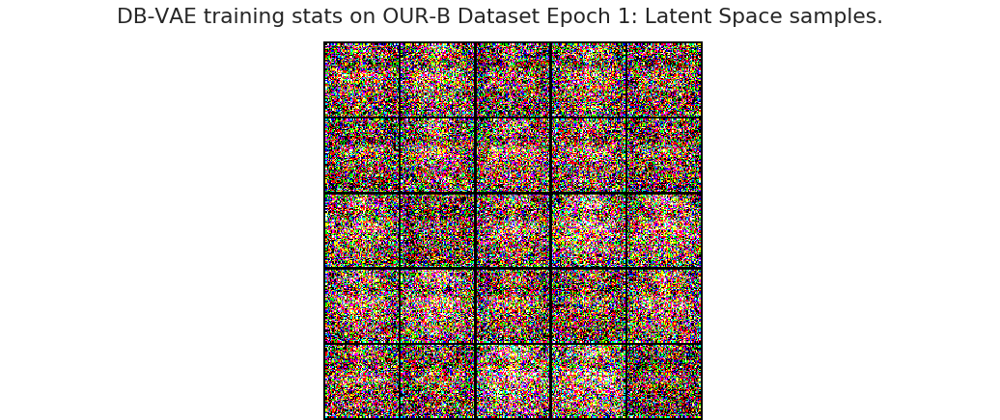

<IPython.core.display.Javascript object>


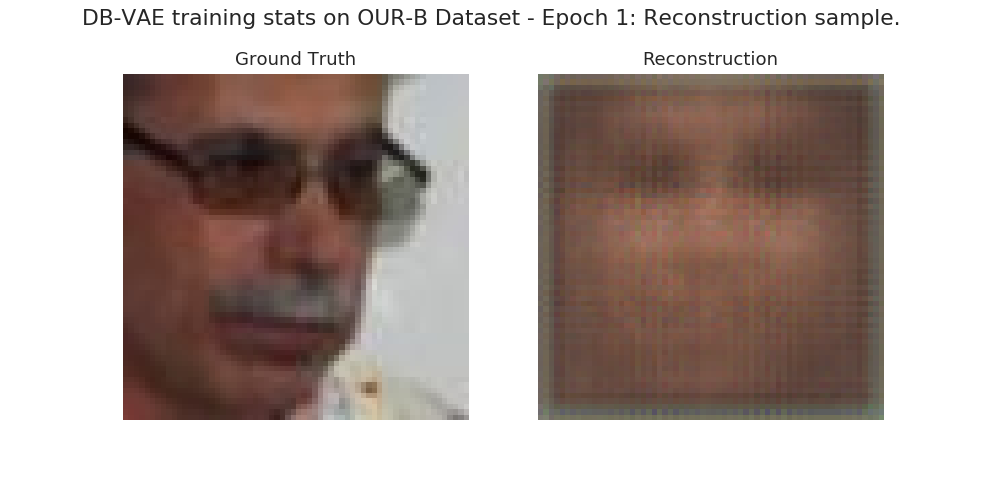



 Epoch 02/10:
   mean accuracy   train/val = 96.13%   / 96.53% 
   mean train loss train/val = 1.18e+00 / 1.15e+00 
   mean class loss train/val = 2.08e-02 / 1.89e-02 
   mean KL loss    train/val = 3.20e-02 / 2.59e-02 
   mean recon loss train/val = 1.13e+00 / 1.10e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


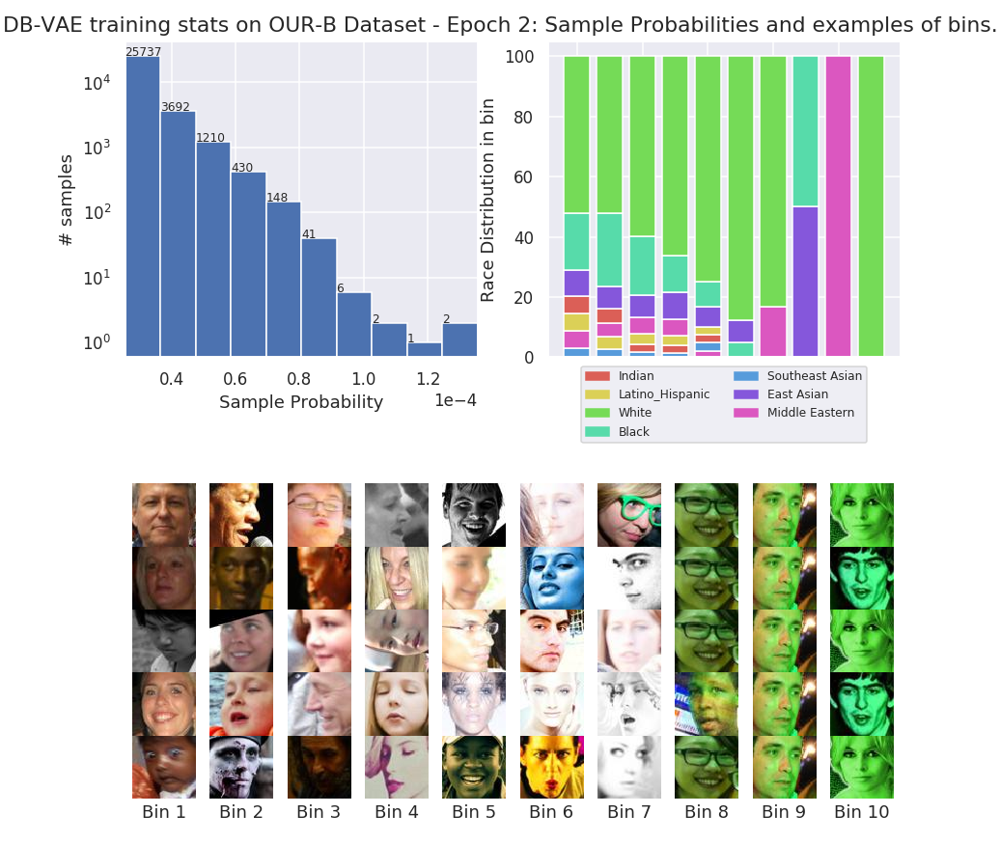

<IPython.core.display.Javascript object>


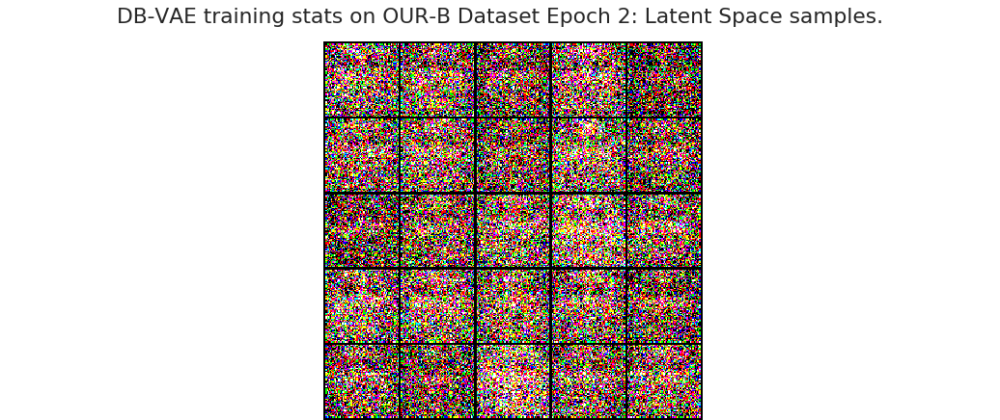

<IPython.core.display.Javascript object>


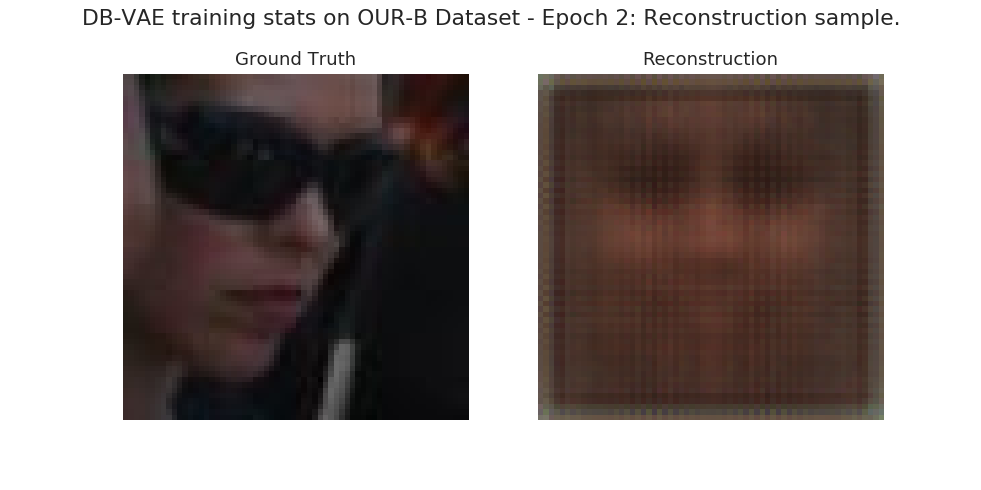



 Epoch 03/10:
   mean accuracy   train/val = 97.52%   / 97.32% 
   mean train loss train/val = 1.14e+00 / 1.12e+00 
   mean class loss train/val = 1.36e-02 / 1.43e-02 
   mean KL loss    train/val = 3.34e-02 / 2.52e-02 
   mean recon loss train/val = 1.09e+00 / 1.08e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


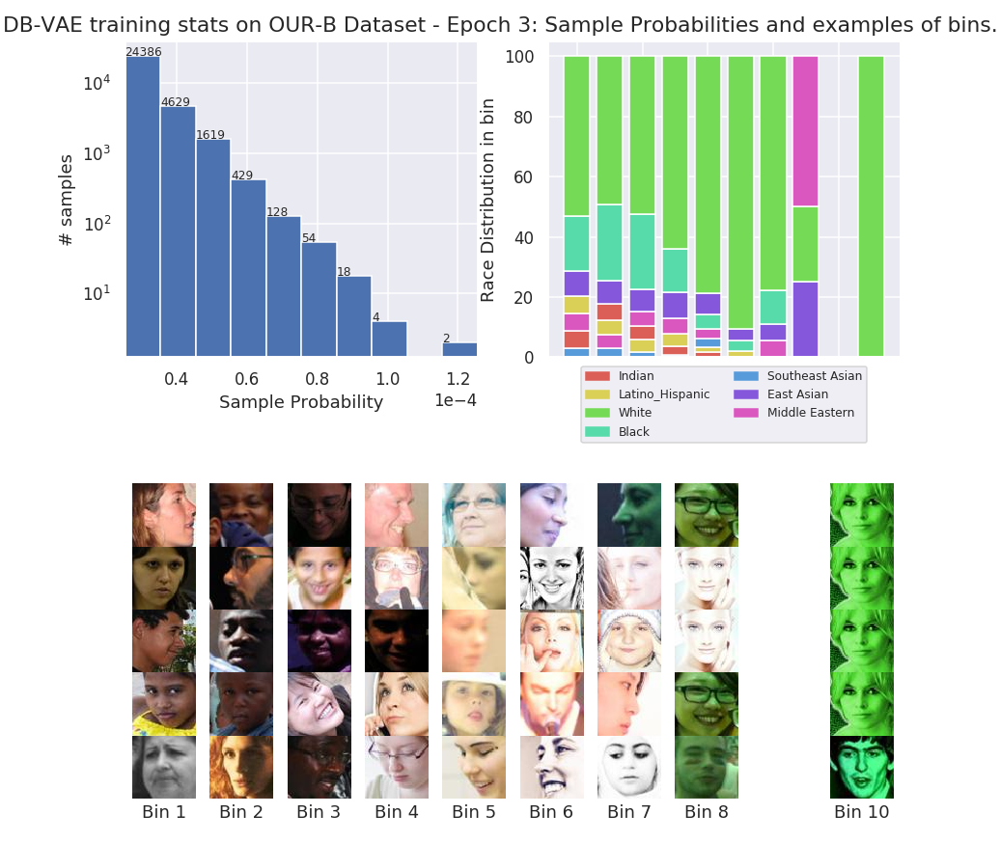

<IPython.core.display.Javascript object>


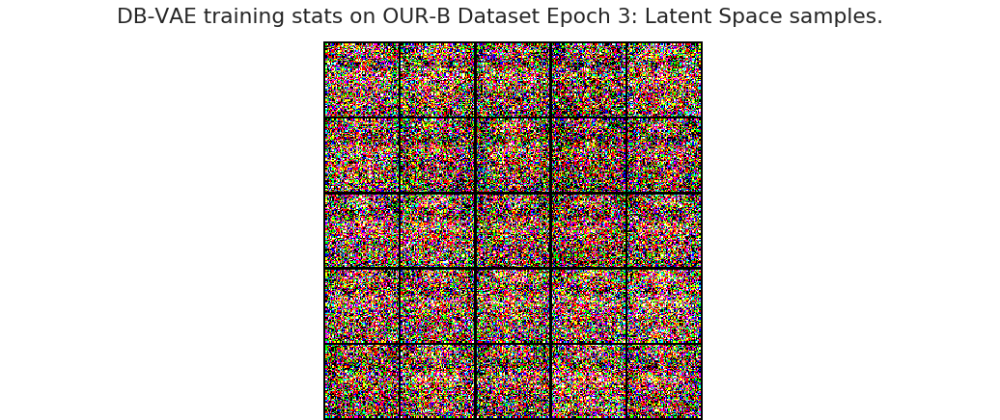

<IPython.core.display.Javascript object>


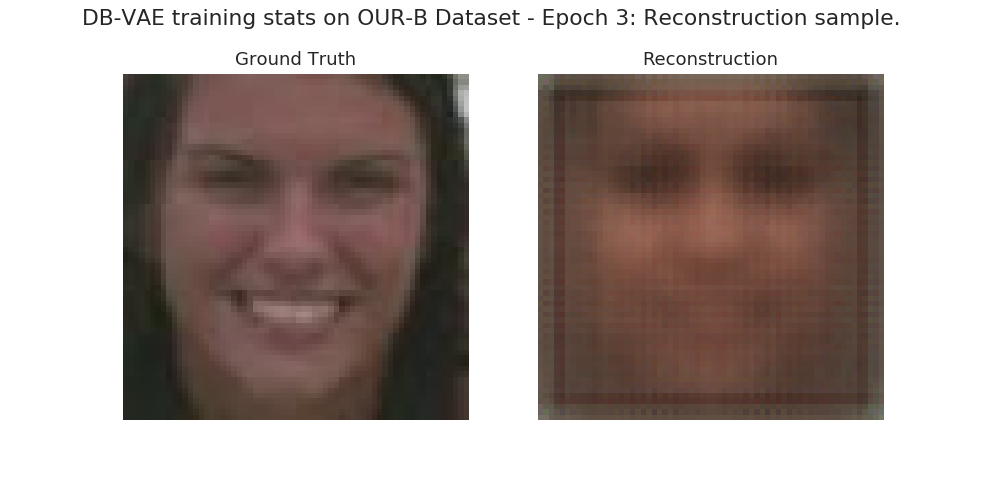



 Epoch 04/10:
   mean accuracy   train/val = 98.19%   / 97.72% 
   mean train loss train/val = 1.12e+00 / 1.11e+00 
   mean class loss train/val = 1.01e-02 / 1.23e-02 
   mean KL loss    train/val = 3.31e-02 / 2.48e-02 
   mean recon loss train/val = 1.08e+00 / 1.07e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


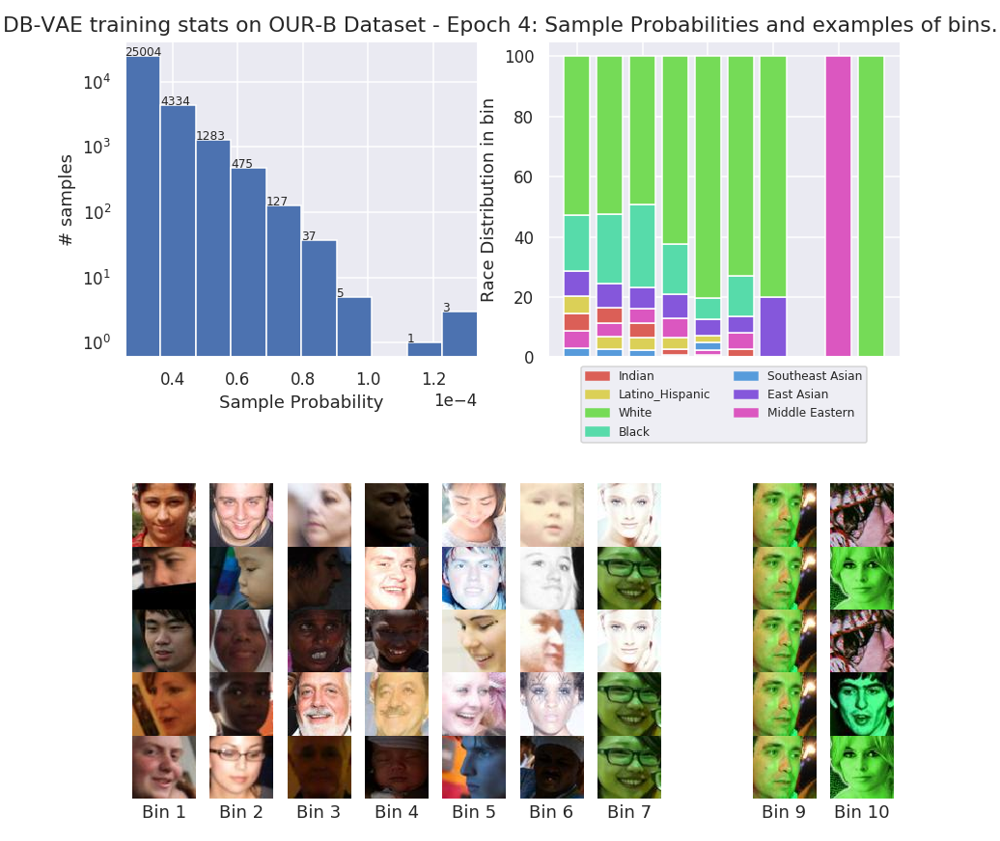

<IPython.core.display.Javascript object>


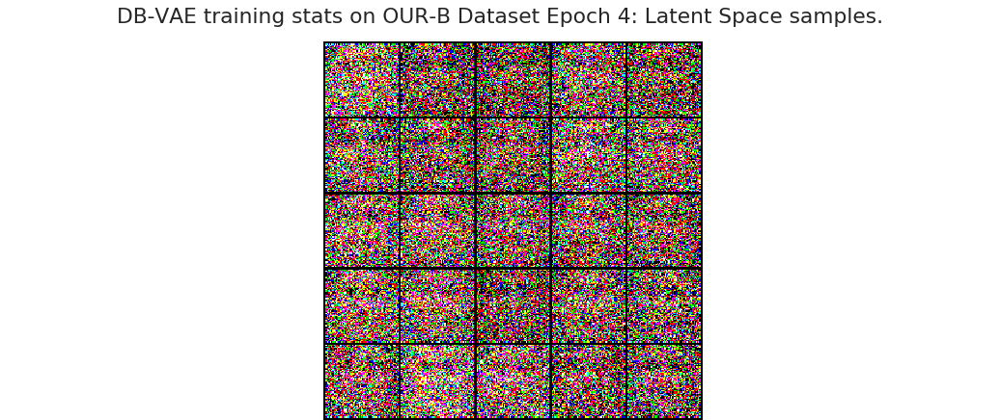

<IPython.core.display.Javascript object>


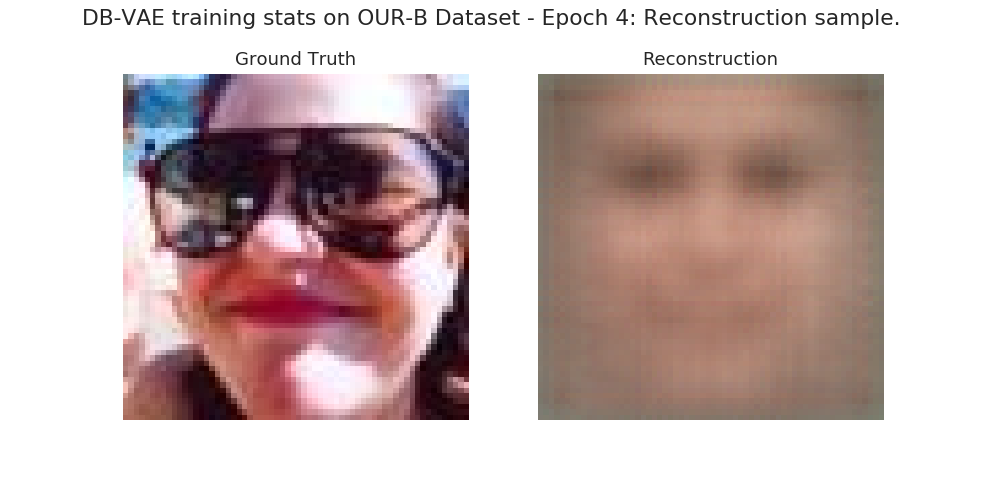



 Epoch 05/10:
   mean accuracy   train/val = 98.41%   / 97.69% 
   mean train loss train/val = 1.12e+00 / 1.11e+00 
   mean class loss train/val = 8.86e-03 / 1.26e-02 
   mean KL loss    train/val = 3.33e-02 / 2.45e-02 
   mean recon loss train/val = 1.08e+00 / 1.08e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


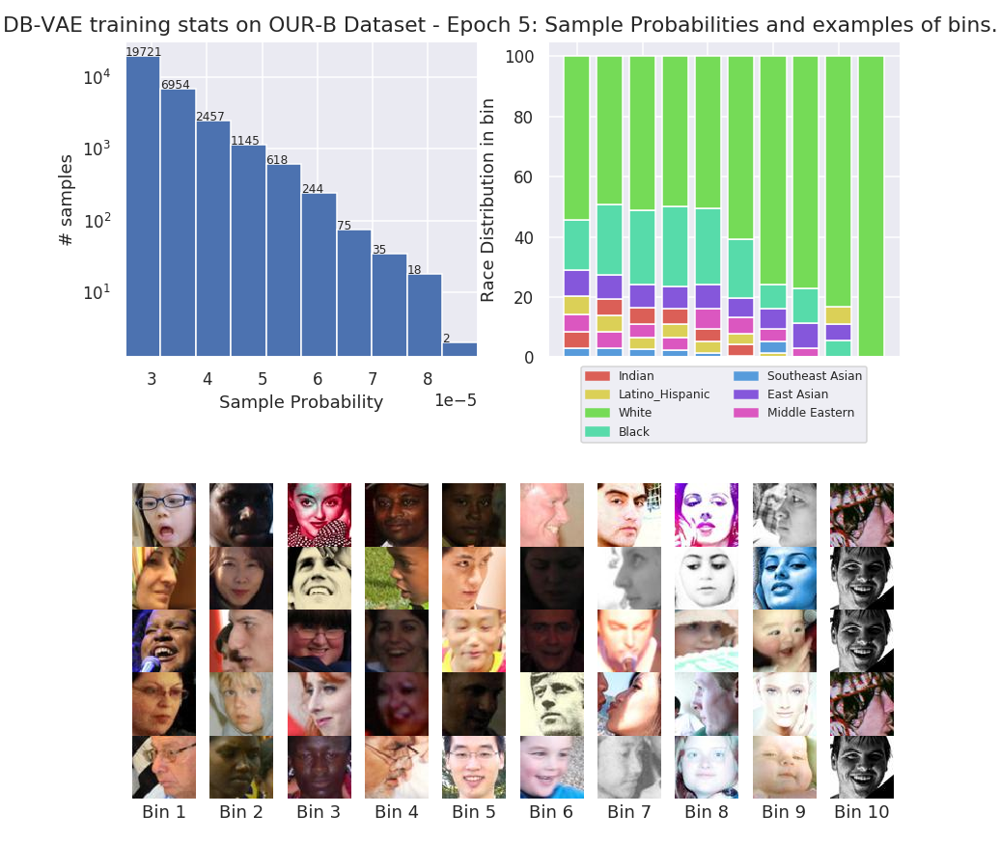

<IPython.core.display.Javascript object>


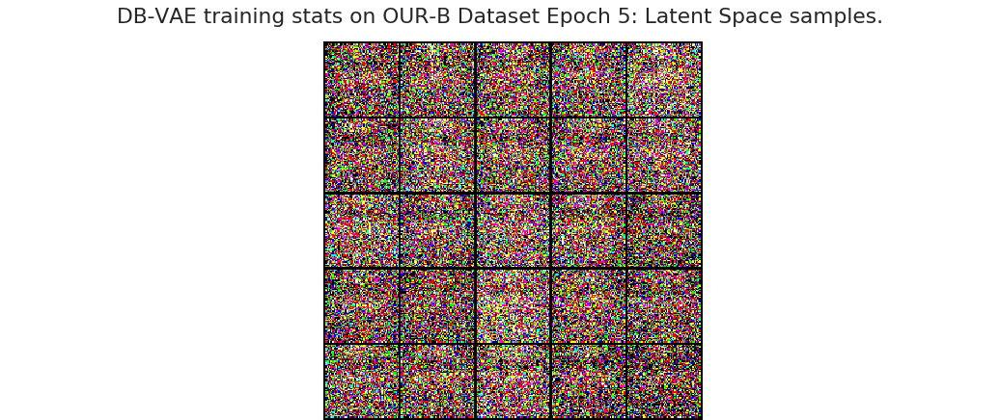

<IPython.core.display.Javascript object>


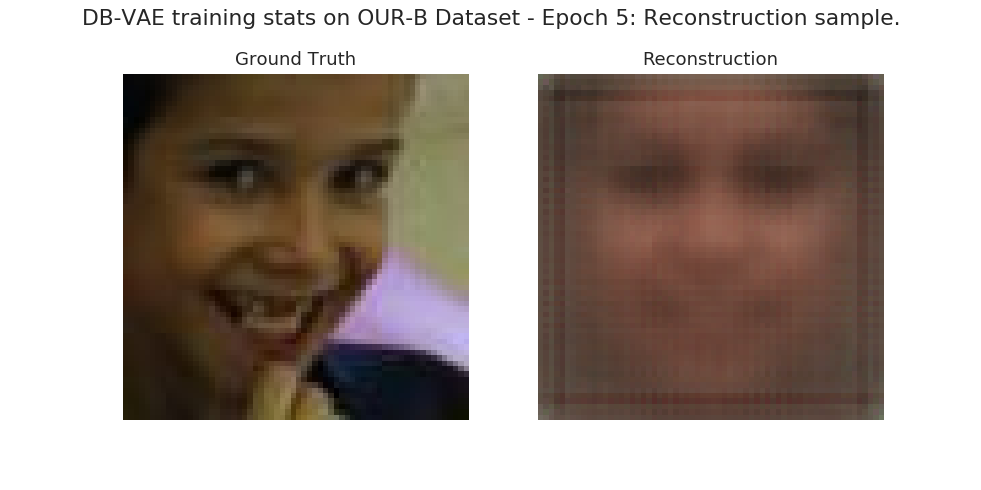



 Epoch 06/10:
   mean accuracy   train/val = 98.66%   / 97.94% 
   mean train loss train/val = 1.11e+00 / 1.11e+00 
   mean class loss train/val = 7.68e-03 / 1.18e-02 
   mean KL loss    train/val = 3.57e-02 / 2.84e-02 
   mean recon loss train/val = 1.06e+00 / 1.07e+00 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


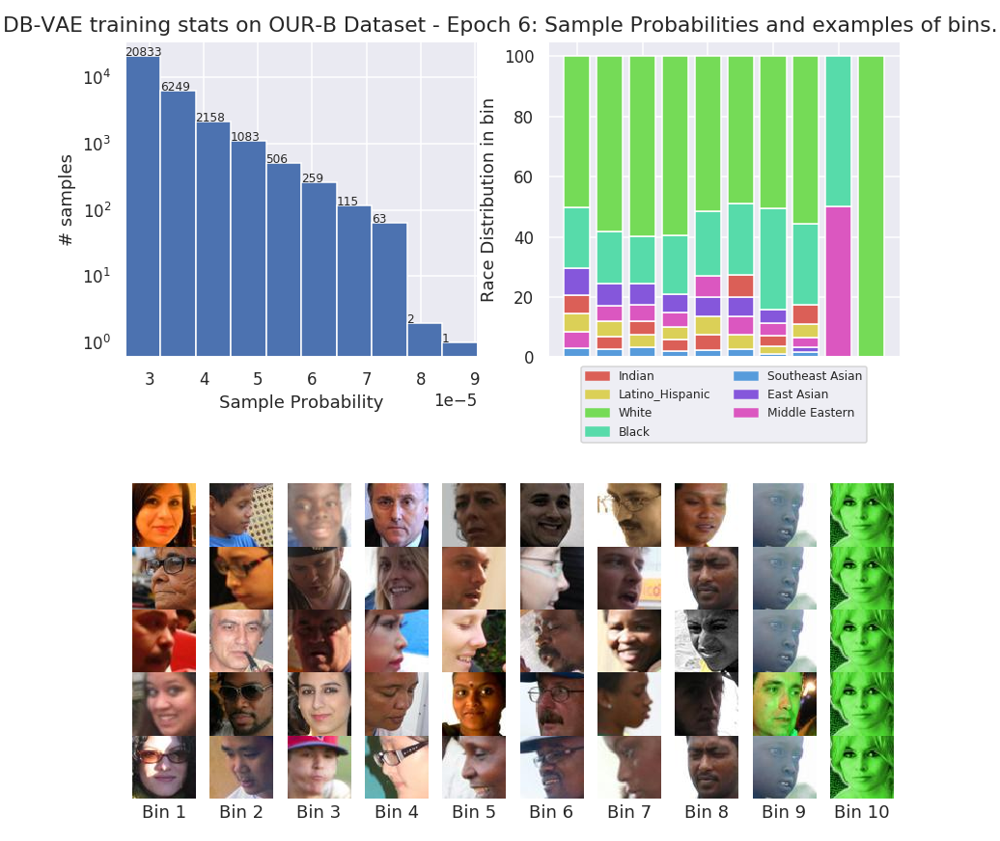

<IPython.core.display.Javascript object>


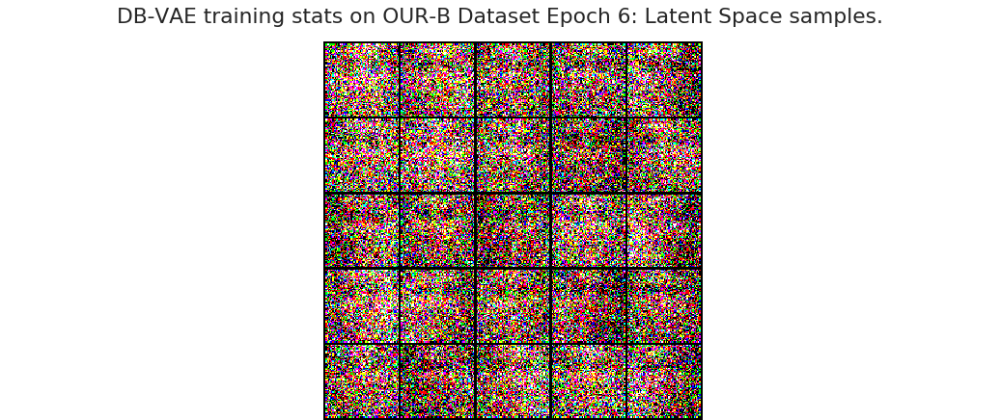

<IPython.core.display.Javascript object>


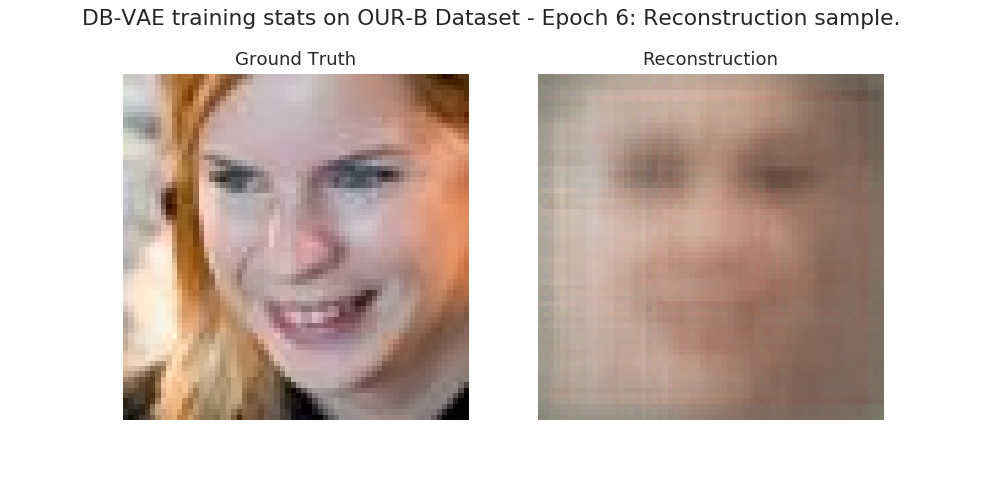



 Epoch 07/10:
   mean accuracy   train/val = 98.90%   / 98.05% 
   mean train loss train/val = 1.06e+00 / 1.05e+00 
   mean class loss train/val = 6.37e-03 / 1.14e-02 
   mean KL loss    train/val = 5.33e-02 / 4.69e-02 
   mean recon loss train/val = 1.00e+00 / 9.95e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


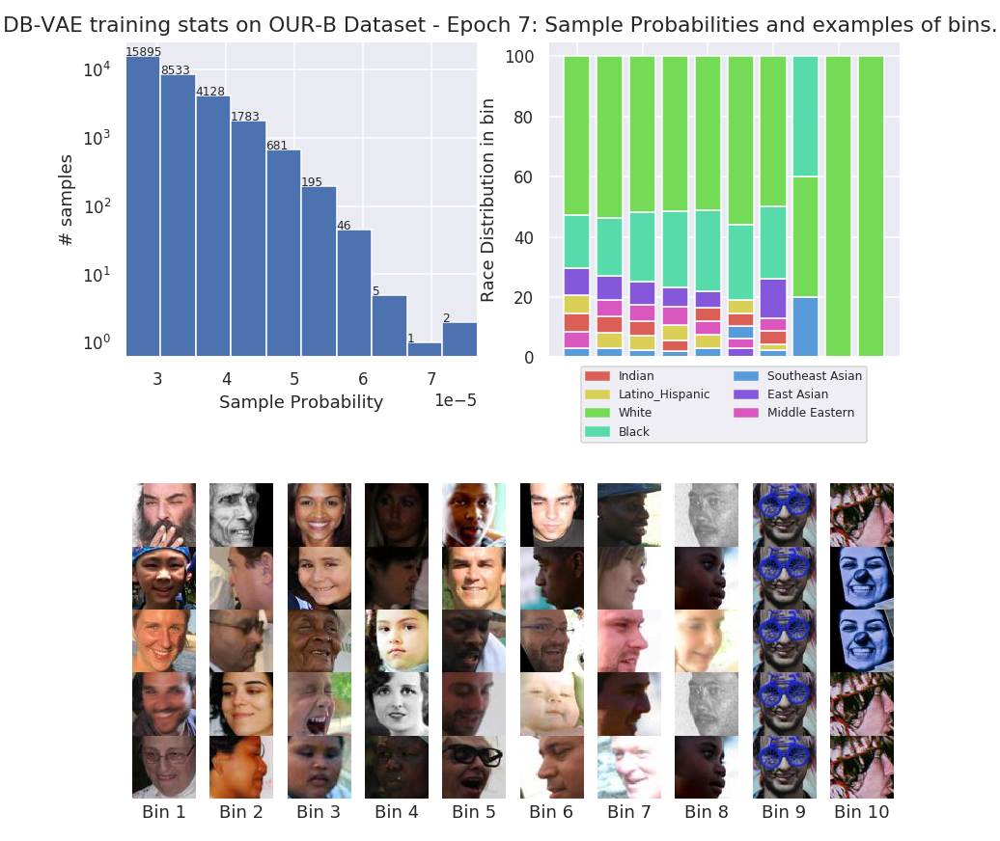

<IPython.core.display.Javascript object>


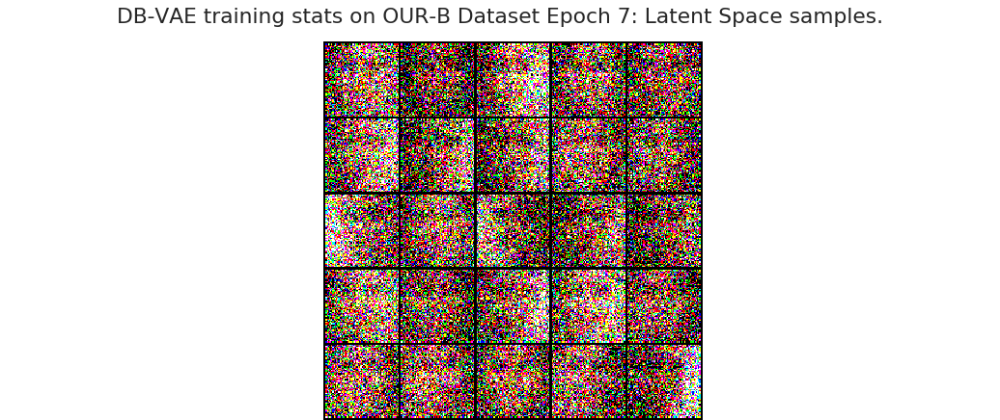

<IPython.core.display.Javascript object>


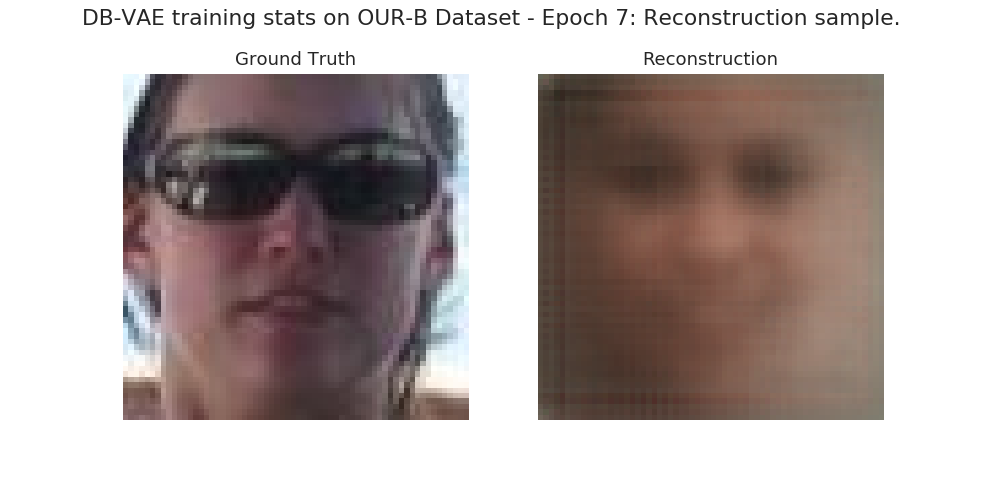



 Epoch 08/10:
   mean accuracy   train/val = 98.85%   / 98.04% 
   mean train loss train/val = 1.03e+00 / 1.03e+00 
   mean class loss train/val = 6.45e-03 / 1.15e-02 
   mean KL loss    train/val = 6.44e-02 / 5.62e-02 
   mean recon loss train/val = 9.64e-01 / 9.57e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


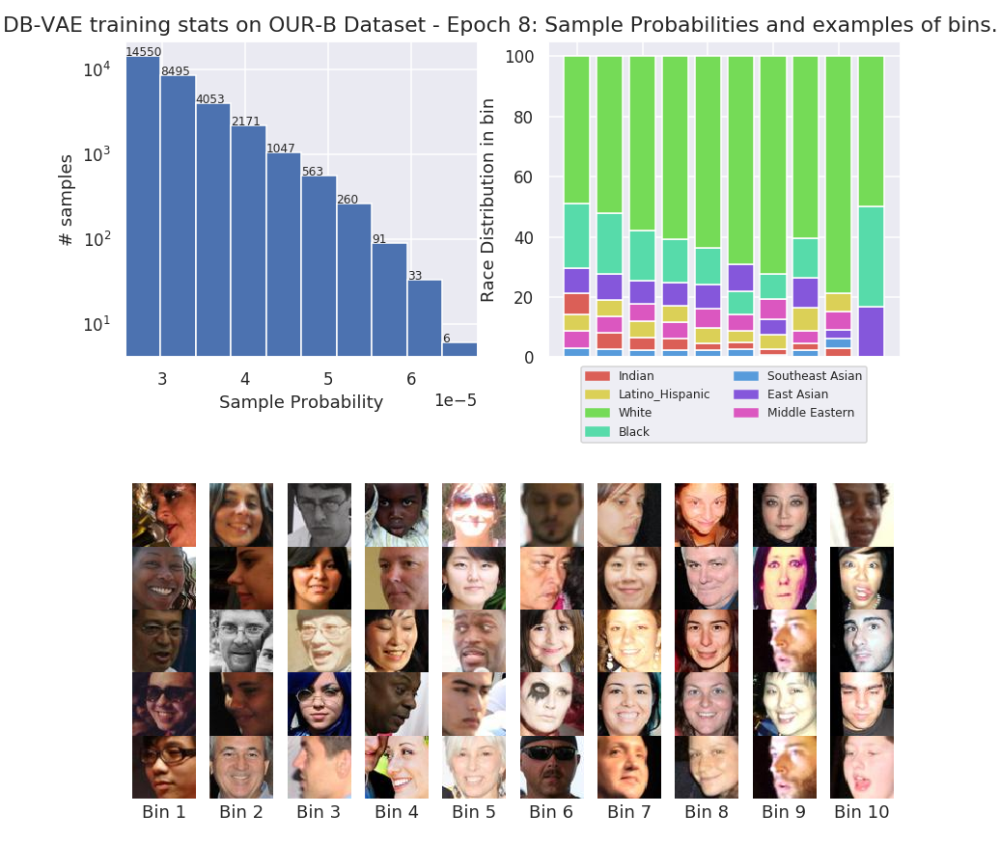

<IPython.core.display.Javascript object>


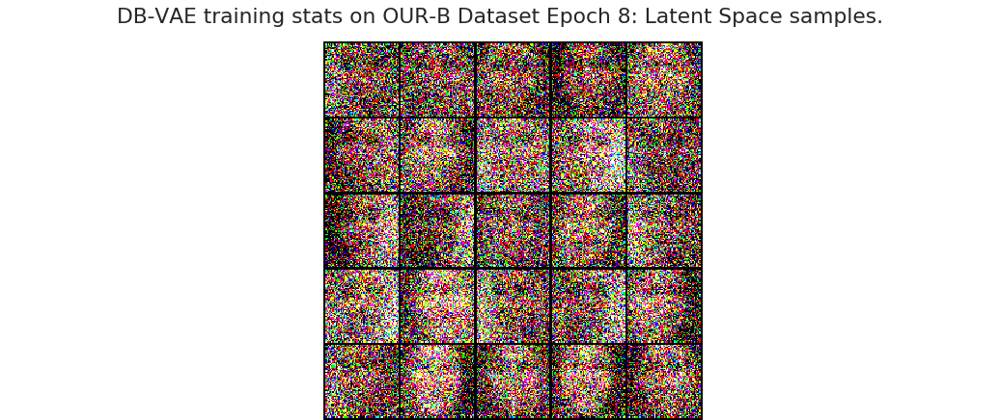

<IPython.core.display.Javascript object>


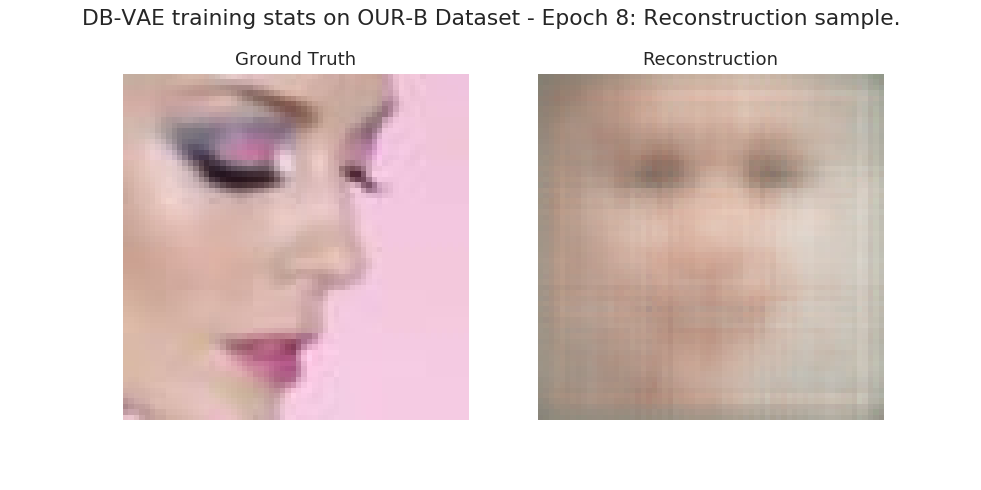



 Epoch 09/10:
   mean accuracy   train/val = 99.15%   / 98.23% 
   mean train loss train/val = 1.01e+00 / 1.00e+00 
   mean class loss train/val = 4.92e-03 / 1.04e-02 
   mean KL loss    train/val = 6.83e-02 / 6.13e-02 
   mean recon loss train/val = 9.36e-01 / 9.30e-01 
Recomputing debiasing sample probabilities..


<IPython.core.display.Javascript object>


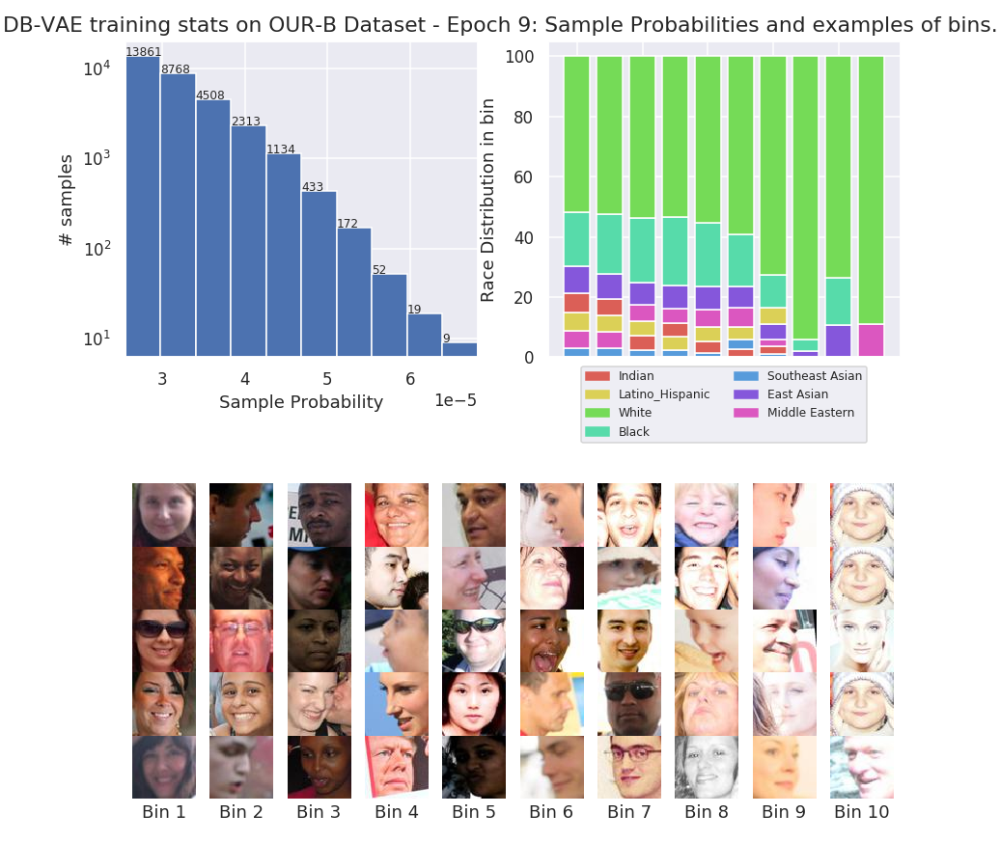

<IPython.core.display.Javascript object>


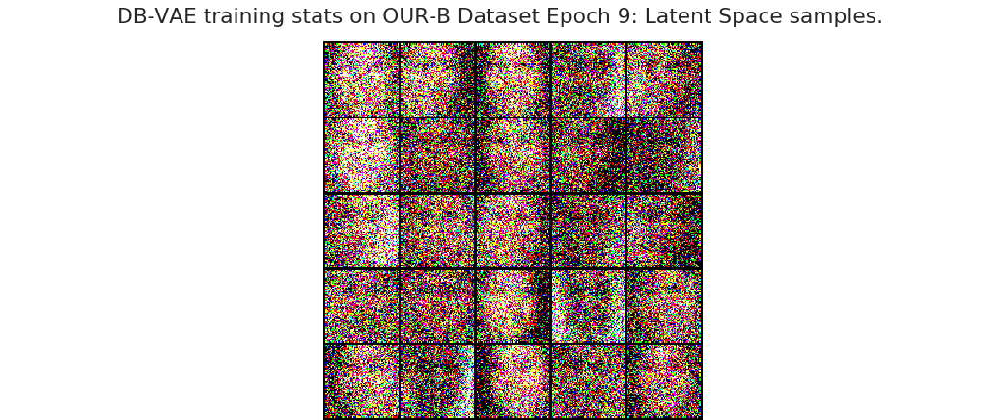

<IPython.core.display.Javascript object>


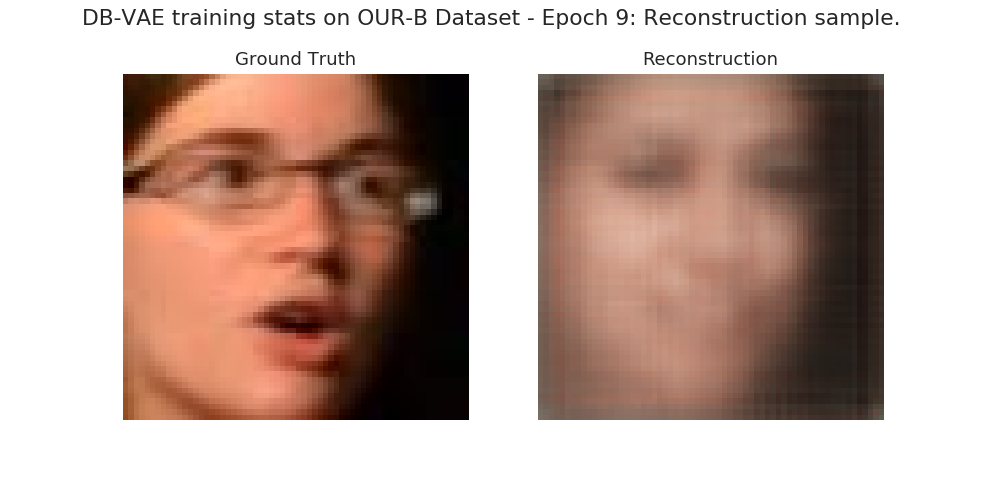



 Epoch 10/10:
   mean accuracy   train/val = 99.12%   / 98.24% 
   mean train loss train/val = 9.91e-01 / 9.84e-01 
   mean class loss train/val = 5.21e-03 / 1.07e-02 
   mean KL loss    train/val = 6.43e-02 / 5.64e-02 
   mean recon loss train/val = 9.21e-01 / 9.17e-01 

Computing final debiasing sample probabilities..


In [28]:
# Construct the end to end vae
our_biased_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                                 kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
our_biased_db_vae = our_biased_db_vae.to(our_biased_db_vae.device)

# Train the VAE
our_biased_db_vae_train_stats = our_biased_db_vae.run_training(batch_size=128, num_epochs=10,
                                                               train_dataset=our_biased_train_loader,
                                                               enable_debiasing=True, smoothing_fac=0.005,
                                                               title='DB-VAE training stats on OUR-B Dataset',
                                                               validation_dataset=our_val_loader)

# Saving the model
# util.save_model(our_biased_db_vae, "OUR-B_standard_vae")

The model can be loaded using a pretrained state weights by running the next cell

In [ ]:
# Construct the end to end vae
our_biased_db_vae = db_vae.DbVae(latent_dim=128, img_dim=(3,64,64), num_classes=1,
                          kl_weight=0.05, reconstruction_weight=0.1, classification_weight=0.2)
our_biased_db_vae = our_biased_db_vae.to(our_biased_db_vae.device)

# Load model from file
our_biased_db_vae.load_state_dict(torch.load("OUR-B_standard_vae.pt",  map_location=our_biased_db_vae.device))

### Bias-evaluation on PPB

Next, let's evaluate the classification performance of our DB-VAE on the PPB dataset.
For the PPB data, we'll look at the classification accuracy across four different demographics
defined: dark-skinned male (DM), dark-skinned female (DF), light-skinned male (LM), and light-skinned female (LF).

Evaluate standard model on lighter skin male subjects:



    Accuracy lighter male: 1.00
Evaluate standard model on lighter skin female subjects:



    Accuracy lighter female: 0.99
Evaluate standard model on darker skin male subjects:



    Accuracy darker male: 0.91
Evaluate standard model on darker skin female subjects:



    Accuracy darker female: 0.94


<IPython.core.display.Javascript object>


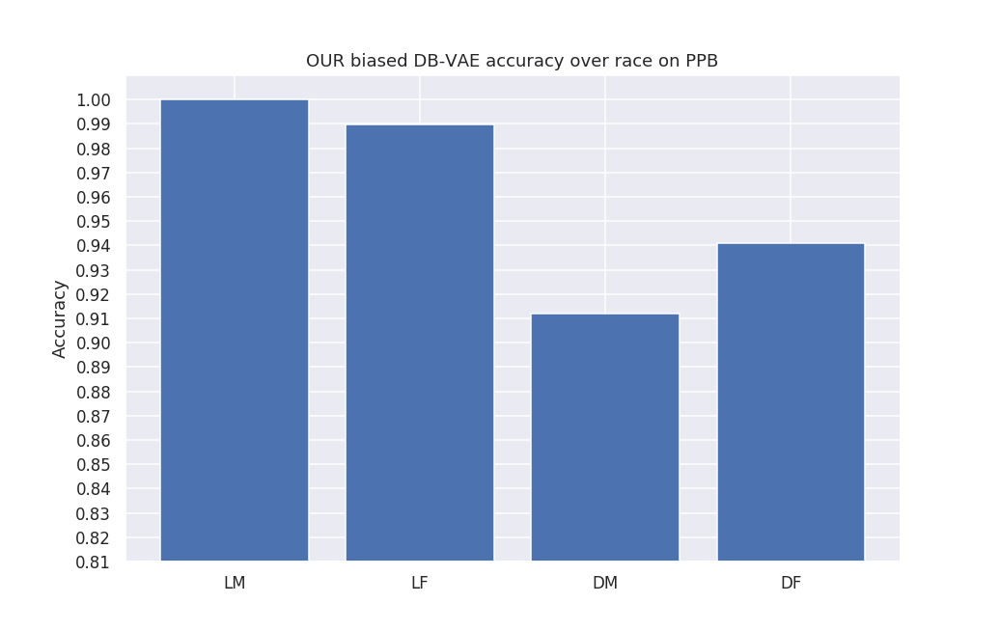

In [29]:
our_biased_db_vae_ppb_bias_stats = util.evaluate_on_ppb(model=our_biased_db_vae.encoder,
                                                        test_loader=ppb_test_loader,
                                                        title='OUR biased DB-VAE accuracy over race on PPB',
                                                        output_index=0)

### Bias-evaluation on OUR Dataset

Next, let's evaluate the classification performance of the DB-VAE on the OUR dataset. Here we will first look at gender and race independently.

<IPython.core.display.Javascript object>


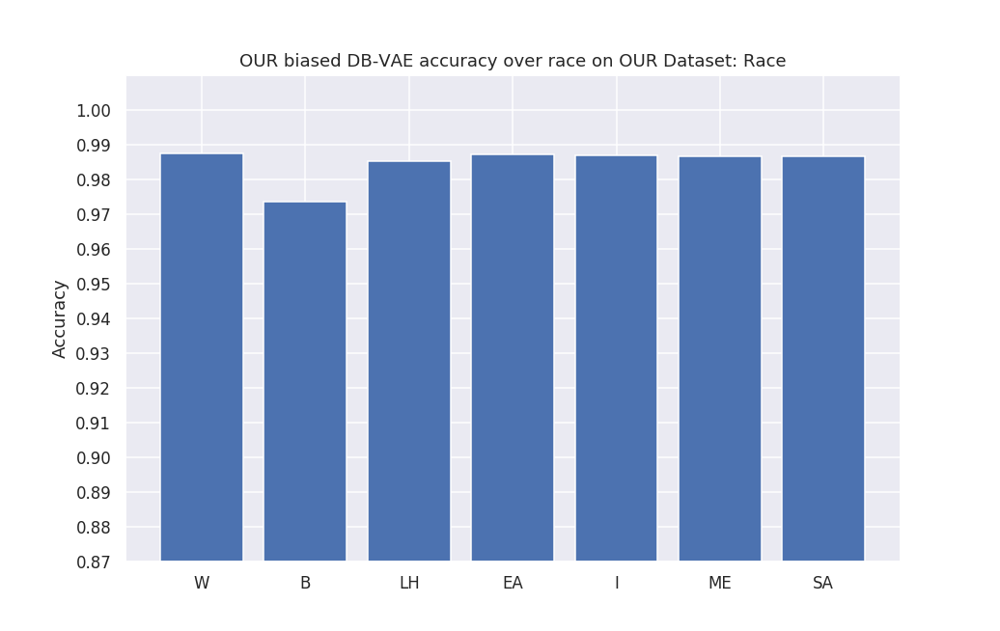

<IPython.core.display.Javascript object>


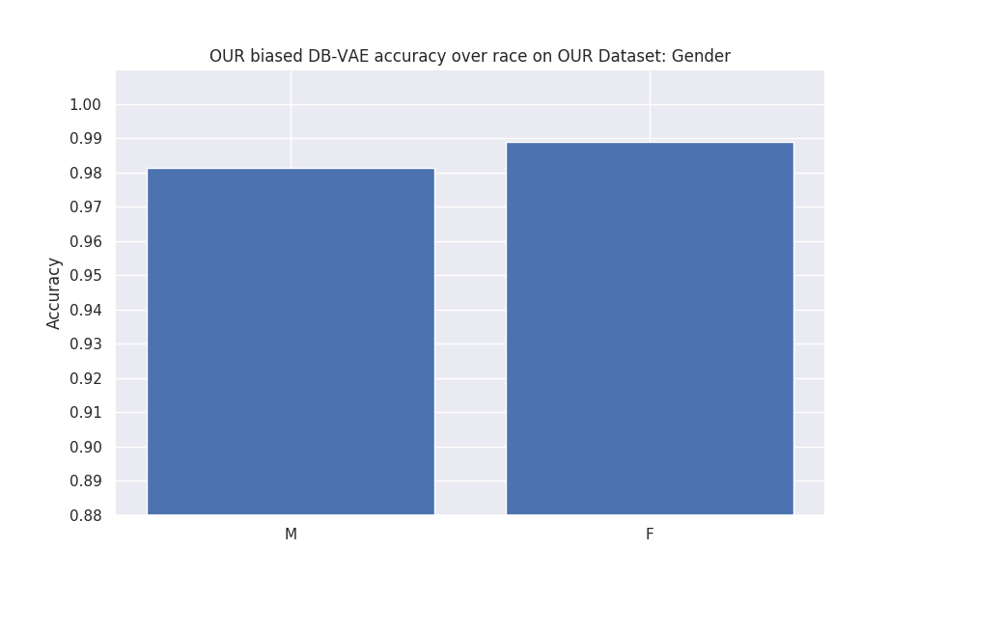

<IPython.core.display.Javascript object>


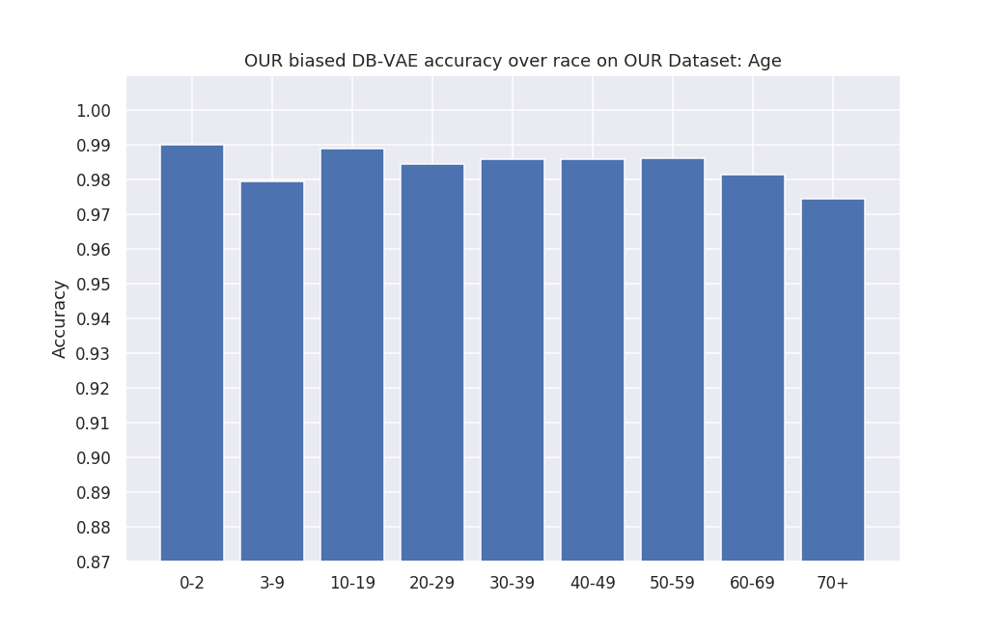

In [30]:
our_biased_db_vae_our_bias_stats = util.get_bias_stats_on_our_dataset(model=our_biased_db_vae.encoder,
                                                                test_loader=our_val_loader,
                                                                title='OUR biased DB-VAE accuracy over race on OUR Dataset',
                                                                output_index=0)



## 3.4 Barplot comparing bias evaluations

<IPython.core.display.Javascript object>


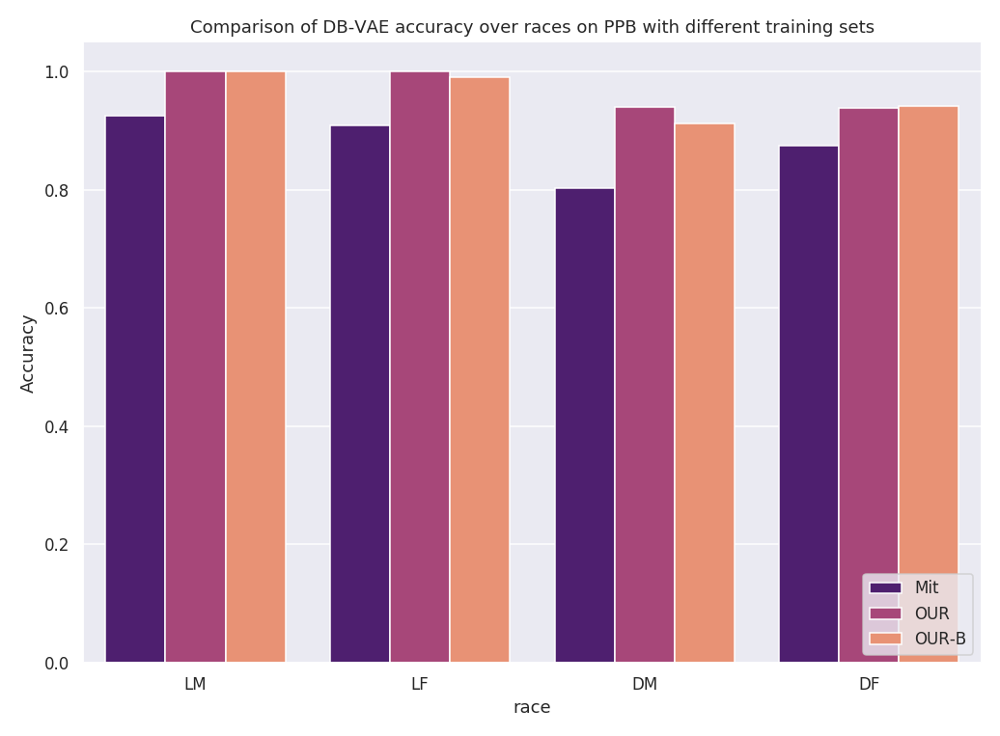

<IPython.core.display.Javascript object>


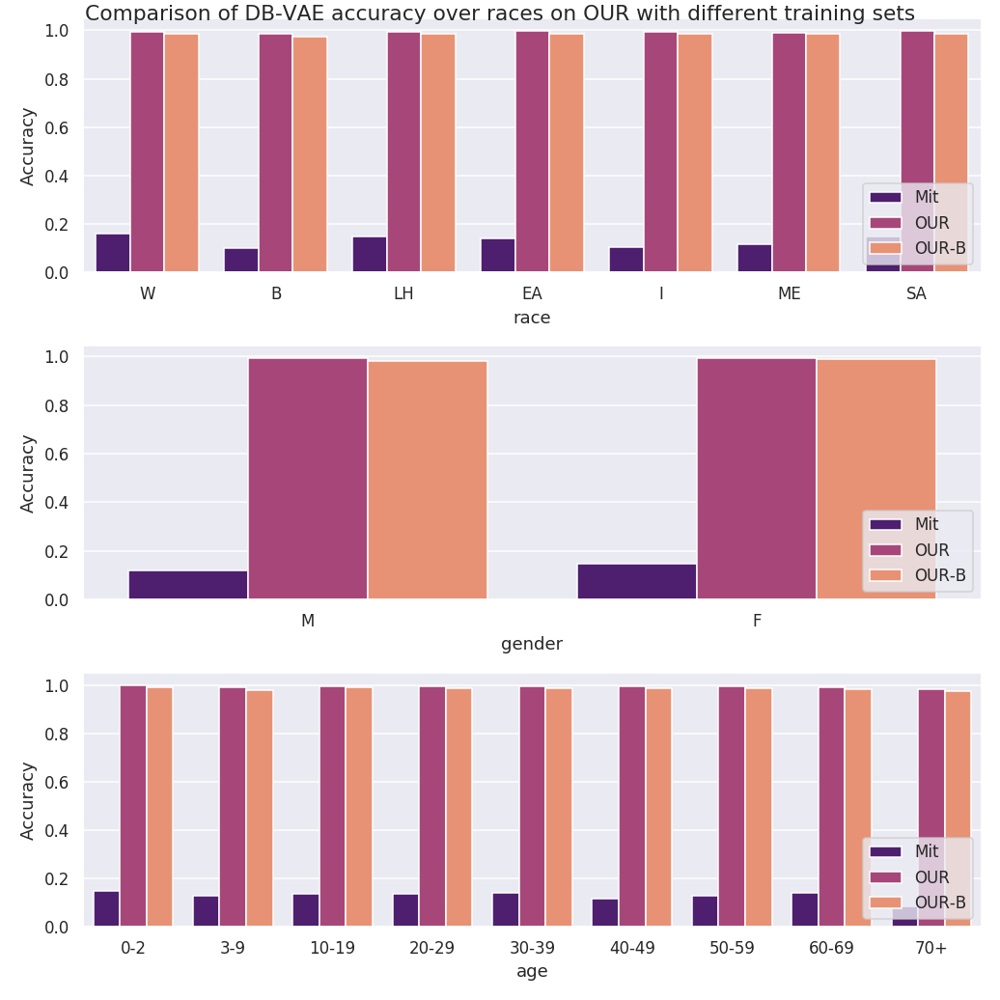

In [31]:
stats_util.barplot_compare_ppb(mit_db_vae_ppb_bias_stats,
                               our_db_vae_ppb_bias_stats,
                               our_biased_db_vae_ppb_bias_stats,
                               title="Comparison of DB-VAE accuracy over races on PPB with different training sets")

stats_util.barplot_compare_our(mit_db_vae_our_bias_stats,
                               our_db_vae_our_bias_stats,
                               our_biased_db_vae_our_bias_stats,
                               title="Comparison of DB-VAE accuracy over races on OUR with different training sets")

# 4. Results

If *all* of the models in this notebook have been run already, the next cell can be used to produce plots that aggregate the results of all models over all evaluation sets. 


/home/frederic/FACT-AI/stats_util.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.mit_stats['alpha'][self.mit_stats['alpha'] == "\u03b1 = VAE"] = 'VAE'
/home/frederic/FACT-AI/stats_util.py:689: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.our_stats['alpha'][self.our_stats['alpha'] == "\u03b1 = VAE"] = 'VAE'
/home/frederic/FACT-AI/stats_util.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.our_biased_stats['alpha

<IPython.core.display.Javascript object>


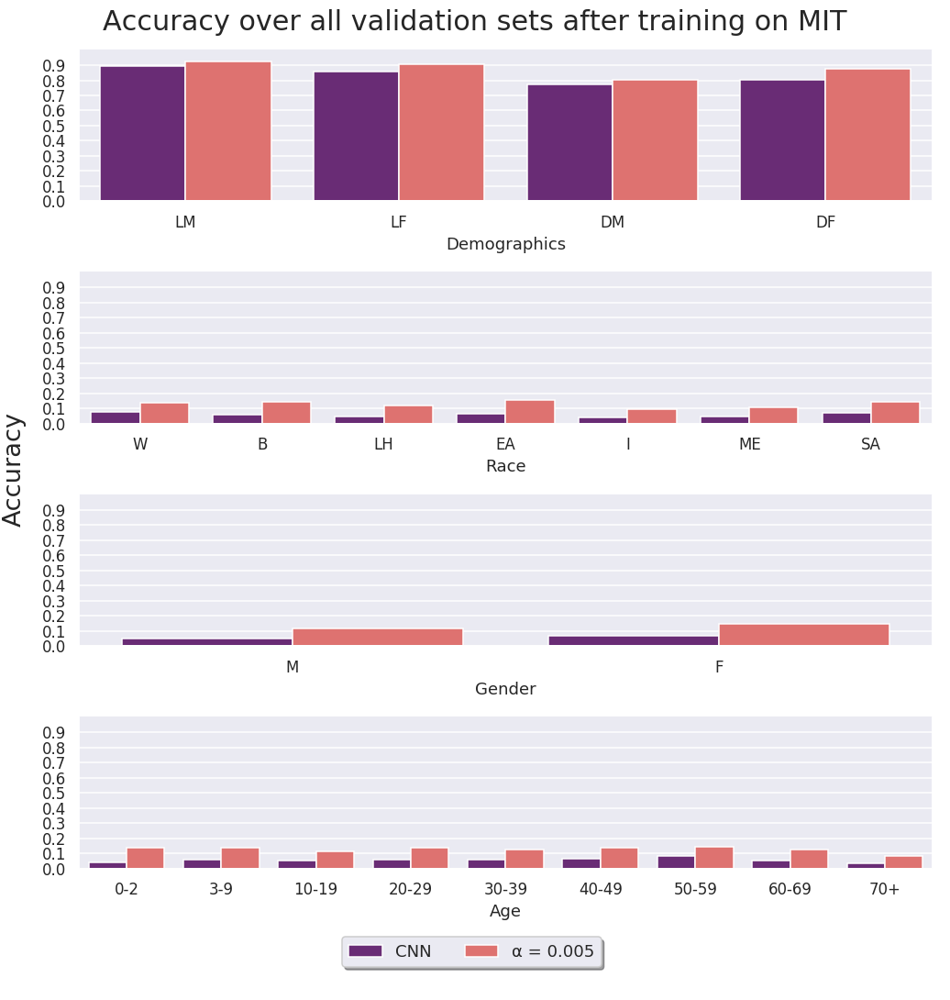

<IPython.core.display.Javascript object>


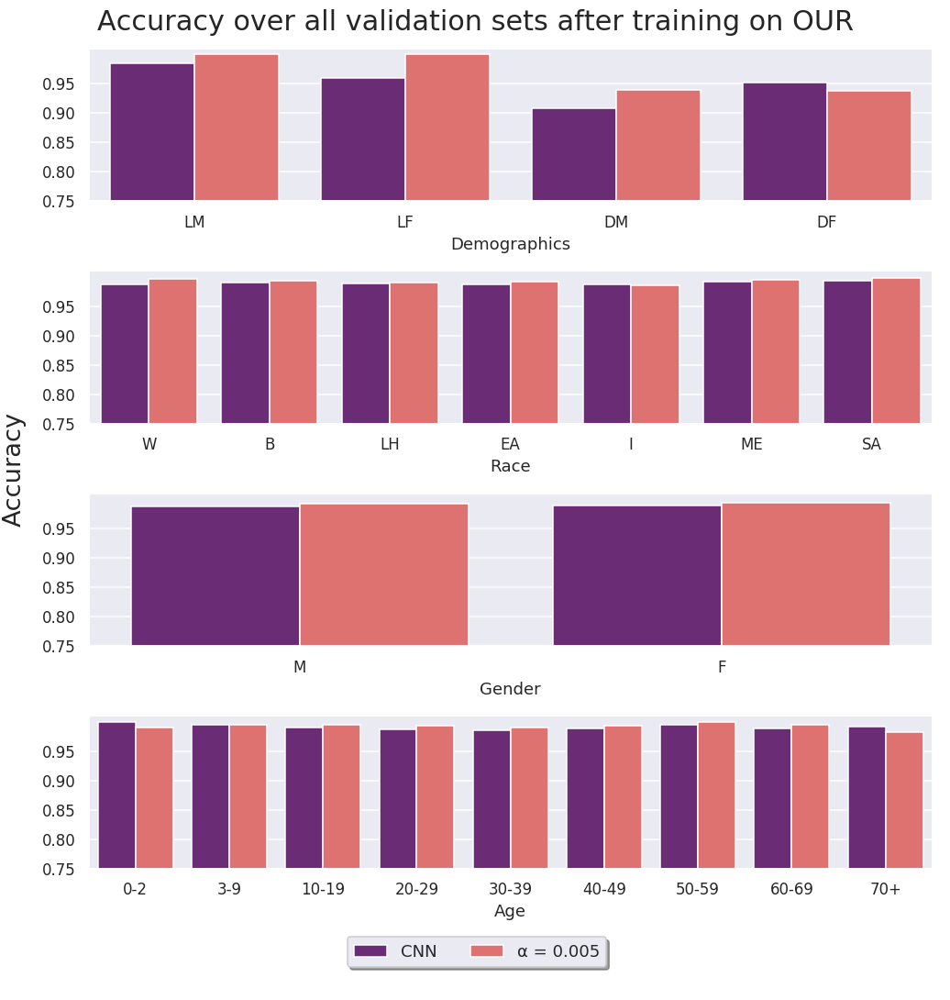

<IPython.core.display.Javascript object>


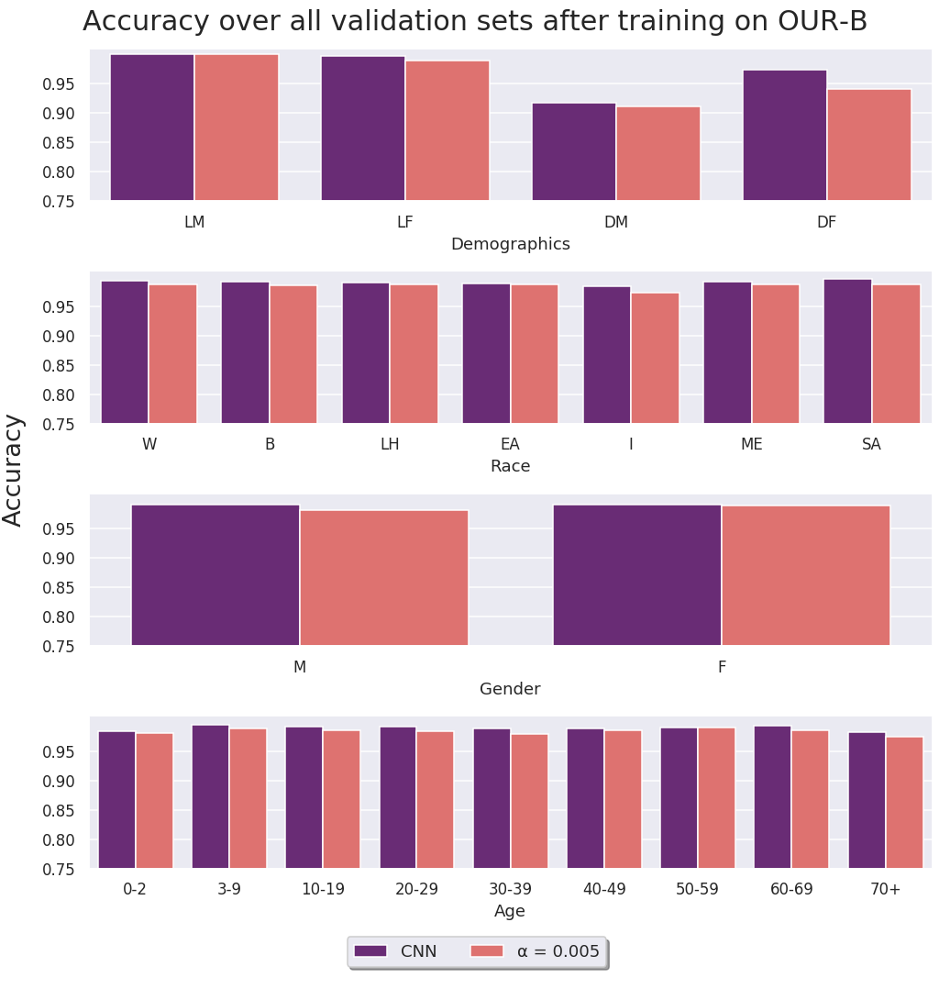

In [34]:
# init stats instance
stats = stats_util.Stats()

# prepare all CNN outputs for passing it to stats
cnn_results = (mit_standard_classifier_train_stats,
               mit_standard_classifier_ppb_bias_stats,
               mit_standard_classifier_our_bias_stats,
               our_standard_classifier_train_stats,
               our_standard_classifier_ppb_bias_stats,
               our_standard_classifier_our_bias_stats,
               our_biased_standard_classifier_train_stats,
               our_biased_standard_classifier_ppb_bias_stats,
               our_biased_standard_classifier_our_bias_stats)

# pass CNN results to stats
stats.add_row(single_run_stats=cnn_results, model='cnn')

# prepare all VAE outputs for passing it to stats
vae_results = (mit_db_vae_train_stats,
               mit_db_vae_ppb_bias_stats,
               mit_db_vae_our_bias_stats, 
               our_db_vae_train_stats,
               our_db_vae_ppb_bias_stats,
               our_db_vae_our_bias_stats,
               our_biased_db_vae_train_stats, 
               our_biased_db_vae_ppb_bias_stats,
               our_biased_db_vae_our_bias_stats)

# pass VAE results to stats
stats.add_row(single_run_stats=vae_results, model='vae', alpha=0.005)

# cosmetic changes for plotting
stats.format_alpha_for_plot()

# plot summary of results 
stats.plot_results(plot_to_disk=False, crop_MIT=False)

Below we include the same summary plots visualizing the results of our final experiment runs. Here, every model was trained from scratch five times for ten epochs each on each training set.

## 4.1 MIT Training Data


<img src="images_jupyter_notebook/summaryplot_MIT.png">

The figure above shows the classification accuracies for each of the label categories provided by the PPB evaluation set after training the models on the MIT dataset. DB-VAE models with sufficiently small values of alpha (strong debiasing) show a slight increase in classification accuracy in the minority label classes dark male and dark female compared to CNN, non-debiasing VAE, and DB-VAE employing larger alpha. Those findings signal that a correctly parametrized DB-VAE indeed aids classification accuracy in underrepresented feature space regions, although the present results are less clear than previously reported by Amini et al. Moreover, and especially for the underrepresented classes, the large variance in classification performance indicates that the performance trends should be interpreted with caution. Compared to previous research the classification accuracies within a subclass, i.e. for different levels of debiasing, show stronger fluctuations and follow a pattern that lacks an intuitive explanation. Again, due to high variance we cannot rule out that those fluctuations represent noise rather than a difference signal. Finally, the images in the OUR dataset show significantly more variation in position, lighting and background, therefore poor generalizability from MIT images to OUR images is not surprising.

## 4.2 OUR Training Data


Before training our models on the artificially biased dataset we assessed classification performance for all models on the unbiased OUR dataset. The results confirmed that the OUR dataset is effectively free of bias in both labelled sensitive features as well in potential hidden features not accounted for during dataset creation. All (DB)-VAE models and the CNN yielded similar accuracies over all subclass labels

<img src="images_jupyter_notebook/summaryplot_OUR.png">

## 4.3 OUR-B Training Data

<img src="images_jupyter_notebook/summaryplot_OUR-B.png">

Finally, the last figure shows model performance after training on OUR-B and evaluated on PPB and OUR validation sets. Interestingly, simulating the bias characteristics of the MIT dataset did not yield lower classification accuracies for minority classes like DM or DF for the CNN, nor for the non-debiasing VAE. More even, those models rather improved, displaying slightly increased accuracy after trained on biased data compared to very similar, unbiased data. Because those improvements on biased training sets reflect changes in average scores over five trials however cannot draw a definite conclusion over the significance of this effect. 

# 5. Discussion and Conclusion


Two main purposes were pursued in the present work. We tested the reproducibility of the results of Amini et al. by exact replica as well as the generalizability of their findings to other image sets by imposing the bias characteristics of the initial dataset onto another, more versatile dataset.

We were only partially able to reproduce the results of Amini et al. The present results do indicate a tendency of well-parametrized models to surpass non-debiasing models in terms of classification performance of underrepresented subclasses, this effect is however not as decisive as reported initially and high variance between trials undermines the conclusiveness of the observed trends. Furthermore the present resampling methods failed to show consistent oversampling of underrepresented images with regard to sensitive features as described by the datasets. Nonetheless visualizations indicated that the latent feature space was explored more evenly by DB-VAE models, albeit not dominantly towards the sensitive features considered relevant. Our results illustrate that the theoretical construct of the DB-VAE is sensible and has the potential to produce the expected results. Yet it has shown to be sensitive to the bias characteristics of the data, which often are difficult to capture due to either absent labelling of the biased feature or simply because of bias inherent to features that lack semantic information.

Determining the exact cause of the differences between the original and this study is non-trivial and many factors, including small implementation differences in the loss function, resampling probability computation or backpropagation blocking, might contribute. Another factor that is likely to confound the results of PPB accuracy is the sliding window approach applied by Amini et al. Classifying an image as a face if one of the many window position identifies a face is likely to induce many false positives due to sheer increase in amount of images fed through the classifier. Test sets such as PPB that do not contain negative examples will not detect such false positives, but result in overestimation of facial detection performance by an uncertain amount. This emphasizes not only the importance of adequate training-, validation- and test set design but also the need for datasets that suit the purpose of bias related research topics. 

   
The present work illustrates that the proposed DB-VAE structure introduced by Amini et al. indeed is able to both captures hidden latent features that carry semantic meaning, as well as to employ those distributions to mitigate bias in those features by adaptively resampling underrepresented feature regions. To this end, the present results confirm the originally reported findings. This model behaviour, however, failed to induce the same changes in classification performance, which we, after carefully investigating the models' inner mechanics, attribute to the discrepancy between the features learnt by the model and the data's annotated features which we consider sensitive. Exploring model modifications that minimize this discrepancy is likely to greatly contribute to research directed towards unfolding the DB-VAE's full potential. Additionally, developing tools that enable informative visualizations and general insight into the models' behaviour is required to deploy or further develop the DB-VAE appropriately.
